# ML Auto 18.ipynb

Válaszható lett.

> Itt annyit változtattam, hogy 'Action' után is visszaengedem a before after adatokat. Ennyivel bővülnek a before after adatok. Igy nem csak a mesterséges mozgatás által jut adatokhoz.

Bevezetésre került:

> Kivettem a before after linreg becslésből az Interceptet

Bevezetésre került:

> Linreg helyett MLP van a main modelben

Bevezetésre került:

> Az action kiszámolásánál az új érték is -1, 1 közé lesz normalizálva

Bevezetésre került:

> Minimum 7, Maximum 7 lépést tehet mindkét irányba

Bevezetésre került:

> pyplot save_plots függvény, ami kexportálja png-be a plottokat

Változtatásra került:

> Incremental - Online learnig. A neurális hálóban a warm_start beállítása és az iter = 1

# Jegyzet

> időnként kiplottolni azt, hogy tényleg milyen kapcsolat van a left szenzor és a középértéktől mért
távolság között.
ugyan ezt megnézni a két másik szenzorra is.
ezt egyszerűen ki kéne plottoltatnom (x=szenzor, y=középérték)

> az a furcsa, hogy a relu viszonylag jól teljesít
ennek lehet oka, hogy kevesebb iterációval is jobban tanul
lehet az oka, hogy eleve jobb becslést ad, a szélső értékeknél nem megy annyira el

# Jegyzet

Ne felejtsük el, hogy a before after linregnek nem kell normalizálnia az adatokat.
Az viszont már fontos, hogy amikor a linreg before-after adatok alapján becslést
készítünk arra, hogy mi lesz a fel-le eredménye a neurális hálóba engedve
akkor ott normalizálnunk kell a bemenetet.
ELLENŐRIZNI, hOgy meg vane?

NEM VOLT NORMALIZÁLVA, DE NORMALIZÁCIÓ UTÁN OLYAN HÜLYÉN VISELKEDETT HOGY NEM IGAZ.


# ToDo
letölteni a pythont és ott futtatni a kódot

huzzon egy nyomot a becslésre is, hogy lássam, hogy hova a faszomba becsüli az első modell
a mit is? ja igen a középtől való eltérést.

csinálni egy második modelt illetve kettőt

az egyik legyen a régi, de hagyjuk a faszba a fel-le becslést, az egész before aftert
és csak egyszerűen kössünk rá a becslésre valamilyen szabályt. Ha nagyobb mint x akkor +3

a másik verzió amit gyorsan ki kéne próbálni, hogy a linreg helyett beteszek egy mlp-t

**ToDo:**

Megnézni, hogy normalizálom-e az adatokat a neruális háló előtt, mert lehet hogy ez viszi félre a becslést.

**Gondolat:**

Nyilvánvaló, hogy egy idő után se a before after adatokra nem képes jó becslést adni
```
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.13709439]]
-------- 1 y up ->  center =  [[1.94404015]]
-------- 1 y up ->  right  =  [[1.85292015]]
```
Ezért arra gondoltam, hogy beeresztem azokat az adatokat is, amelyeket az action körben lép meg.
Ha úgy se megy akkor át kell gondolni a képletet! A becslés képleétt, before after.

A másik, hogy csinálni kéne egy ábrát arra nézve, hogy mi a kapcsolat a tényleges before after között és nem csinálni rá semmilyen becslét.
Egyszerűen minden metrikára megnézni, hogy mi a lépés elötti adata és mi a lépés utáni adata. Ezt meg lehet csinálni úgy, hogy egy ploton vízszintesen van before, fűggőlegesen az after, és színnel van kódolva az action (kék +1, piros -1)

Amúgy most jutott eszembe, hogy egyébként a 0 actionre nem is becsülünk lehet, hogy ez is hiba.

Vagy úgy is lehet ábrázolni, hogy egy ploton van a +1 és külön egy másik ploton a -1. A lényeg, hogy nem becslés, hanem a before after közötti kapcsolat szenzoronként.

A fenti viszgálatot azért végzem el, hogy lássam, hol kap olyan adatokat ** milyen helyzetben kap olyan adatokat ** a before after adatsor amitől ilyen mértékben elromlik az előre jelző képessége.

2. Teljesen nyilvánvaló, hogy a szenzoros adatok és a tengelytől mért távolság közötti kapcsolatot a lineáris regresszió képtelen megragadni.

3. Utána ki kell próbálni, hogy a szenzorok nem előre néznek, hanem oldalra. Igen ez teljes egészében az amit a célváltozó is mér. De csak ellenőrzés végett.



# Micado Auto Scale Research

Ebben a felskálázási adatok elemzésével foglalkozom.

Ez az interkatív bemutató arra van, hogy a válotzók közötti összefüggéseket jobban átlásssam, elemezzem, az esetleges anomáliákat rögtön kiszúrjam.

A playground részben a rendszer alapját adó neuráli háló beállításaival lehet játszani és megfigyelni, hogy milyen hatással van a rendszer teljesítményére.

<a name="tartalom"></a>

## Tartalom

Bevezetés

> [Empty](#empty)<br>
> [Play Ground](#play_ground)<br>
> [SandBox](#sandbox)<br>
> [Before After](#beforeafter)<br>
> [Szintetikus adatok generálása](#szintetikus_adatok)<br>
> [Irodalom](#irodalom)<br>
> [ToDo](#todo)<br>


## Bevezető gondolat

Összességében az egésszel kapcsolatban van egy hatalmas kérdőjel.

Tulajdonképpen két paradigma van.

Az egyik - nem az enyém - így néz ki:

Egyszerűen becsüjük meg azt, hogy az adott szenzoros adatok alapján mi legyen a döntés kimenetele (fel, le, semmi). Akkor hoztunk jó döntést, ha valamilyen metrika alapján valamilyen költséget minimalizáltunk, vagy maximalizáltunk. Például, ha egy döntéssel sikerült közelebb kerülni a záróvonalhoz, vagyis az út közepére. Vagy az az autó a lehető legmeszebb jutott el anélkül, hogy érintette volna a falat és lehetőleg a leggyorsabban is.

A másik - amin én dolgozom - viszont egy plusz lépéssel egészül ki és ettől sokkal bonyolultabb. Hogy van-e létjogosultsága az ennek a kisérletnek a lényege.

Vannak szenzoros adataink, ami alapján hozunk egy döntést. Eddig olyan mint a máisik, de az érdemi különbség a módszerben és a tanulás folyamatában van.

A szenzoros adatokból megbecsüljük azt, hogy mennyire vagyunk jók és nem azt becsüljük, hogy mit kéne tenni!

Ha nem vagyunk jók akkor egy második modell segítségével csinálunk valamilyen lépést, amitől azt várjuk, hogy jók leszünk.

És itt jogosan merül fel a kérdés, hogy de miért nem az első módszert alkalmazzuk és erre most még én sem tudom a választ pontosan megadni. De röviden erről szól ez a kutatás.

## Paradmigva váltás

Miért olyan nehéz debuggolni ezt a rendszert?

Azért mert ha belegondolsz felügyelt tanulásnál mutatsz egy mintát, a rendszer kiszámolja a hibát és a hiba szerint módosítja a tanulásnál a súlyokat.

Itt viszont mutatsz egy mintát a rendszer kiszámoja a hibát a hiba szerint módosítja a súlyokat, a súlyok alapján hoz egy döntést, AMIT VISSZACSATOLÓDIK A RENDSZERBE olyan formán, hogy ezzel a lépéésel megváltoznak a bemeneti adatok, ami alapján újra tanítjuk a rendszert, és így tovább ahogy haladunk előre az időben, a tanulás során.

>> Attól lesz reinforcement learning, hogy a döntést visszatápláljuk a rendszerbe, ezáltal megváltoznak a bemeneti adatok. Ez a legnagyobb különbség a super-vised és a re-enforcement learning között.

# Korábbi hibák


--------------------------------------------------------------------------------

MEGVAN A LEGNAGYOBB HIBA FORRÁS

A BEFORE AFTER TANÍTÁS

ÚJRA KELL ELLENŐRIZNI AZ EGÉSZ BEFORE AFTER TANITÁS MINDEN METRIKÁRA

MI A BEMENET, MI A KIMENET

HA LEFELÉ LÉP TÉNYLEGESEN MI LESZ AZ ÚJ METRIKA ÉRTÉKE

HA FELFELÉ LÉP TÉNYLEGESEN MI LESZ AZ ÚJ METRIKA ÉRTÉKE


SEGÍTSÉG:

ACTIONBEN A CÉLVÁLTOZÓ A self.y TEHÁT HA AZ ACTION ÉRTÉKE -1 AKKOR AZ AZT JELENTI , HOGY A FÜGGŐLEGES
TENGELYEN LEFELÉ LÉPEK, HA +1 AKKOR A FÜGGŐLEGES TENGELYEN FELFELÉ LÉPEK

--------------------------------------------------------------------------------

az mlp által becsült target metrika pontosan mi?<br>
mikor milyen értéket vesz fel. pl. ha nagyon közel van az alsó falhoz, akkor mi van?<br>

```
most távolsagra van a felső faltól =  100.33172289996884
most távolsagra van az alsó faltól =  0.3317228999688524
ezt fogjuk becsülni, felső és alsó hányadosa =  302.45642646133155
```

tényleg ezt becsüljűk


```
actual predicted =  [24.58321129]
actual self.y_distance[-1] =  302.45642646133155
```

/// azon gondolkoztam, hogy jó-e ezt a metrikát használni és kezdem azt gondolni, hogy nem
/// miért is?<br>
/// mert igaz, hogy 1-re centrált de ferdén<br>
/// fenti példában 302.45 az értéke de mi lenne a ha a felső faltól vett távolsága lenne kicsi<br>
/// és az alsótól vett távolsága nagy?<br>
///<br>
/// 0.33/100 == 0.0033<br>

--------------------------------------------------------------------------------

vizsgáljuk tovább, hogy milyen becsléseket adott a neurális háló a különböző extrém bemenetek esetén

felmerül a kérdés, hogy nem kellett volna-e normalizálni az adatokat ott is amikor a különböző
le fel lépések alapján a linreg által adott különböző bemenetek által becsüljük a célváltozót
az mlp által

ha ezek nem hoznak eredményt akkor ki kell próbálni, hogy egy másik célváltozót használok
ami szimetrikus, és nagyon oda kell figyelni, hogy a kiválasztási procedúránál milyen értéket
választunk ki (olyat ami 1-hez, vagy olyat ami 0-hoz van közelebb)

--------------------------------------------------------------------------------

ALAPVETŐ FELVETÉS, HOGY KÉT HELYEN CSÚSZHAT EL AZ EGÉSZ:

1:	Nem normalizálom a bemeneti adatokat az action számitáskor az mlp bemenetén

2:	Rossz a target metrika abban az értelemben, hogy 1-re centrált, de ferde

3:	Rossz a tanulás, mert a target metrikát soha sem normalizálatam 0,1 tartományba

--------------------------------------------------------------------------------

A lineáris regresszió before after becsléseit mindíg ellenőrizni kell

úgy tűnik, hogy linreg modell által becsült értékek eddig jól működnek
tehát ha felfelé lépne 2-őt akkor a predicte_left csökkenne (tehát csökkenne a távolság az autó
és a felső fal között) ha a predicted_right pedig nőne (tehát nőne a távolság az autó és az
alsó fal között)

--------------------------------------------------------------------------------

!!!<br>
!!! FIGYELEM<br>
!!!<br>
!!! ITT IS KÉT ESET LEHETSÉGES<br>
Az új adatokon hajtok végre egy normalizációt (emellett is szolnak érvek)<br>
A régi tanulóadatokon végrehajtott normalizáckót végzem el<br>
!!!<br>
!!! ÉS NE FELEDJÜK, HOGY MOST CSAK AZ _X RŐL BESZÉLÜNK. A CÉLVÁLTOZÓT NEM <br>NORMÁLTUK SOHA.<br>

--------------------------------------------------------------------------------
Bevezetésre került a regresszió kilistázása minden lehetséges action értékre<br>
Ez egy új ellenőrzési pont
```
		 j =  -2
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[54 -2]]
		 _X_center =  [[ 4 -2]]
		 _X_right  =  [[ 2 -2]]
		 predicted_left   =  [[54.74525509]]
		 predicted_center =  [[2.54721423]]
		 predicted_right  =  [[0.88015566]]

		 predicted_position =  [[-24.53178614]]
```

Egy másik ellenőrzési pont

```
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[-3.50830476e-14]]
-------- 1 y up ->  center =  [[2.]]
-------- 1 y up ->  right  =  [[2.]]
```

Egy másik ellenőrzési pont

```
van már before after, mindenhol van tanulás és az eredmények is jók

az első alkalommal a -3 lépés kerül kiszámításra (jól néz ki)

minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[51 -3]]
		 _X_center =  [[110  -3]]
		 _X_right  =  [[51 -3]]
		 predicted_left   =  [[54.]]
		 predicted_center =  [[107.]]
		 predicted_right  =  [[48.]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 1. -1.]]
		 regression_center.coef_ =  [[1. 1.]]
		 regression_right.coef_  =  [[1. 1.]]
		 regression_left.intercept_   =  [-3.55271368e-14]
		 regression_center.intercept_ =  [1.42108547e-14]
		 regression_right.intercept_  =  [-3.55271368e-14]
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 54. 107.  48.]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position =  [[-3.]]
```


# ToDo (BugFix):

csúszás van a lépések számában is. A harmadik lépésben (self.x = 3) már három adat is van a self.y_history ban


# Ötletek

1. // tudom, hogy nagyon gáz, de arra gondoltam, hogy ki kéne egy idővonalon plottoltani a linreg<br>
// koefficienseit is és az interceptiiont is<br>
// van ugyanis egy pont ameddig úgy tűnik, hogy jól követi a középvonalat aztán onnantól meghülyül,<br>
// kíváncsi vagyok rá, hogy miért

2. Idővel lehetne játszani azzal, hogy növelem, csökkentem a felső alsó fal közötti távolságot

# Korábbi PNG fájlok törlése

In [ ]:
! rm *.png
! rm *.gif

rm: cannot remove '*.png': No such file or directory
rm: cannot remove '*.gif': No such file or directory


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler

import warnings
warnings.filterwarnings('ignore')

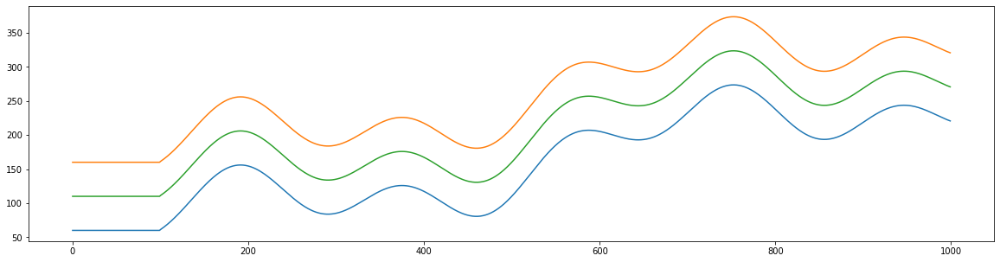

In [ ]:
distance    = np.arange(0, 1000, 1)
road        = 100
wall_left   = 30*(np.sin(distance/180)) + distance * 0.3 + 30 * np.cos(distance/30) + 50 * np.sin(distance/90)
wall_left[0:100] = 60
wall_right  = wall_left + road
wall_center = ( wall_left + wall_right ) / 2


plt.figure(figsize=(20,5)); plt.plot(wall_left); plt.plot(wall_right); plt.plot(wall_center); plt.show()

In [ ]:
class Road():
  def __init__(self, wide):
    self.distance    = np.arange(0, 3000, 1)
    self.wide        = wide
    self.wall_right  = 30*(np.sin(self.distance/180)) + self.distance * 0.3 + 30 * np.cos(self.distance/30) + 50 * np.sin(self.distance/90)
    self.wall_right[0:100] = 60
    self.wall_left   = self.wall_right + self.wide
    self.wall_center = ( self.wall_left + self.wall_right ) / 2

  def show(self):
    fig, ax = plt.subplots(figsize=(26,10)); ax.set_ylim(40, 1000); ax.plot(self.wall_left); ax.plot(self.wall_right); ax.plot(self.wall_center);
    return fig, ax


In [ ]:
class Car():
  def __init__(self, road):
    self.road = road
    self.x = 0
    self.y = self.road.wall_center[0]
    self.sight = 400           # ennyit lát előre 300, 54, 154
    self.sight_center = 400    # ennyit lát előre 150

    self.y_history  = []
    self.x_history  = []
    self.y_center   = []; self.y_center = self.road.wall_center
    self.y_distance = []
    self.y_distance_real = []
    self.y_distance_predicted = []
# Bevezetésre került a LinearRegression intercept nélkül
    self.regression = LinearRegression(fit_intercept=False)
# Bevezetésre került az MLPRegreression
    self.mlp = MLPRegressor(hidden_layer_sizes=(10, 5), # (10, 5)
                            activation='logistic', # relu
                            solver='adam',
                            batch_size='auto',
                            learning_rate_init=0.01,
                            max_iter=1,                           # incremental learning - one step
                            shuffle=True,
                            random_state=1,
                            verbose=True, warm_start=True,        # New test warm_start and verbose 9:19 alatt 719-ig
                            momentum=0.9,
                            nesterovs_momentum=True,
                            early_stopping=True,
                            n_iter_no_change=2000)
# Bevezetésre került az X MinMaxScaler
    self.x_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
# Bevezetésre került az y MinMaxScaler
    self.y_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
#
#    self.regression_left = LinearRegression()
    self.regression_left = LinearRegression(fit_intercept=False)
#    self.regression_center = LinearRegression()
    self.regression_center = LinearRegression(fit_intercept=False)
#    self.regression_right = LinearRegression()
    self.regression_right = LinearRegression(fit_intercept=False)

# most
    self.sensor_center = []
    self.sensor_left   = []
    self.sensor_right  = []
    self.before  = []
    self.after   = []

    self.mesterseges_coutner = 0


  def calculate_distances(self):
    # ha bármikor kevesebb a faltól mért távolsága bármelyik szenzoron akkor a szenzorokon mért távolság is ennyi lesz
    
    k = self.x; d = 0
    while(k < self.x + self.sight_center):
      k += 1; d += 1
      self.distance_center_from_wall = d
      if(int(self.road.wall_left[k]) < self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break
      if(int(self.road.wall_right[k]) > self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1;  d += 1
      self.distance_left_from_wall = d
      if(int(self.road.wall_left[k]) < self.y + d):
        print('Sensor from left wall = ', self.distance_left_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1; d += 1
      self.distance_right_from_wall = d
      if(int(self.road.wall_right[k]) > self.y - d):
        print('Sensor from right wall = ', self.distance_right_from_wall)
        break

    # ki kell kalkulálni a tényleges távolságot a ball és a jobb faltól
    # mert ezekre fogom tanítani a neurális hálót, ahol ezeket becsüljük
    # és a bemeneti változó a 3 szenzorból érkező adat lesz.
    # valójában azt mérjük, hogy milyen távolságra van az út közepétől

    self.distance_from_top     = abs(self.road.wall_left[self.x] - self.y)
    self.distance_from_bottom  = abs(self.road.wall_right[self.x] - self.y)
    print('most távolsagra van a felső faltól = ', self.distance_from_top)
    print('most távolsagra van az alsó faltól = ', self.distance_from_bottom)


    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')
    print('self.x                       = ', self.x)
    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')

    # ezt az értéket fogom becsülni, a középértéktől való eltérés mértéke, ha pozitív akkor fölfelé, ha negatív akkor lefelé tér el
    self.vertical_distance_from_middle = self.y - self.road.wall_center[self.x]

    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')
    print('self.vertical_distance_from_middle = ', self.vertical_distance_from_middle)
    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')




    print('ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke = ', self.vertical_distance_from_middle)


    # de elötte szeretnék még valamit leellenőrizni
    # ezeknek a hossza nem fog megeggyezni a tényleges futások számával, hanem több lesz (milyen jó lett volna erre egy teszt esetet írni és akkor test driven development lenne)

    print('\t\t\t ---------------- Teszt ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Teszt End --------------')


  def append(self):
    self.y_distance.append(self.vertical_distance_from_middle)

    self.sensor_left.append(self.distance_left_from_wall)
    self.sensor_center.append(self.distance_center_from_wall)
    self.sensor_right.append(self.distance_right_from_wall)

    print('\t\t\t ---------------- Append ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Append End --------------')


  def plot(self):
    fig, ax = self.road.show()
    circle = plt.Circle((self.x, self.y), 5, color='black')
    ax.add_patch(circle)
    ax.plot(range(int(self.x), int(self.x+self.distance_center_from_wall)), np.repeat(self.y, self.distance_center_from_wall))
    ax.plot(range(int(self.x), int(self.x+self.distance_left_from_wall)), range(int(self.y), int(self.y+self.distance_left_from_wall)))
    ax.plot(range(int(self.x), int(self.x+self.distance_right_from_wall)), range(int(self.y), int(self.y-self.distance_right_from_wall), -1))
    if( len(self.y_history) > 0 ):
      ax.plot(self.y_history)
    plt.show()


# Bevezetésre került, elmenti a képet
  def save_plot(self):
    fig, ax = self.road.show()
    circle = plt.Circle((self.x, self.y), 5, color='black')
    ax.add_patch(circle)
    ax.plot(range(int(self.x), int(self.x+self.distance_center_from_wall)), np.repeat(self.y, self.distance_center_from_wall))
    ax.plot(range(int(self.x), int(self.x+self.distance_left_from_wall)), range(int(self.y), int(self.y+self.distance_left_from_wall)))
    ax.plot(range(int(self.x), int(self.x+self.distance_right_from_wall)), range(int(self.y), int(self.y-self.distance_right_from_wall), -1))
    if( len(self.y_history) > 0 ):
      ax.plot(self.y_history)
      ax.set_title('#i = ' + str(self.x), fontsize=18, fontweight='bold')
    plt.savefig('history{0:04}'.format(self.x)+'.png')
    plt.close()
    # Nem jeleníti meg a képet csak elmenti


# Bevezetésre került, elementi a képet
  def save_plots(self):
# y_distance vs y_distance_predicted
    plt.figure(figsize=(12, 5)); plt.scatter(self.y_distance_real, self.y_distance_predicted)
    plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real');
    plt.title('#i = ' + str(self.x), fontsize=18, fontweight='bold');
    plt.savefig('y_distance_vs_y_distance_predicted_{0:04}'.format(self.x)+'.png')
    plt.close()


# y_distance vs y_distance_predicted összes adaton
    X_test_full = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
    _X_test_full = X_test_full
    predicted_test_full = self.regression.predict(_X_test_full)
  # Lineáris regresszió helyett Neurális hálót használok
    _X_test_full_scaled = self.x_minmaxscaler.transform(_X_test_full)
    predicted_test_full = self.mlp.predict(_X_test_full_scaled)
  # ToDo : itt még lehet, hogy kéne transzformálni y-t is és az egészet visszatranszformálni eredeti értékére + ellenőrizni, hogy tulajdonképpen amikor skálázom az y-t akkor mi alapján skálázok
    predicted_test_full = self.y_minmaxscaler.inverse_transform(predicted_test_full.reshape(-1, 1))
    _y_test_full = np.array([self.y_distance]).T
    print(_y_test_full.shape)
    print(predicted_test_full.shape)
    plt.figure(figsize=(12, 5)); plt.scatter(_y_test_full, predicted_test_full, c='r');
    plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real');
    plt.title('#i = ' + str(self.x), fontsize=18, fontweight='bold');
    plt.savefig('y_distance_vs_y_distance_predicted_all_{0:04}'.format(self.x)+'.png')
    plt.close()


# y_distance vs y_distance_predicted összes adaton színezve
    _array_target = np.array([_y_test_full.ravel(), predicted_test_full.ravel(), np.arange(0, _y_test_full.shape[0], 1)]).T

    plt.figure(figsize=(12, 5)); plt.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2]);
    plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real');
    plt.title('#i = ' + str(self.x), fontsize=18, fontweight='bold');
    plt.savefig('y_distance_vs_y_distance_predicted_all_color_{0:04}'.format(self.x)+'.png')
    plt.close()


# y_distance vs y_distance_predicted összes adaton színezve vezető vonallal
    plt.figure(figsize=(12, 5)); ax = plt.axes(); ax.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2])
    ax.plot([-10, 2, 4, 10], [-10, 2, 4, 10]); ax.set_ylabel('y_distance_predicted'); ax.set_xlabel('y_distance_real');
    ax.set_title('#i = ' + str(self.x), fontsize=18, fontweight='bold')
    plt.savefig('y_distance_vs_y_distance_predicted_all_color_line_{0:04}'.format(self.x)+'.png')
    plt.close()


# Milyen kapcsolat van a bemenő adatok és a célváltozó között
    plt.figure(figsize=(12, 5)); plt.scatter(self.sensor_left, self.y_distance, c=_array_target[:,2]);
    plt.ylabel('self.y_distance'); plt.xlabel('self.sensor_left');
    plt.title('#i = ' + str(self.x), fontsize=18, fontweight='bold');
    plt.savefig('sensor_left_vs_y_distance_{0:04}'.format(self.x)+'.png')
    plt.close()


# y_distance vs y_distance_predicted összes adaton színezve vezető vonallal
    plt.figure(figsize=(12, 5)); ax = plt.axes(); ax.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2])
    ax.plot([-10, 2, 4, 10], [-10, 2, 4, 10]); ax.set_ylabel('y_distance_predicted'); ax.set_xlabel('y_distance_real');
    ax.set_ylim((-30, 30)); ax.set_xlim((-50, 50));
    ax.set_title('#i = ' + str(self.x), fontsize=18, fontweight='bold')
    plt.savefig('y_distance_vs_y_distance_predicted_all_color_line_fix_{0:04}'.format(self.x)+'.png')
    plt.close()






  def run(self):
    for i in range(0, 3000, 1):
      print('# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------')
      _summary_mlp_prediction_was_taken = 0
      _summary_mlp_fit_was_taken = 0
      _summary_mesterseges_mozgatas = 0
      _summary_action_was_taken = 0

      self.x = i
      self.calculate_distances()
      # !!!
      self.append()
      # !!!
      if ( i % 1 == 0 ):
        if ( i % 80 == 0 ):
          self.plot()
          print(' --- plot --- ')
      # !!!
      if ( i % 1 == 0 ):
        self.save_plot()
        print(' --- plot has been saved --- ')

      if ( i >= 0 ):

        if ( i % 3 == 0 and i >= 12 ):

          print('------------------------------ IF i % 3 == 0 ------------------------------')
          print('# i = ', i)
          print('# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)')
          X = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          y = np.array([self.y_distance]).T
          print('X.shape = ', X.shape)
          print('y.shape = ', y.shape)
          # print('X       = ', X)
          # print('y       = ', y)
          print('i       = ', i)
          self.regression.fit(X, y)
          _summary_mlp_fit_was_taken = 1
# Lineáris regresszió helyett Neurális hálót használok
          self.x_minmaxscaler.fit(X)
          self.y_minmaxscaler.fit(y)
          X_scaled = self.x_minmaxscaler.transform(X)
          y_scaled = self.y_minmaxscaler.transform(y)
          print('---------------------')
          print('X.max = ', X.max())
          print('X.min = ', X.min())
#          print('X[:,0].max = ', X[:,0].max())
#          print('X[:,0].min = ', X[:,0].min())
#          print('X[:,1].max = ', X[:,1].max())
#          print('X[:,1].min = ', X[:,1].min())
#          print('X[:,2].max = ', X[:,2].max())
#          print('X[:,2].min = ', X[:,2].min())
          print('y.max = ', y.max())
          print('y.min = ', y.min())
          print('---------------------')
#          print('X_scaled.shape = ', X_scaled.shape)
#          print('y_scaled.shape = ', y_scaled.shape)
          print('X_scaled.max = ', X_scaled.max())
          print('X_scaled.min = ', X_scaled.min())
#          print('X_scaled[:,0].max = ', X_scaled[:,0].max())
#          print('X_scaled[:,0].min = ', X_scaled[:,0].min())
#          print('X_scaled[:,1].max = ', X_scaled[:,1].max())
#          print('X_scaled[:,1].min = ', X_scaled[:,1].min())
#          print('X_scaled[:,2].max = ', X_scaled[:,2].max())
#          print('X_scaled[:,2].min = ', X_scaled[:,2].min())
          print('y_scaled.max = ', y_scaled.max())
          print('y_scaled.min = ', y_scaled.min())
          print('---------------------')
          self.mlp.fit(X_scaled, y_scaled)


        if( i % 3 == 1 and i >= 22 ):

          print('------------------------------ IF i % 3 == 1 ------------------------------')
          print('# i = ', i)
          print('# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja')
          X_test = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          _X_test = np.array([X_test[-1,:].reshape(-1,1)])
          _X_test = np.array([X_test[-1,:]])
          print('actual _X_test = ', _X_test)
          predicted_test = self.regression.predict(_X_test)
# Lineáris regresszió helyett Neurális hálót használok
          _X_test_scaled = self.x_minmaxscaler.transform(_X_test)
          predicted_test = self.mlp.predict(_X_test_scaled)
# ToDo : Fontos lenne visszatranszformálni a predicted_test értéket mielőtt belekerül az archivumba
          _summary_mlp_prediction_was_taken = 1
          self.y_distance_real.append(self.y_distance[-1])
          self.y_distance_predicted.append(predicted_test)
          print('actual predicted = ', predicted_test)
#         print('actual predicted = {:.5f}'.format(predicted_test[0,0]))
          print('actual self.y_distance[-1] = ', self.y_distance[-1])
#         print('actual self.y_distance     = ', self.y_distance)
          print('len(self.y_distance_real)      = ', len(self.y_distance_real))
          print('len(self.y_distance_predicted) = ', len(self.y_distance_predicted))

          if( i % 32 == 0 ):
            # olyan szar a becslés, hogy az hihetetlen
            plt.figure(figsize=(12, 5)); plt.scatter(self.y_distance_real, self.y_distance_predicted)
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()
            
            # korábban csak azokat az adatokat plottoltam amik a tanulás után lettek visszamérve,
            # de nézzük meg a teljes adatsoron
            X_test_full = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
            _X_test_full = X_test_full
            predicted_test_full = self.regression.predict(_X_test_full)
# Lineáris regresszió helyett Neurális hálót használok
            _X_test_full_scaled = self.x_minmaxscaler.transform(_X_test_full)
            predicted_test_full = self.mlp.predict(_X_test_full_scaled)
# ToDo : itt még lehet, hogy kéne transzformálni y-t is és az egészet visszatranszformálni eredeti értékére + ellenőrizni, hogy tulajdonképpen amikor skálázom az y-t akkor mi alapján skálázok
            predicted_test_full = self.y_minmaxscaler.inverse_transform(predicted_test_full.reshape(-1, 1))
            _y_test_full = np.array([self.y_distance]).T
            print(_y_test_full.shape)
            print(predicted_test_full.shape)
            plt.figure(figsize=(12, 5)); plt.scatter(_y_test_full, predicted_test_full, c='r');
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            _array_target = np.array([_y_test_full.ravel(), predicted_test_full.ravel(), np.arange(0, _y_test_full.shape[0], 1)]).T

            plt.figure(figsize=(12, 5)); plt.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2]);
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            plt.figure(figsize=(12, 5)); ax = plt.axes(); ax.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2])
            ax.plot([-10, 2, 4, 10], [-10, 2, 4, 10]); ax.set_ylabel('y_distance_predicted'); ax.set_xlabel('y_distance_real'); plt.show()
            print(' --- plot predcition --- ')

            # Milyen kapcsolat van a bemenő adatok és a célváltozó között
# New
            plt.figure(figsize=(12, 5));
            plt.scatter(self.sensor_left, self.y_distance, c=_array_target[:,2]);
            plt.ylabel('self.y_distance');
            plt.xlabel('self.sensor_left');
            plt.show()
            print('len(self.sensor_left) = ', len(self.sensor_left))
            # print(self.sensor_left)
            print('len(self.y_distance) = ', len(self.y_distance))
            # print(self.y_distance)

# New
          self.save_plots()

        # most jön az, hogy véletlenszerűen kell egyet ugrania fel, vagy le
        # ez felel meg a before after dologonak
        # az így létrejött adatokat is el kell tárolni úgy mint
        # mi volt a szezoros adat before
        # mi lett a szenzoros adat after
        # mi volt az y before, mi lett az y after
        # mivel mindíg egyet fogunk csak lépni, ezért a dif mindíg egy lesz
        # de ezt számítani kell, mivel a későbbiek folyamán lehet, hogy többet is fog lépni

        if( i % 3 == 2 ):

          print('------------------------------ IF i % 3 == 2 ------------------------------')
          print('# i = ', i)
          print('# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok')

          _summary_mesterseges_mozgatas = 1
          
          if( self.mesterseges_coutner == 0 ):                             # Első lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 1

          elif( self.mesterseges_coutner == 1 ):                           # Második lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 2

          elif( self.mesterseges_coutner == 2 ):                           # Harmadik lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 3

          elif( self.mesterseges_coutner == 3 ):                           # Negyedik lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 0

          else:
            print('semmi\n\n\n\n')

          print('self.y = ', self.y)



# itt van egy érdekesség amit csak magamnak írok fel
# ezen a ponton lépünk ki a három if ágból - if( i % 3 == _ )

# ez azért fontos, mert ami itt következik az mindíg lefut
# akár volt neurális háló tanítás
# akár volt neurális háló predikció visszamérése
# akár volt mesterséges mozgatás


# felmerül a kérdés de csak felmerül, hogy nem lehet-e az, hogy ezt csak akkor kéne elvégezni amikor nincs neurális háló tanítás és nincs mesterséges mozgatás sem
# ezt csak egy kísérlet ereéig ki kéne próbálni (if i % 3 == 1) -> vagyis amikor az nn predikció mérése történik

        action = 0
        if( i % 3 == 0 ):

          if( len(self.before) > 9 ):           # ha már van néhány before after adatunk, akkor

            print('------------------------------ IF len(self.before) > 9 ------------------------------')
            print('\n')
            print('  Ha már van elég before after adatunk')
            print('# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára')
            # minden egyes szezor adatára el kell készítenünk azt a lineráis regressziós modelt ami megmondja, hogy mi lenne a szenzor értéke, ha 1, 2, 3, ... n lépéssel elvinnénk a kocsit

            # oké megvan a before és megvan az after (self.y, left, center, right)
            before_array = np.array(self.before)
            after_array  = np.array(self.after)
            y_delta = after_array[:,0] - before_array[:,0]
            delta_array = after_array - before_array
#            print('--------------------------------------')
#            print(y_delta)
#            print(before_array.shape)
#            print(after_array.shape)
#            print('self.before = \n', self.before)
#            print('self.after  = \n', self.after)
#            print('delta_array = \n', delta_array)
#            print('--------------------------------------')

            # képlet szerint senzor' = w0 + w1 * senzor + w2 * delta_y
            # valójában ez a képlet nem jó és nem így kéne számolni, mert ez figyelembe veszi a szenzor aktuális értékét is, de most így hagyom
            # ------- fenti sort nem tudom miért írtam, hogy baj az ha figyelembe veszük az aktuális értéket is, hm.

            print('# Linear Regression Learning --------------------------------------------------------------------------------------')
            print('\t\t # Linear Regression Training Results -------------------------------------------------------------------------')

            _X_left = np.array([before_array[:,1], delta_array[:,0]]).T # left és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_left = delta_array[:,1].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_left = after = after_array[:,1].reshape(-1, 1)
            regression_left = self.regression_left
            regression_left.fit(_X_left, _y_left)
            # print('\t\t _X_left = \n', _X_left)
            # print('\t\t _y_left = \n', _y_left)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_left.coef_ = ', regression_left.coef_)
            print('\t\t regression_left.intercept_ = ', regression_left.intercept_)
            _predicted_left = regression_left.predict(_X_left)
#            plt.scatter(_y_left, _predicted_left)
#            plt.ylabel('_predicted_left')
#            plt.xlabel('_true_y_left')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,1], after_array[:,1], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_center = np.array([before_array[:,2], delta_array[:,0]]).T # center és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_center = delta_array[:,2].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_center = after_array[:,2].reshape(-1, 1)
            regression_center = self.regression_center
            regression_center.fit(_X_center, _y_center)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_center.coef_ = ', regression_center.coef_)
            print('\t\t regression_center.intercept_', regression_center.intercept_)
            _predicted_center = regression_center.predict(_X_center)
#            plt.scatter(_y_center, _predicted_center)
#            plt.ylabel('_predicted_center')
#            plt.xlabel('_true_y_center')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,2], after_array[:,2], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_right = np.array([before_array[:,3], delta_array[:,0]]).T # right és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_right = delta_array[:,3].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_right = after_array[:,3].reshape(-1, 1)
            regression_right = self.regression_right
            regression_right.fit(_X_right, _y_right)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_right.coef_ = ', regression_right.coef_)
            print('\t\t regression_right.intercept_ = ', regression_right.intercept_)
            _predicted_right = regression_right.predict(_X_right)
#            plt.scatter(_y_right, _predicted_right)
#            plt.ylabel('_predicted_right')
#            plt.xlabel('_true_y_right')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,3], after_array[:,3], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()


            # most ki kell számolni, hogy mennyi lenne a szenzorok értéke, ha fel le lépkednénk

            # mondjuk maximalizáljuk a fel le lépkedés mértékét 5-ben

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])

            move = np.array([-2, -1, 0, 1, 2])

            move = np.array([-3, -2, -1, 0, 1, 2, 3])

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])

            move = np.array([-7, -6, -5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5, 6, 7])


  # most


            print('\t # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------')

            print('\t\t # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke')
            proba_X_metrika   = np.array([1,1]).reshape(1, -1)
            print('proba_X_metrika   = ', proba_X_metrika)
            predicted_proba_left = regression_left.predict(proba_X_metrika)
            predicted_proba_center = regression_center.predict(proba_X_metrika)
            predicted_proba_right = regression_right.predict(proba_X_metrika)
            print('-------- 1 y up ->  left   = ', predicted_proba_left)
            print('-------- 1 y up ->  center = ', predicted_proba_center)
            print('-------- 1 y up ->  right  = ', predicted_proba_right)
            print('\n')

            # EGY KURVA NAGY ELMÉLETI DILLEMMÁHOZ ÉRKEZTEM.

            # HÁROM MEGOLDÁS VAN

            # EBBŐL SZERINTEM MOST A LEGROSSZABBAT VÁLASZOTTAM

            # 1, MINDENKÉPPEN VÁLASZT EGYET, A LEGJOBBAT

            # 2, CSAK AKKOR MODOSÍT HA KÖZELEBB TUDJA VINNI A KÖZÉPPONTHOZ MINT AHOL MOST VAN

            # 3, CSAK AKKOR MODOSÍT HA NEM A KÖZÉPPONTON VAN

            # 4, CSAK AKKOR MODOSÍT HA KILÉPETT A SÁVBÓL

            # 5, CSAK AKKOR MODOSÍT HA EGY ELŐRE MEGADOTT ÉRTÉKNÉL JOBBAN ELTÉR A KÖZÉPPONTTÓL
            
            action = 0; tmp = 999999990

            for j in move:
              print('\n')
              print('\t\t minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba')
              print('\t\t j = ', j)
              # ide be kell helyettesítenem az éppen aktuális értéket, olyan mintha egy új X változót csinálnék amiben csak egy sor van és arra kérnék egy becslést a korábbi modell alapján
              # a bement az éppen aktuális szenzoros érték és az új lépés

              # na majd ezt a bemenetet kell ellenőrizni, hogy stimmel-e a tanítás során használt bemenettel
              _X_left   = np.array([[self.distance_left_from_wall, j]])
              _X_center = np.array([[self.distance_center_from_wall, j]])
              _X_right  = np.array([[self.distance_right_from_wall, j]])

              print('\t\t ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------')
              print('\t\t _X_left   = ', _X_left)
              print('\t\t _X_center = ', _X_center)
              print('\t\t _X_right  = ', _X_right)

              # a fenti értékek valószínűleg jók, de mindíg minden lépésnél ellenőrizni kell

              predicted_left   = regression_left.predict(_X_left)
              predicted_center = regression_center.predict(_X_center)
              predicted_right  = regression_right.predict(_X_right)

              print('\t\t predicted_left   = ', predicted_left)
              print('\t\t predicted_center = ', predicted_center)
              print('\t\t predicted_right  = ', predicted_right)

              print('\t\t --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------')
              print('\t\t regression_left.coef_   = ', regression_left.coef_)
              print('\t\t regression_center.coef_ = ', regression_center.coef_)
              print('\t\t regression_right.coef_  = ', regression_right.coef_)
              print('\t\t regression_left.intercept_   = ', regression_left.intercept_)
              print('\t\t regression_center.intercept_ = ', regression_center.intercept_)
              print('\t\t regression_right.intercept_  = ', regression_right.intercept_)

              # nekünk majd azt az értéket kell választanunk amelyik segítségével a legközelebb jutunk a 0 értékhez

              _X = np.array([predicted_left.ravel(), predicted_center.ravel(), predicted_right.ravel()]).T    # figyelni kell rá, hogy eredetileg is ez volt-e a változók sorrendje

              _X_scaled = self.x_minmaxscaler.transform(_X)

              print('\t\t # Ez lesz a bemenete a neurális hálónak')
              print('\t\t -------------------------X-------------------------')
              print('\t\t ', _X)
              print('\t\t -------------------------X_scaled------------------')
              print('\t\t ', _X_scaled)
# Elvileg meg lehetne csinálni, hogy az új értékek is mindenféleképen a -1, 1 intervallumba essenek, de jelenleg nem így történik
# Ez nem lesz könnyű

# Ami itt nehéz lesz, hogy a régi X értékekhez, vagy ahhoz amin elvégeztem az x_minmaxscalert hozzá kell csapnom az új linreg által számolt _X
# tömböt és azon megcsiálnom a teljes skálázást (bár ez az egész módszer nem biztos, hogy jó, sőt, de nincs jobb ötletem)
              
              print('\t\t ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------')

# Lineáris regresszió
              predicted_position = self.regression.predict(_X)
              print('\t\t predicted_position linreg model            = ', predicted_position)
# Lineáris regresszió helyett Neurális hálót használok
              predicted_position_scaled = self.mlp.predict(_X_scaled)
              print('\t\t predicted_position neural net model scaled = ', predicted_position_scaled)
# Vissza kell transzformálnom eredeti formájába
              predicted_position = self.y_minmaxscaler.inverse_transform(predicted_position_scaled.reshape(-1, 1))
              print('\t\t predicted_position neural net model inverz = ', predicted_position)

              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')

              # legyünk bátrak és módosítsuk az autó self.y pozicióját

              # azzal az értékkel amely abszolút értékben a legkissebb, helyett
              # mivel a célváltozónk akkor jó ha 0, mivel a középvonaltól mért eltérés
              # ezért itt azt az értéket kell kiválasztani ami a legközelebb van 0-hoz

              # természetesen ezen változtatni kell ha nem a középvonaltól való eltérés mértékét akarjuk becsülni
              # de ahhoz fent is át kell állítani hogy mi legyen a self.y_distance számítása

              if( abs(0 - predicted_position) < tmp):       # rossz - javítva - tesztelés alatt
                action = j
                tmp = abs(0 - predicted_position)
                print('\t\t ---------------------')
                print('\t\t  action = ', action)
                print('\t\t  predicted_position = ', predicted_position)
                print('\t\t  absolute distance from 0 (tmp) = ', tmp)
                print('\t\t ---------------------')

              print('\t\t adott j-re {0} kiszámoltuk az előrejelzést de még nem hoztunk döntést -----------------------------------------------------------------'.format(j))
              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')
            
            print('\t minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------\n')
# igazság szerint ez a kör minden lépésben lefut ha már van elég before after adatunk


# a döntés azonban csak akkor fut le ha az alábbi feltétel teljesül, de igazából korábban már be van ágyazva ugyan ebbe a feltételbe

          if( i % 3 == 0 ):                                                       # ugyan ez a feltétel amikor tanítom az út közepének a becslésére
            print('------------------------------ IF i % 3 == 0 ------------------------------')
            _summary_action_was_taken = 1
            print('=================== TAKE ACTION ===================')
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            print('-------- ennyivel módosítom self.y értékét --------')
            print('self.y régi értéke = ', self.y)
            self.y = self.y + action
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))

            print('self.y új értéke   = ', self.y)
            print('action             = ', action)
            print('----------------- módosítás vége -----------------')




          # újra kell gondolni az egészet, ugyanis akkor is ki kell számolni a before after értéket amikor modosítom a pozicióját,
          # vagyis végig kell gondolni ezt az egészet.
          # az első elképzelésem az volt, hogy a poziciót csak bizonyos esetben modosíthatom, csak akkor amikor nincs tanítás, és nincs szimulált emelés, vagy csökkentés sem
          # utóbbit az if( i % 3 == 2) feltétellel szűrtem


      # adjuk hozzá az értéket a self.y_history-hoz
      print('# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------')
      print('#   itt adom hozzás a self.y a self.y_history-hoz')
      self.y_history.append(self.y)
      print('#    self.y :')
      print(self.y)
#      print('#   self.y_history after append :')
#      print(self.y_history)
      print('# \t\t ----------------- Summary -----------------')
      print('# \t\t\t _summary_mlp_fit_was_taken         = ', _summary_mlp_fit_was_taken)
      print('# \t\t\t _summary_mlp_prediction_was_taken  = ', _summary_mlp_prediction_was_taken)
      print('# \t\t\t _summary_mesterseges_mozgatas      = ', _summary_mesterseges_mozgatas)
      print('# \t\t\t _summary_action_were_taken         = ', _summary_action_was_taken)
      print('# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')
          


Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


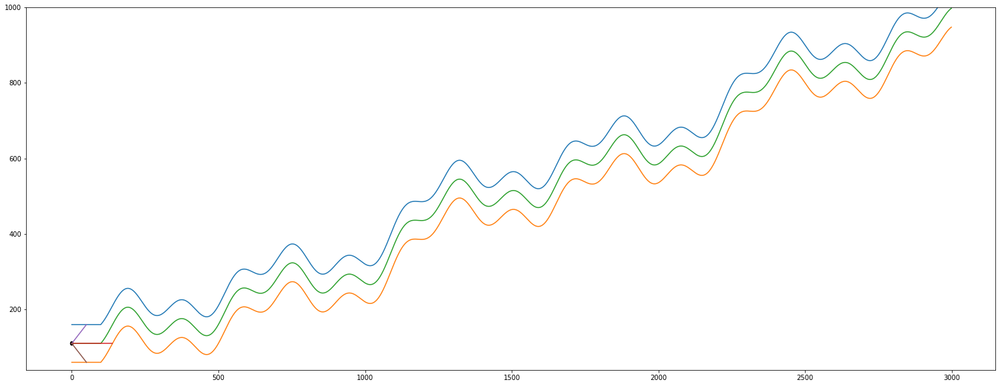

In [ ]:
road = Road(wide = 100)
auto = Car(road)

auto.calculate_distances()
auto.plot()

In [ ]:
auto.calculate_distances()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------
			 ---------------- Append --------

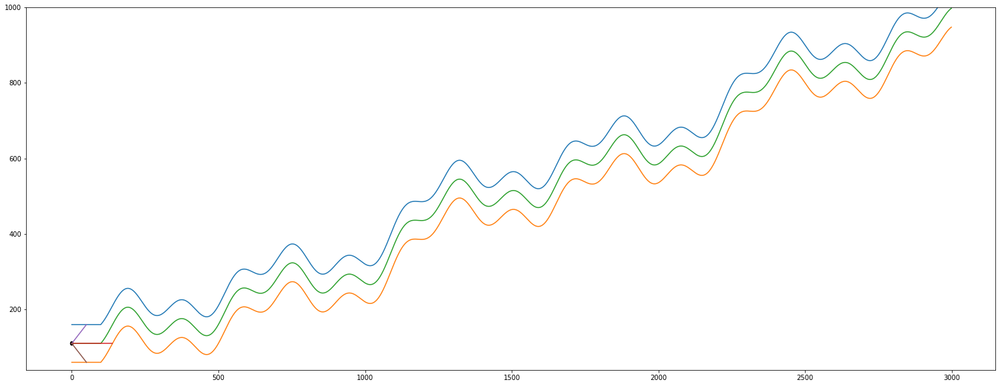

Streaming output truncated to the last 5000 lines.
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  44
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  86
Sensor from left wall =  159
Sensor from right wall =  36
most távolsagra van a felső faltól =  65.0
most távolsagra van az alsó faltól =  35.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  44
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -15.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  -15.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  45
			 len(self.sensor_left)   

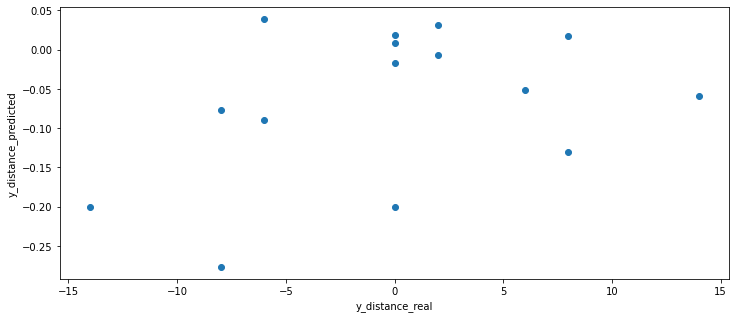

(65, 1)
(65, 1)


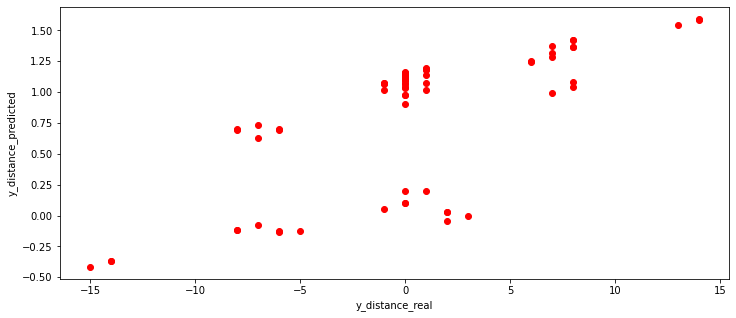

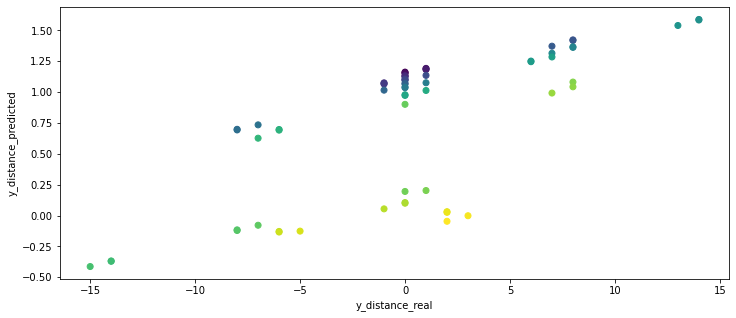

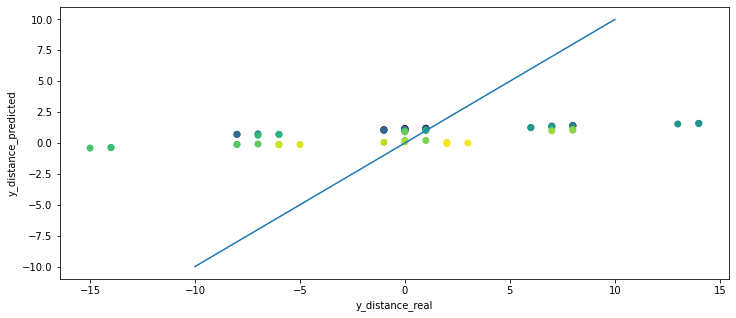

 --- plot predcition --- 


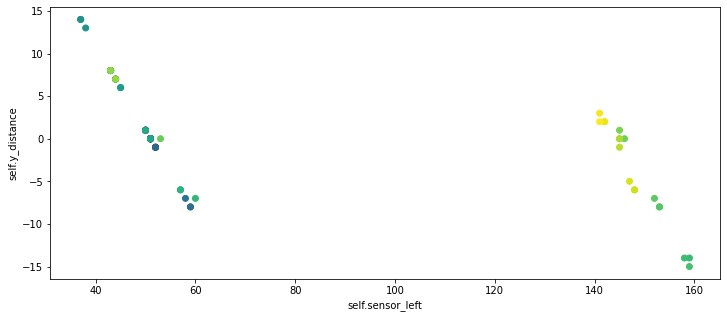

len(self.sensor_left) =  65
len(self.y_distance) =  65
(65, 1)
(65, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
112.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  76
Sensor from left wall =  141
Sensor from right wall =  44
most távolsagra van a felső faltól =  48.0
most távolsagra van az alsó 

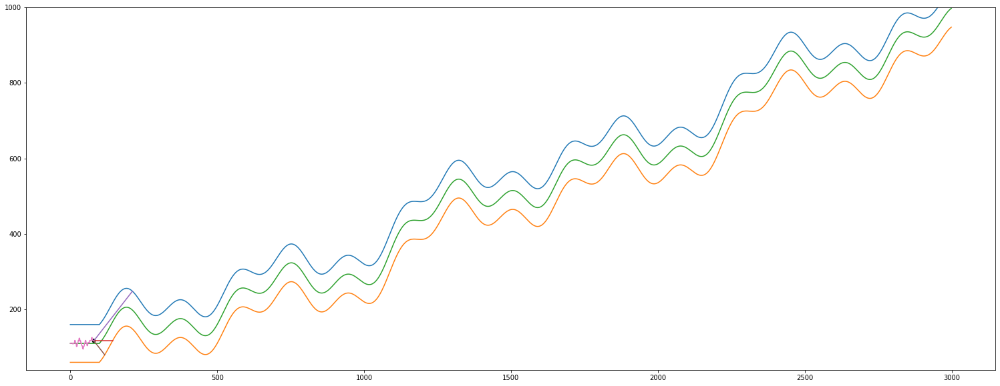

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  141
			 len(self.sensor_right)  =  141
			 self.x                  =  140
			 -------------- Teszt End --------------
self.y =  161.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
161.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sens

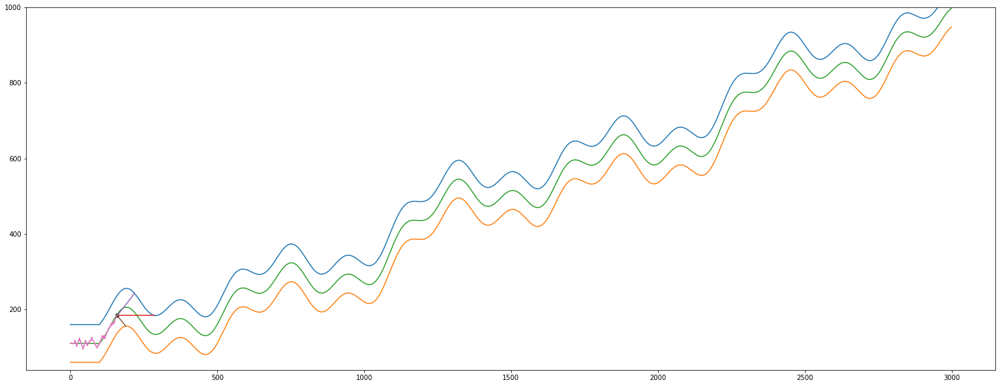

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  160
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 59 128  30]]
actual predicted =  [-0.02995332]
actual self.y_distance[-1] =  -3.6780475580867744
len(self.y_distance_real)      =  47
len(self.y_distance_predicted) =  47


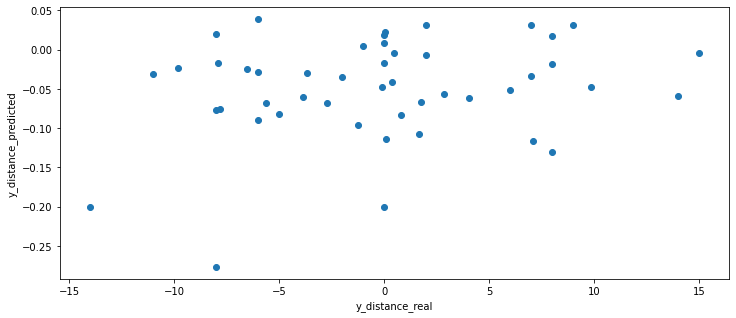

(161, 1)
(161, 1)


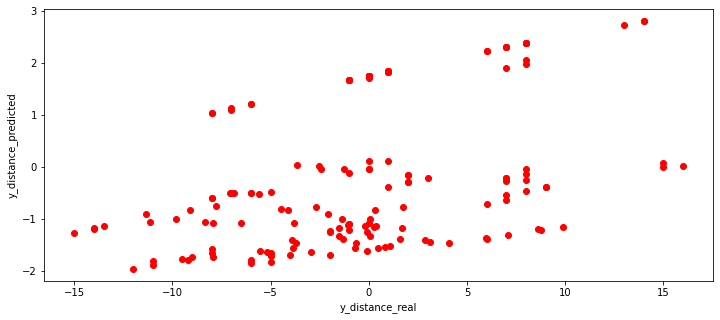

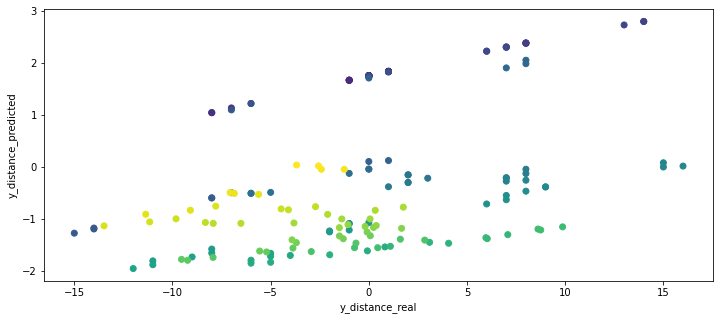

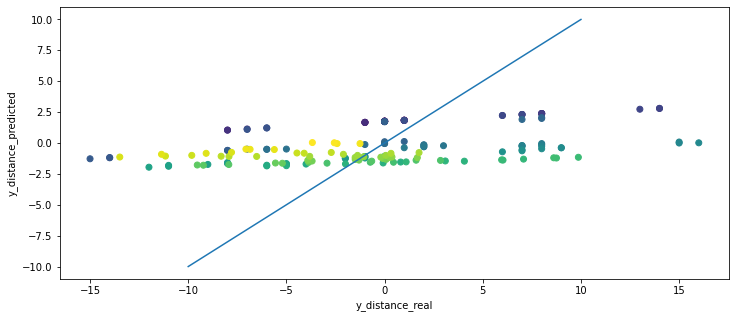

 --- plot predcition --- 


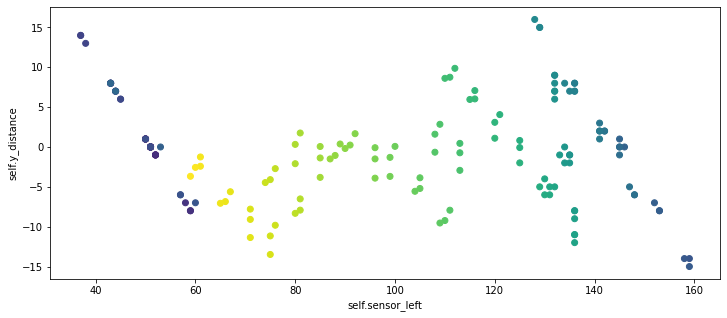

Streaming output truncated to the last 5000 lines.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  16.215128957458035
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  16.215128957458035
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  217
			 len(self.sensor_left)   =  217
			 len(self.sensor_center) =  217
			 len(self.sensor_right)  =  217
			 self.x                  =  216
			 -------------- Teszt End --------------
self.y új értéke   =  211.0
action             =  -7
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
211.0
# 		 ----------------- Summary

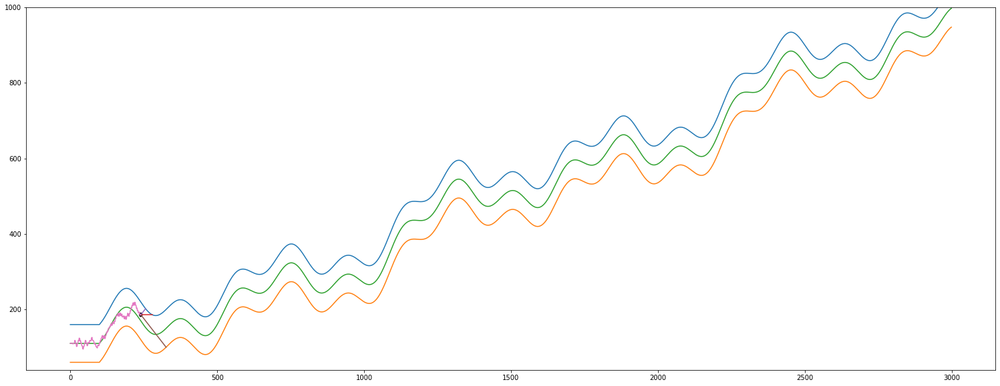

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  240
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (241, 3)
y.shape =  (241, 1)
i       =  240
---------------------
X.max =  395
X.min =  11
y.max =  28.72624421327137
y.min =  -31.971385600374987
---------------------
X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  0.9999999999999998
y_scaled.min =  -1.0
---------------------
Iteration 77, loss = 0.06602859
Validation score: 0.115292
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results ----------------------

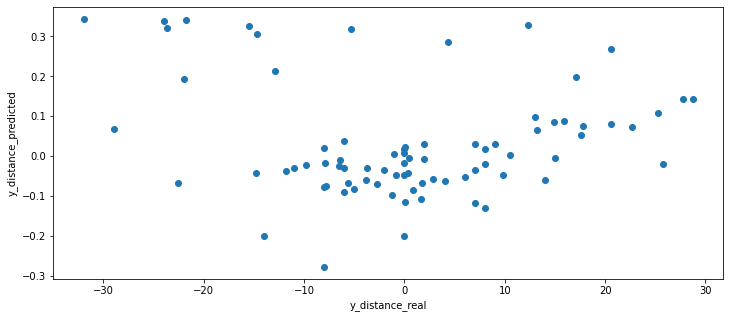

(257, 1)
(257, 1)


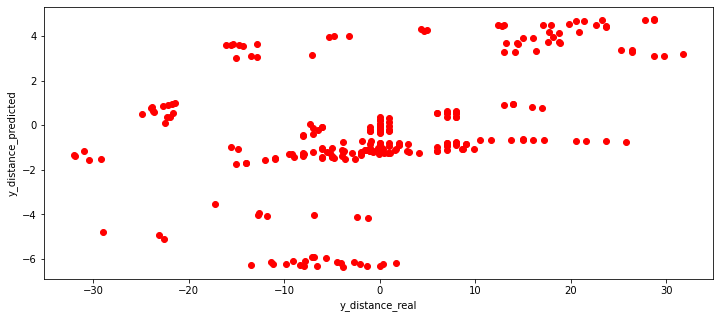

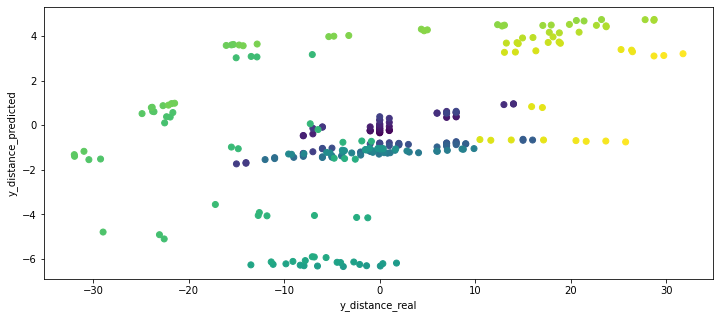

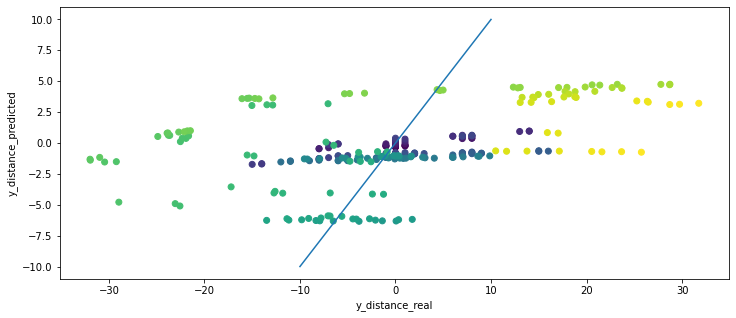

 --- plot predcition --- 


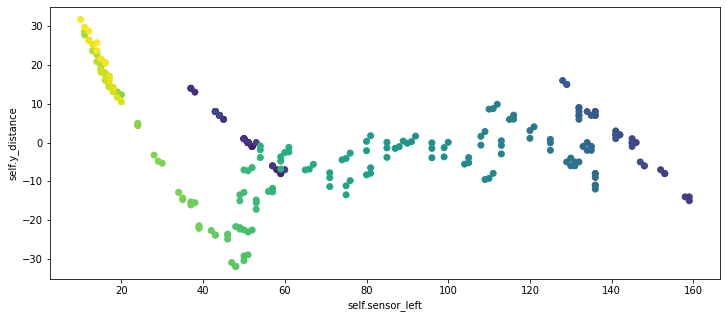

Streaming output truncated to the last 5000 lines.
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  227
Sensor from left wall =  78
Sensor from right wall =  40
most távolsagra van a felső faltól =  36.65345124056478
most távolsagra van az alsó faltól =  63.34654875943521
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  298
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  13.346548759435223
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mérté

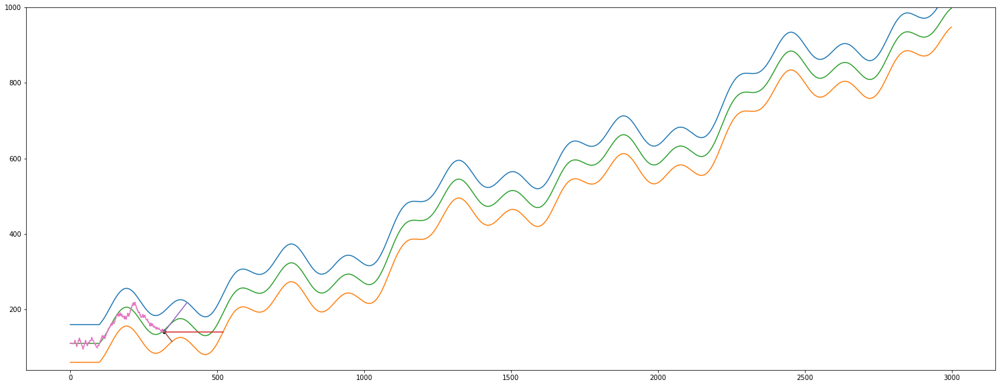

Streaming output truncated to the last 5000 lines.
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
135.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  185
Sensor from left wall =  77
Sensor from right wall =  19
most távolsagra van a felső faltól =  69.59570302883395
most távolsagra van az alsó faltól =  30.404296971166048
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  332
cccccccccccccccccccccccccccccccccccccccc

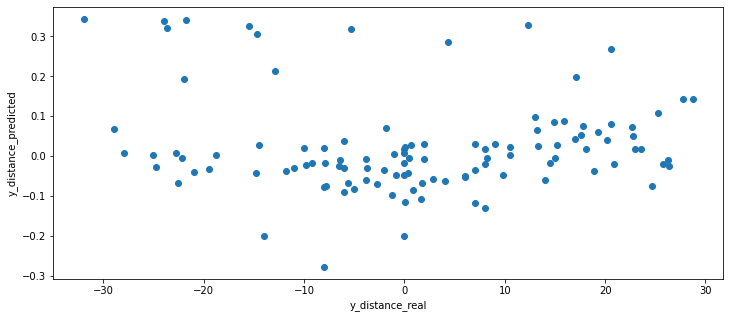

(353, 1)
(353, 1)


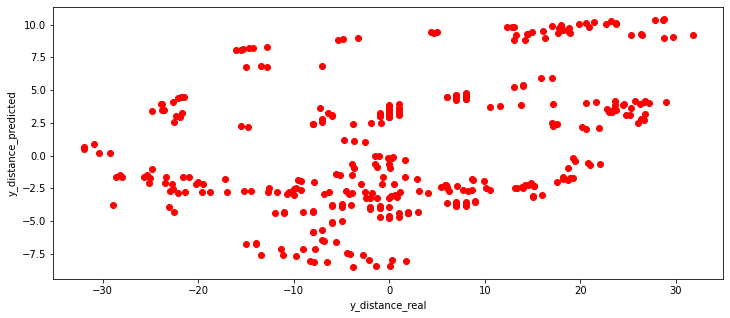

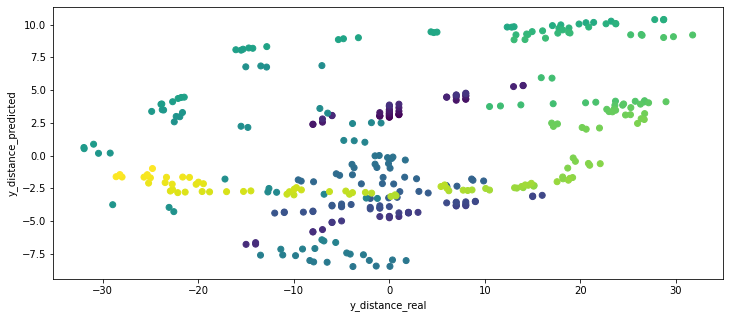

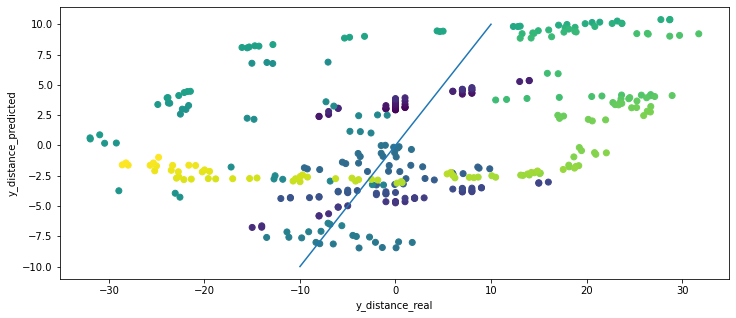

 --- plot predcition --- 


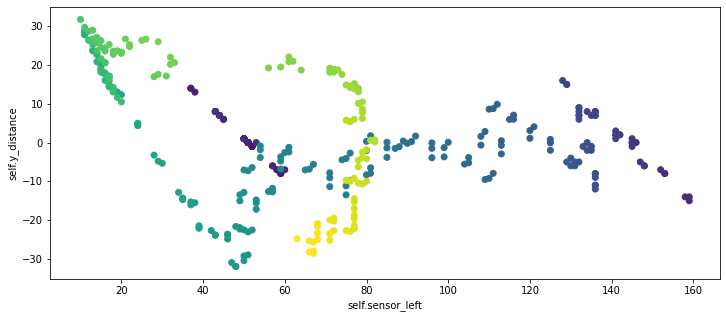

Streaming output truncated to the last 5000 lines.
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[1.14083429]]
		 predicted_position neural net model scaled =  [0.07585805]
		 predicted_position neural net model inverz =  [[1.50504081]]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 6 kiszámoltuk az előrejelzést de még nem hoztunk döntést -----------------------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  7
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _

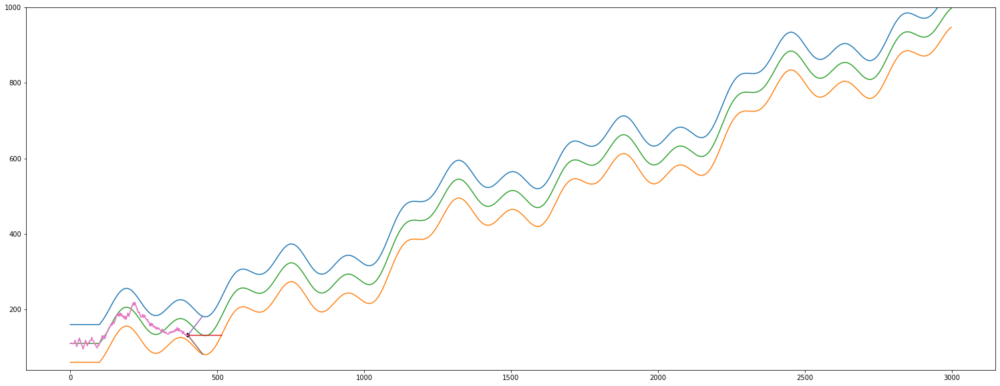

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  -1.3228819404974388
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  428
			 len(self.sensor_left)   =  428
			 len(self.sensor_center) =  428
			 len(self.sensor_right)  =  428
			 self.x                  =  428
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  429
			 len(self.sensor_left)   =  429
			 len(self.sensor_center) =  429
			 len(self.sensor_right)  =  429
			 self.x                  =  428
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  428
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  94
Sensor from le

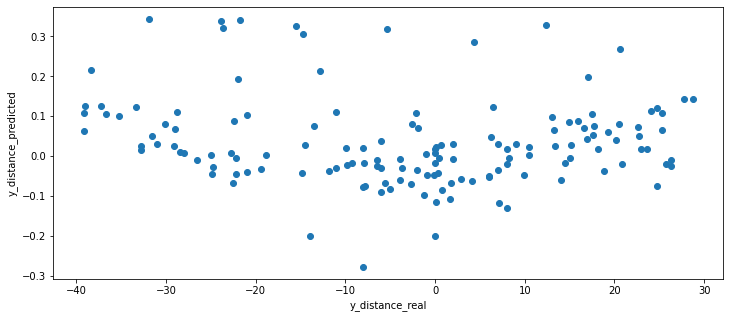

(449, 1)
(449, 1)


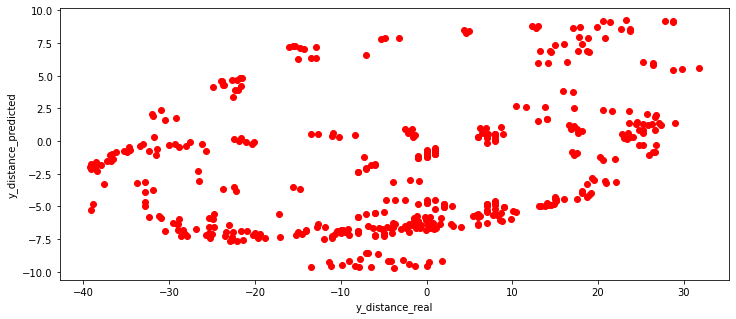

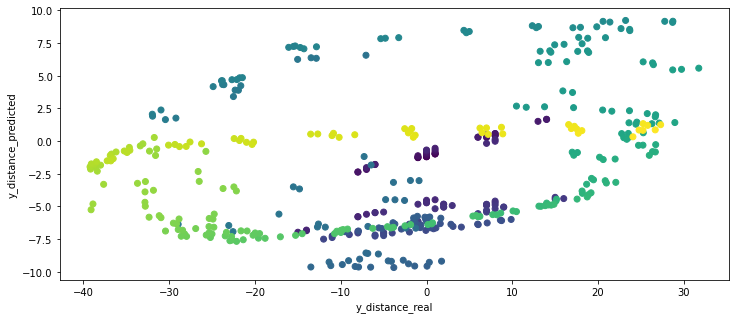

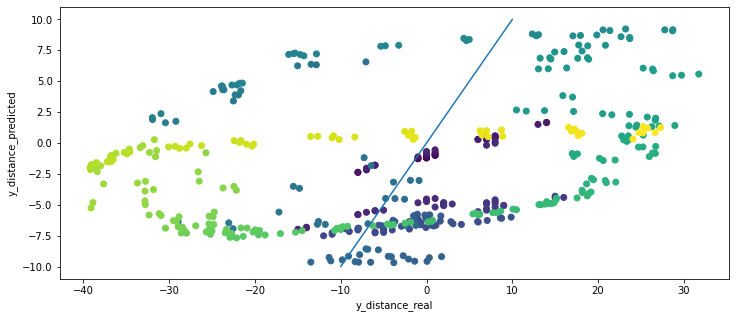

 --- plot predcition --- 


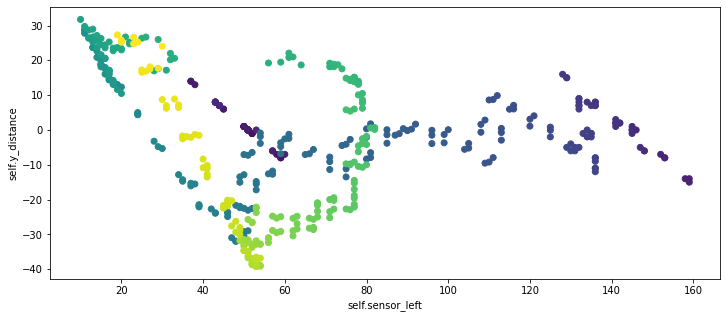

Streaming output truncated to the last 5000 lines.



		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -7
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[14 -7]]
		 _X_center =  [[81 -7]]
		 _X_right  =  [[50 -7]]
		 predicted_left   =  [[24.01147057]]
		 predicted_center =  [[107.24264604]]
		 predicted_right  =  [[40.19988009]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.97740405 -1.47540198]]
		 regression_center.coef_ =  [[ 0.965342   -4.14999206]]
		 regression_right.coef_  =  [[0.97777756 1.24128541]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 24.01147057 107.24264604  40.19988009]]
		 --------------------

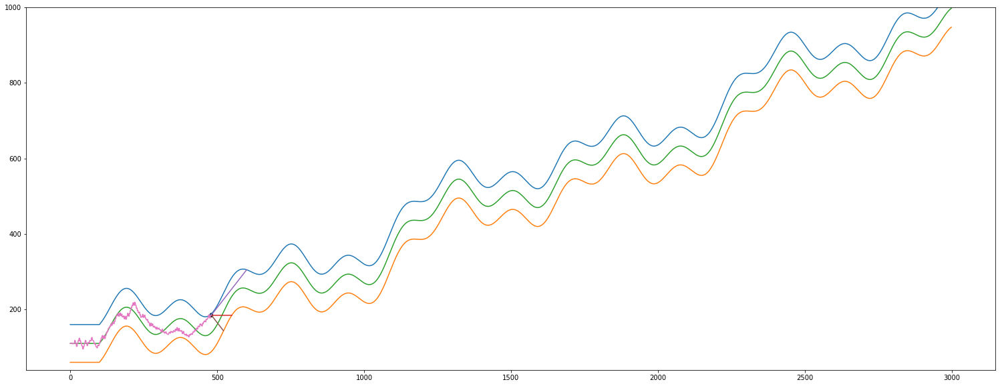

Streaming output truncated to the last 5000 lines.
len(self.y_distance_real)      =  168
len(self.y_distance_predicted) =  168
(524, 1)
(524, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
181.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  24
Sensor from left wall =  113
Sensor from right wall =  

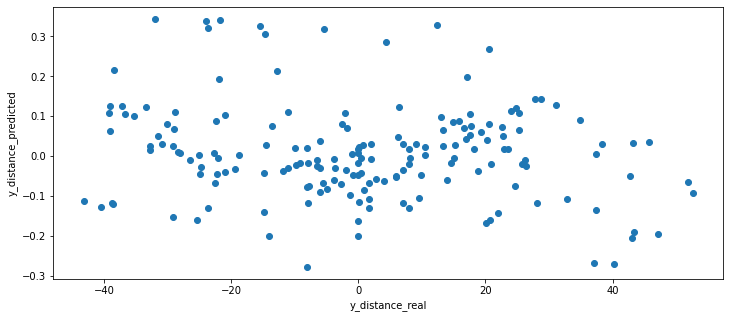

(545, 1)
(545, 1)


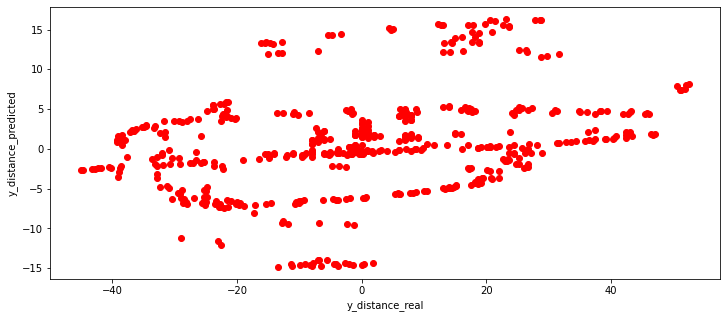

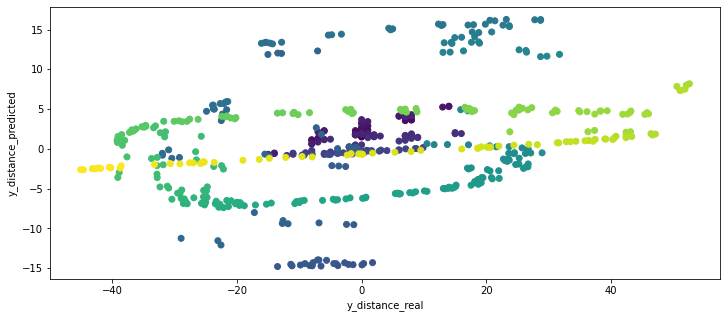

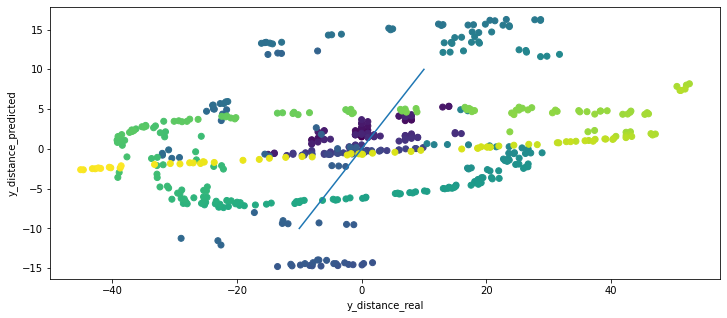

 --- plot predcition --- 


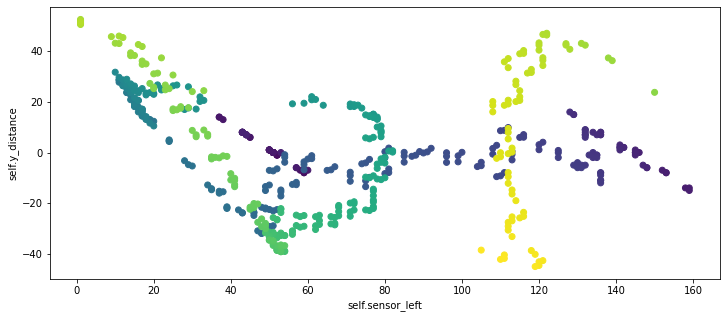

len(self.sensor_left) =  545
len(self.y_distance) =  545
(545, 1)
(545, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
189.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  10
Sensor from left wall =  105
Sensor from right wall =  5
most távolsagra van a felső faltól =  89.89620862557285
most távolsa

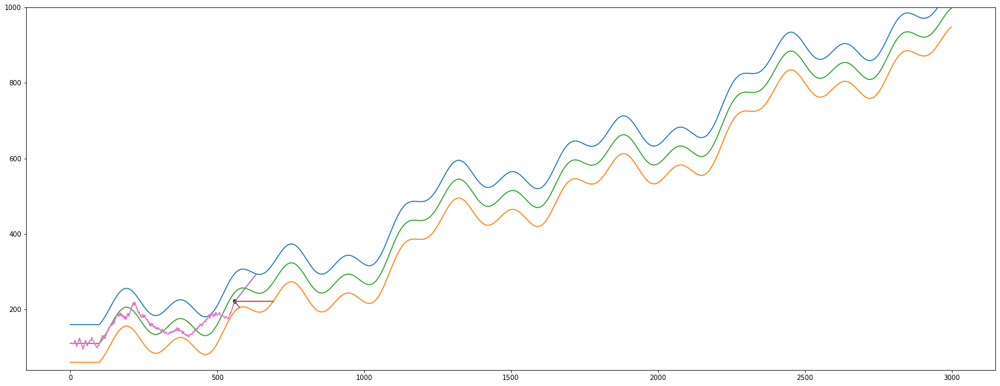

Streaming output truncated to the last 5000 lines.
len(self.y_distance_predicted) =  200
(620, 1)
(620, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
241.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  88
Sensor from left wall =  133
Sensor from right wall =  44
most távolsagra van a felső faltól 

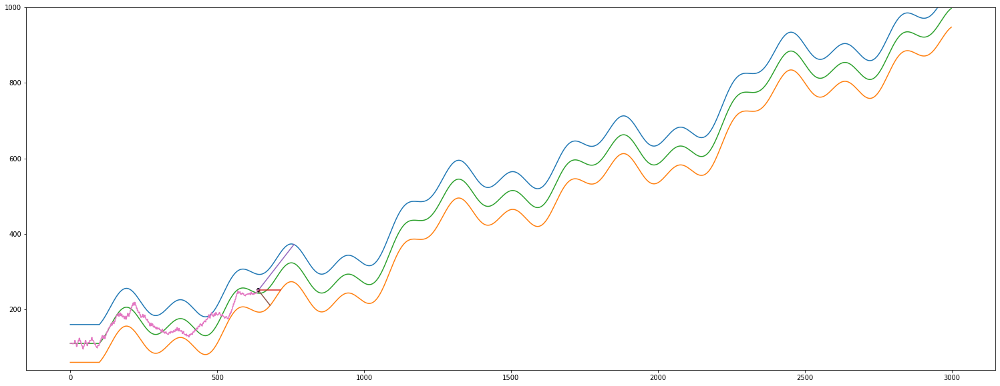

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  640
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[122  77  41]]
actual predicted =  [-0.06981279]
actual self.y_distance[-1] =  7.9806171618877215
len(self.y_distance_real)      =  207
len(self.y_distance_predicted) =  207


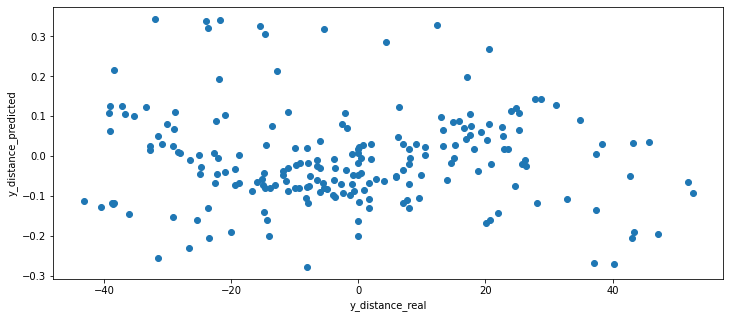

(641, 1)
(641, 1)


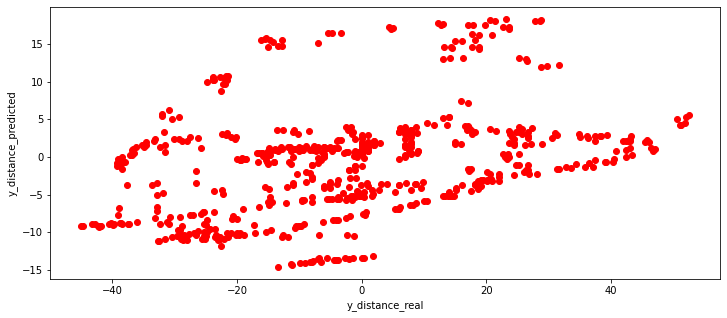

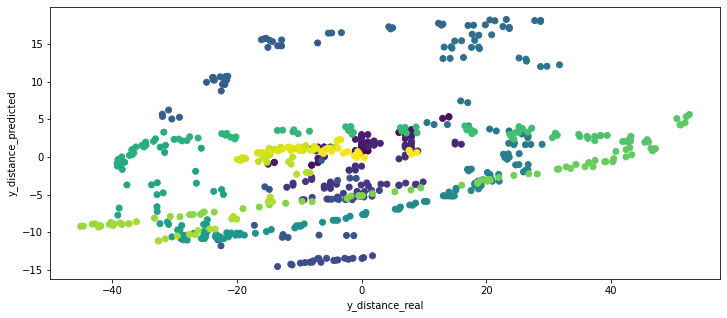

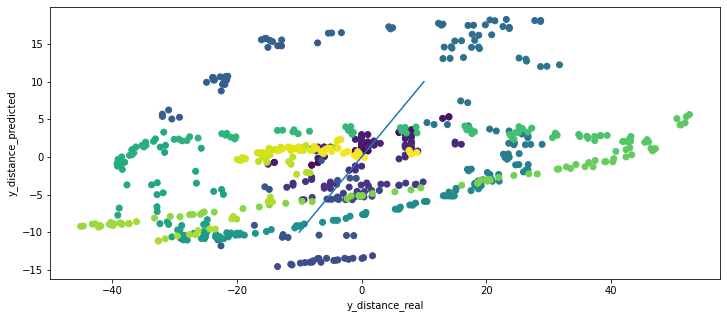

 --- plot predcition --- 


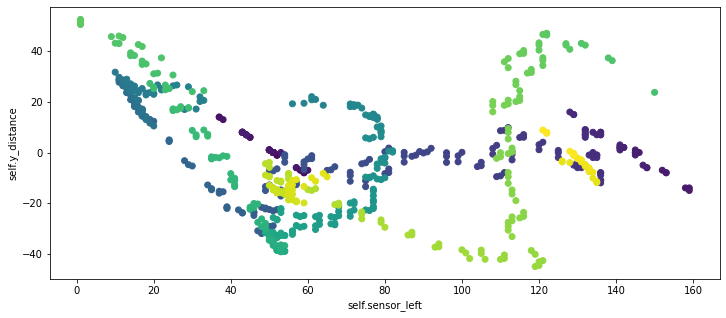

Streaming output truncated to the last 5000 lines.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  698
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  36.71615389315201
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  36.71615389315201
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  699
			 len(self.sensor_left)   =  699
			 len(self.sensor_center) =  699
			 len(self.sensor_right)  =  699
			 self.x                  =  698
			 -------------- Teszt End --------------
self.y =  317.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
317.0
# 		 ----------------- 

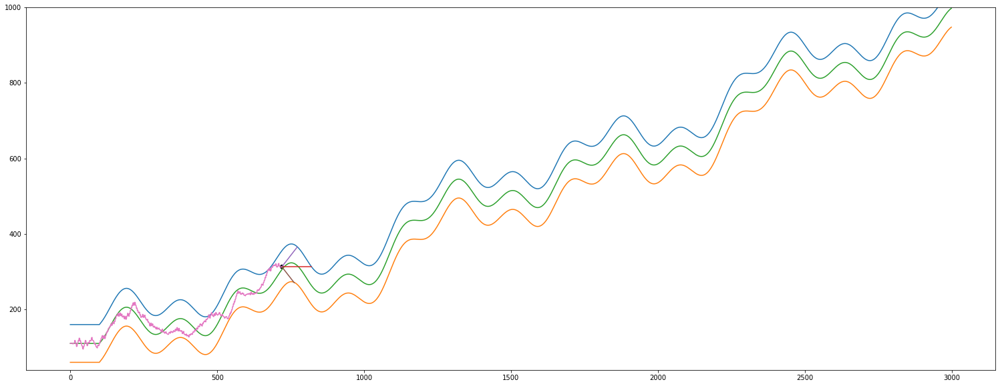

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  720
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (721, 3)
y.shape =  (721, 1)
i       =  720
---------------------
X.max =  400
X.min =  1
y.max =  52.588642433442544
y.min =  -45.07232657917211
---------------------
X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 237, loss = 0.09725165
Validation score: 0.037889
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------

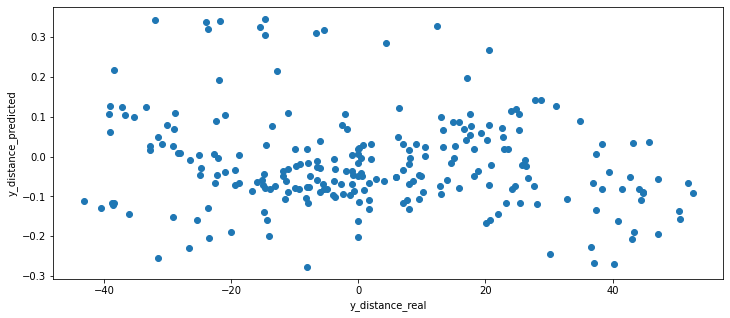

(737, 1)
(737, 1)


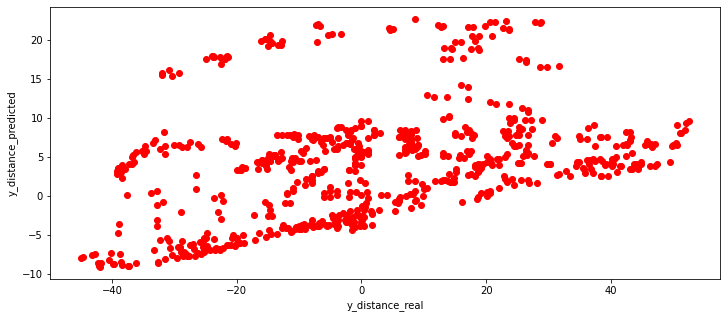

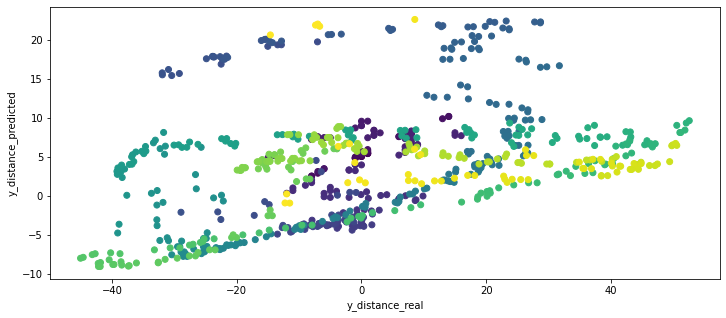

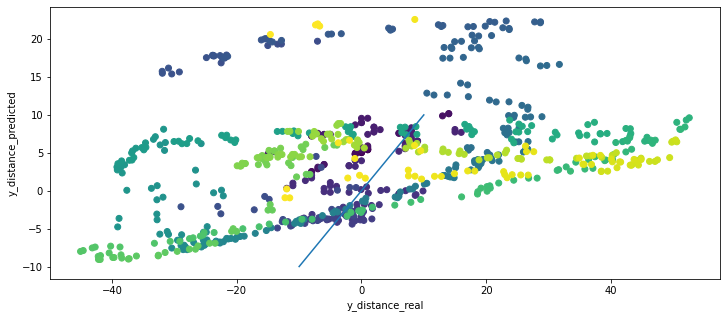

 --- plot predcition --- 


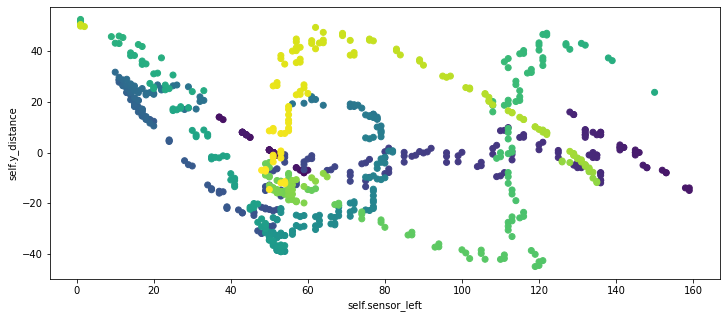

Streaming output truncated to the last 5000 lines.
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  288
Sensor from left wall =  48
Sensor from right wall =  3
most távolsagra van a felső faltól =  100.82972378371323
most távolsagra van az alsó faltól =  0.8297237837132343
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  779
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle = 

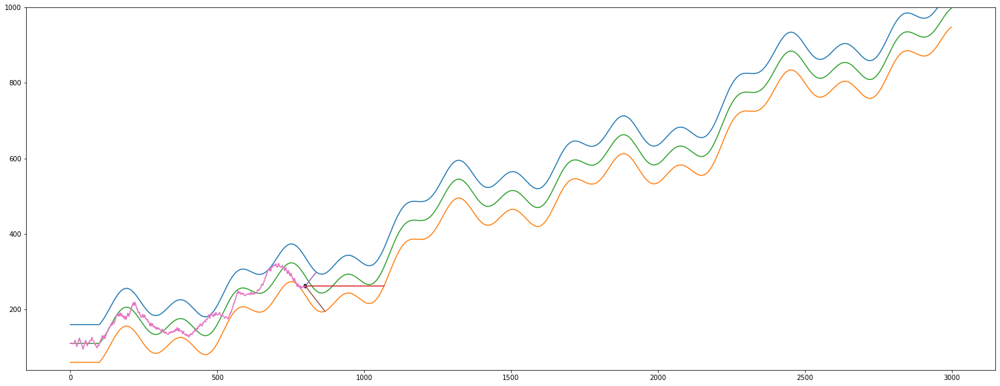

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  2.677598746717763
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  2.677598746717763
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  811
			 len(self.sensor_left)   =  811
			 len(self.sensor_center) =  811
			 len(self.sensor_right)  =  811
			 self.x                  =  811
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  812
			 len(self.sensor_left)   =  812
			 len(self.sensor_center) =  812
			 len(self.sensor_right)  =  812
			 self.x                  =  811
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  811
# 2. az 1. pontban megtanult modell alapján 

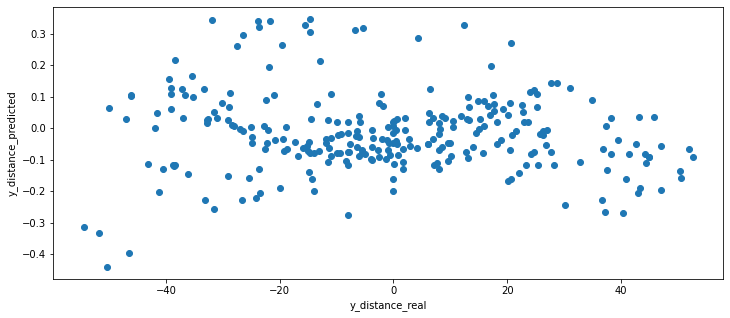

(833, 1)
(833, 1)


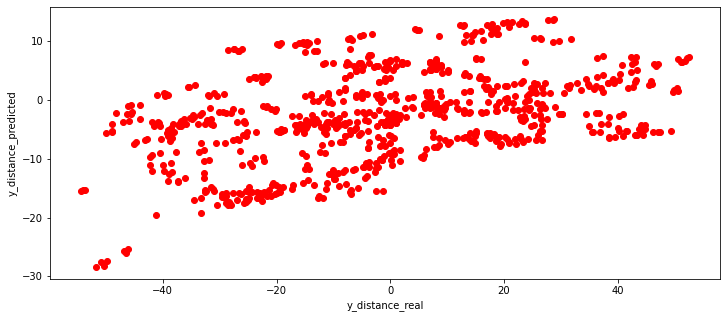

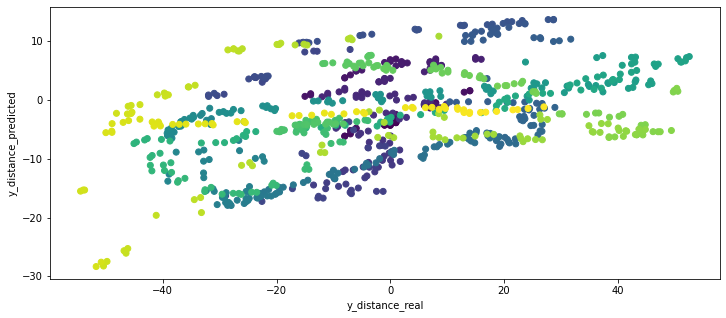

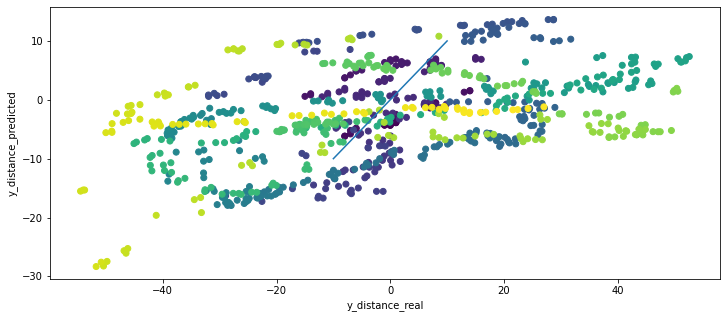

 --- plot predcition --- 


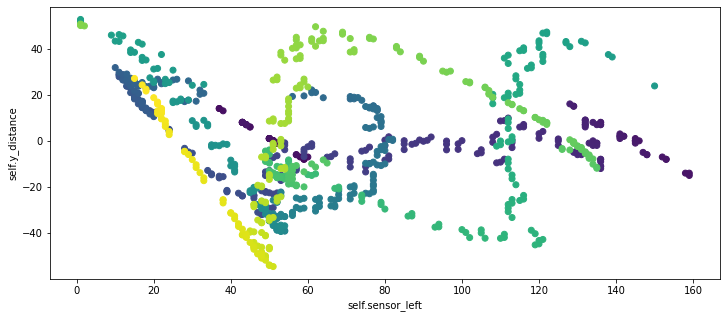

Streaming output truncated to the last 5000 lines.
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 20 220  54]]
actual predicted =  [-0.01676225]
actual self.y_distance[-1] =  38.30283458717463
len(self.y_distance_real)      =  280
len(self.y_distance_predicted) =  280
(860, 1)
(860, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
282.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

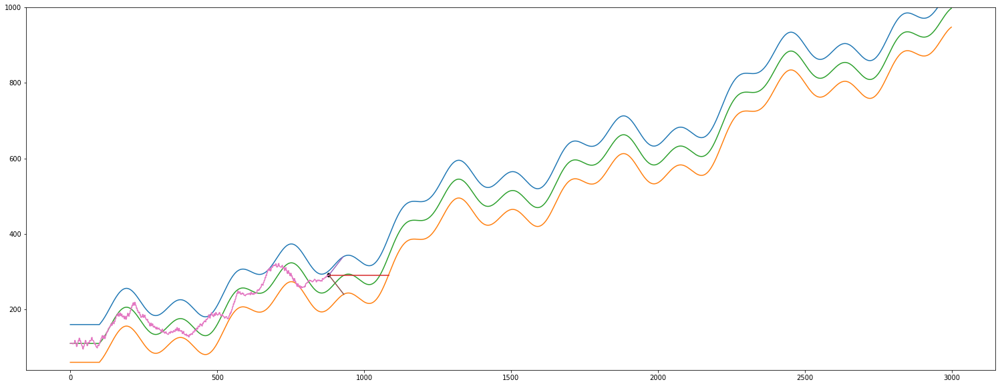

Streaming output truncated to the last 5000 lines.
		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  7
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[46  7]]
		 _X_center =  [[182   7]]
		 _X_right  =  [[61  7]]
		 predicted_left   =  [[31.79653275]]
		 predicted_center =  [[158.08089277]]
		 predicted_right  =  [[72.20832611]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.97014459 -1.83287403]]
		 regression_center.coef_ =  [[ 0.96561978 -2.52312961]]
		 regression_right.coef_  =  [[0.95028485 2.0344215 ]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 31.79653275 158.08089277  72.20832611]]
		 ----------------------

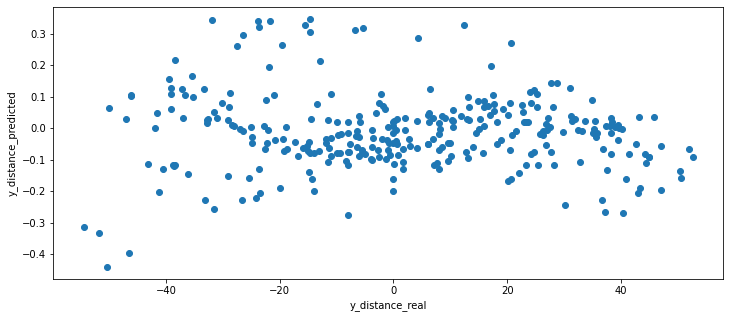

(929, 1)
(929, 1)


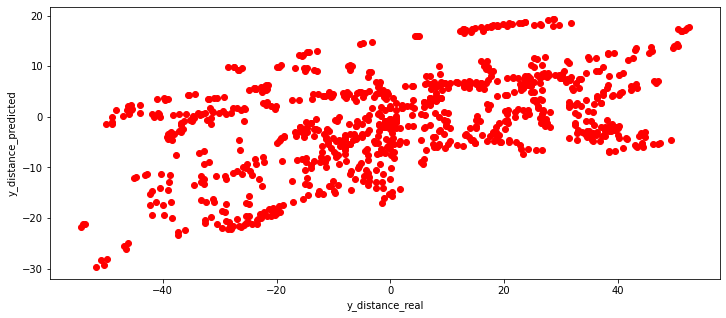

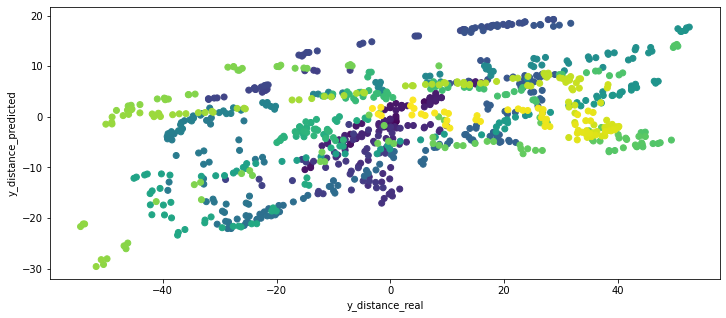

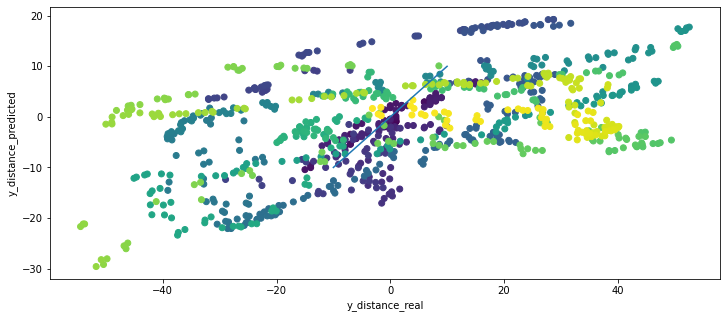

 --- plot predcition --- 


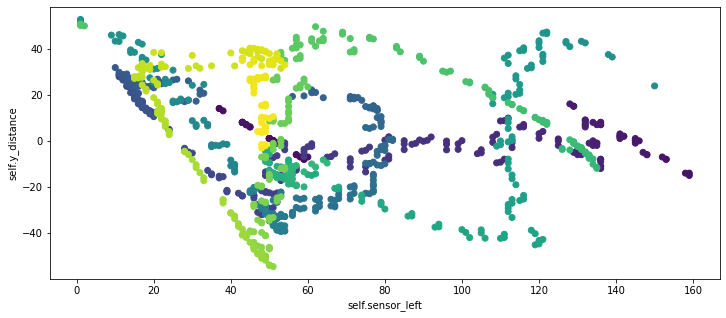

Streaming output truncated to the last 5000 lines.
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  140
Sensor from left wall =  49
Sensor from right wall =  58
most távolsagra van a felső faltól =  63.716239338881735
most távolsagra van az alsó faltól =  36.283760661118265
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  938
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -13.716239338881735
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogju

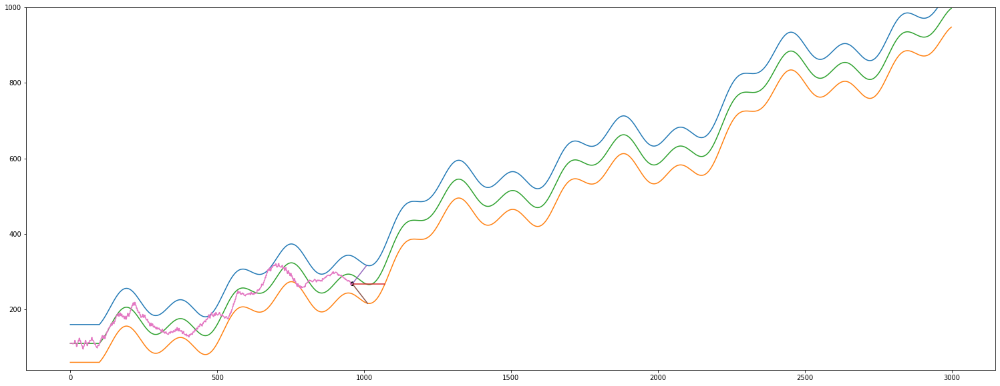

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  -1.5362821012731729
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1004
			 len(self.sensor_left)   =  1004
			 len(self.sensor_center) =  1004
			 len(self.sensor_right)  =  1004
			 self.x                  =  1004
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1005
			 len(self.sensor_left)   =  1005
			 len(self.sensor_center) =  1005
			 len(self.sensor_right)  =  1005
			 self.x                  =  1004
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1004
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  67
Sen

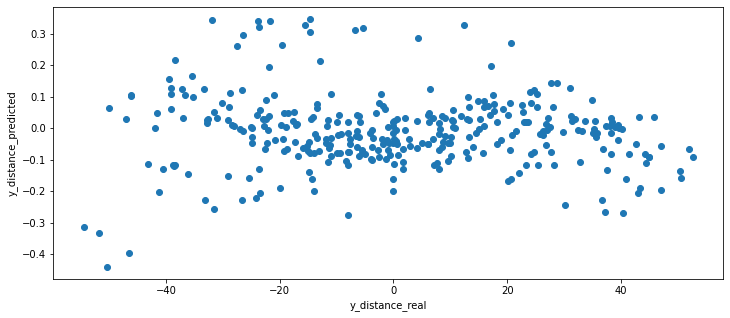

(1025, 1)
(1025, 1)


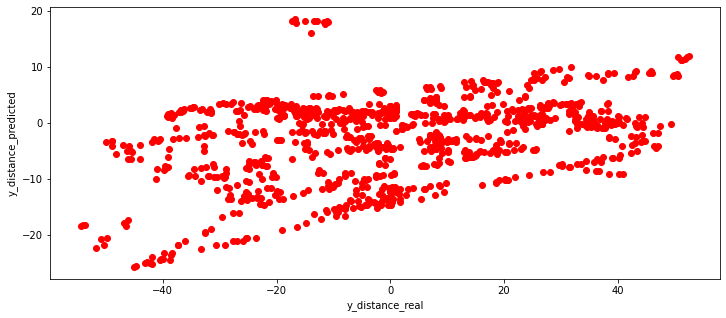

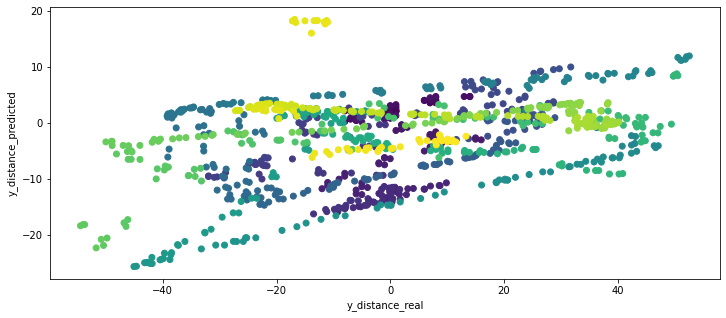

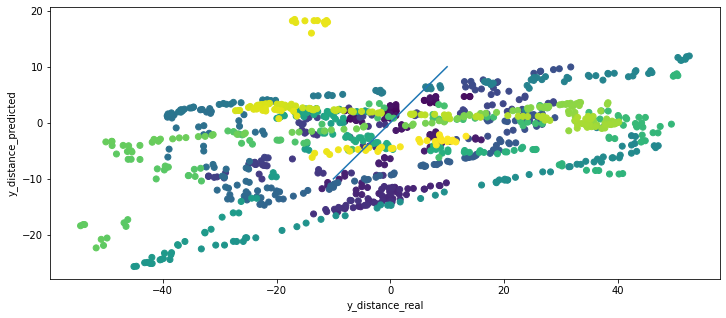

 --- plot predcition --- 


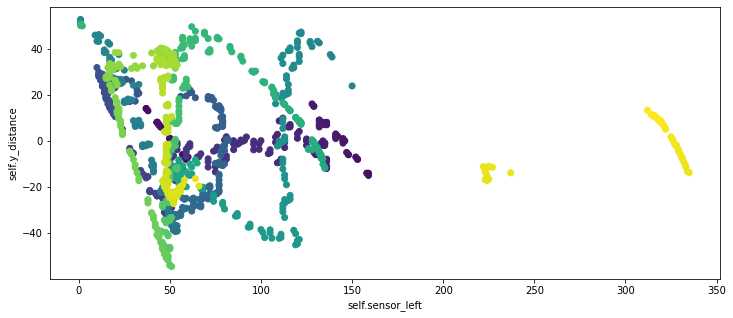

len(self.sensor_left) =  1025
len(self.y_distance) =  1025
(1025, 1)
(1025, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
280.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  53
Sensor from left wall =  312
Sensor from right wall =  34
most távolsagra van a felső faltól =  36.92084203445722
most tá

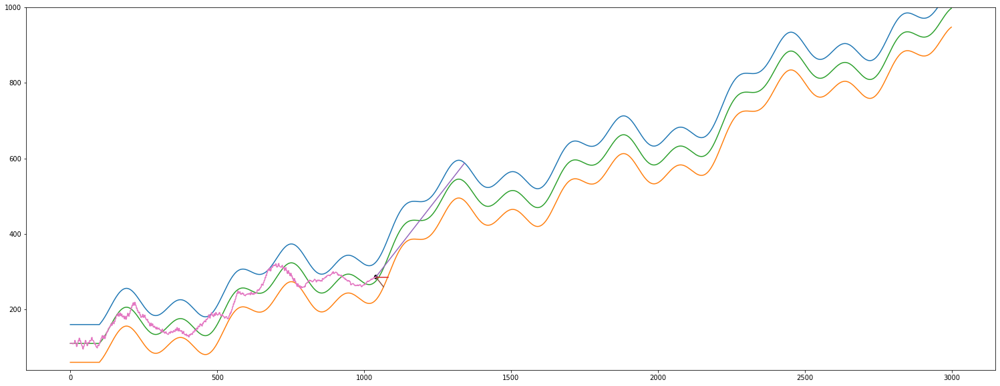

Streaming output truncated to the last 5000 lines.
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[-0.82974572]]
-------- 1 y up ->  center =  [[-1.34997535]]
-------- 1 y up ->  right  =  [[2.89255003]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -7
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[249  -7]]
		 _X_center =  [[ 6 -7]]
		 _X_right  =  [[ 4 -7]]
		 predicted_left   =  [[260.21277395]]
		 predicted_center =  [[22.01754437]]
		 predicted_right  =  [[-9.74336925]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99376779 -1.82351351]]
		 regression_center.coef_ =  [[ 0.96674745 -2.31672281]]
		 regression_right.coef_  =  [[0.95495282 1.93759722]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0

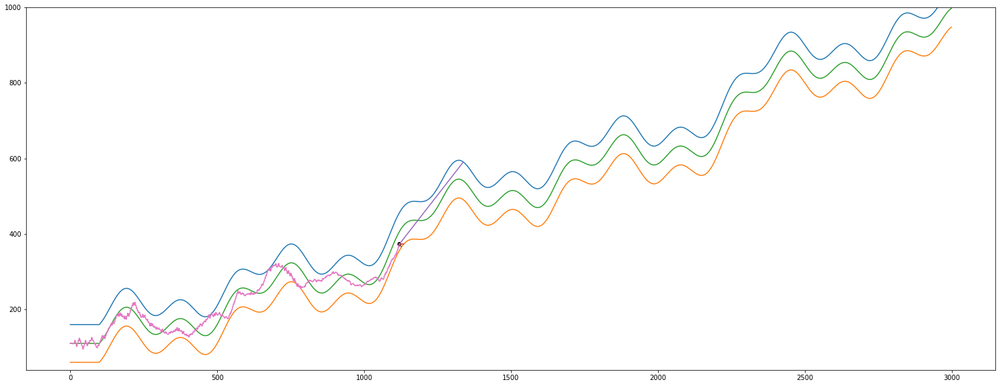

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1120
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[218  16   8]]
actual predicted =  [-0.20628626]
actual self.y_distance[-1] =  -33.10639266711519
len(self.y_distance_real)      =  367
len(self.y_distance_predicted) =  367


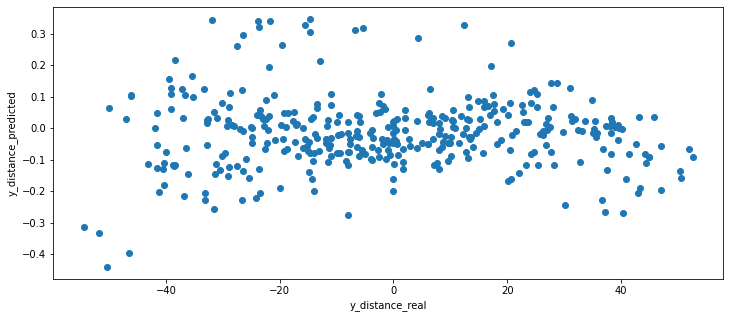

(1121, 1)
(1121, 1)


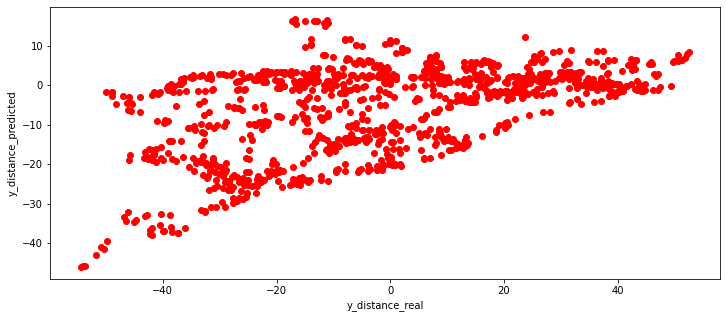

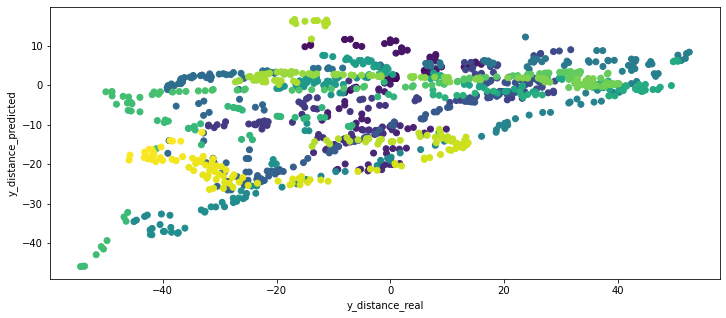

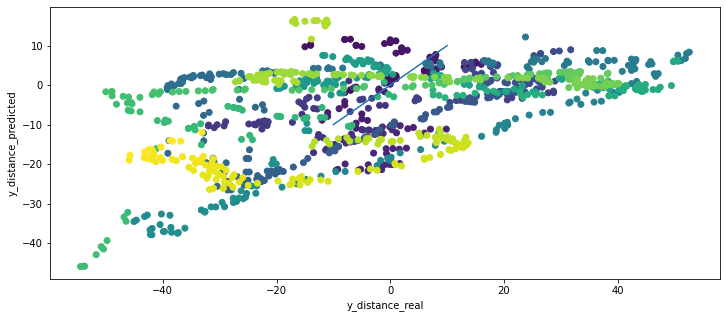

 --- plot predcition --- 


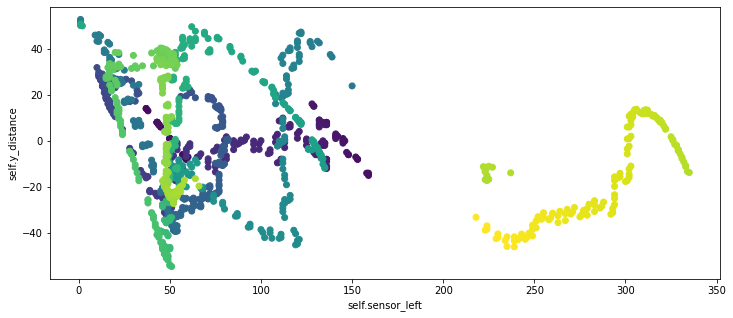

Streaming output truncated to the last 5000 lines.
X.max =  400
X.min =  1
y.max =  52.588642433442544
y.min =  -54.465209698709714
---------------------
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 390, loss = 0.07810281
Validation score: 0.294131
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_left.coef_ =  [[ 0.99616022 -1.77301216]]
		 regression_left.intercept_ =  0.0
		 -------------------

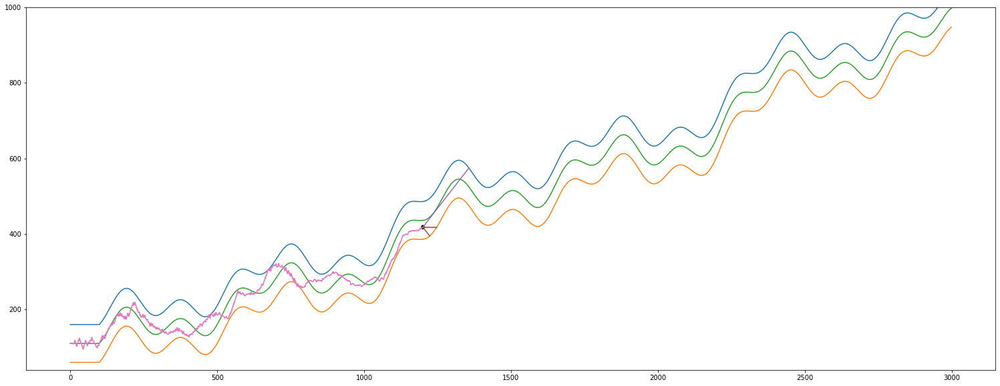

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1200
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1201, 3)
y.shape =  (1201, 1)
i       =  1200
---------------------
X.max =  400
X.min =  1
y.max =  52.588642433442544
y.min =  -54.465209698709714
---------------------
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 397, loss = 0.07679018
Validation score: 0.303063
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -----------------

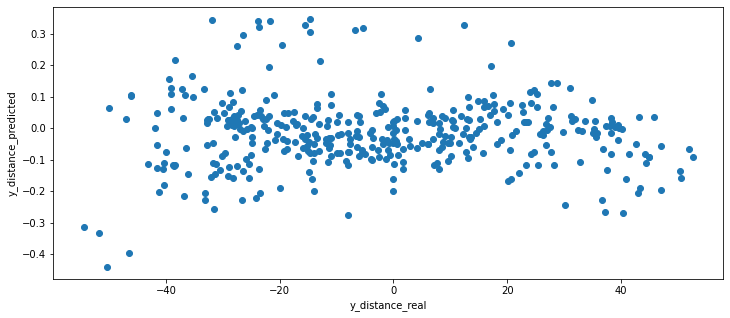

(1217, 1)
(1217, 1)


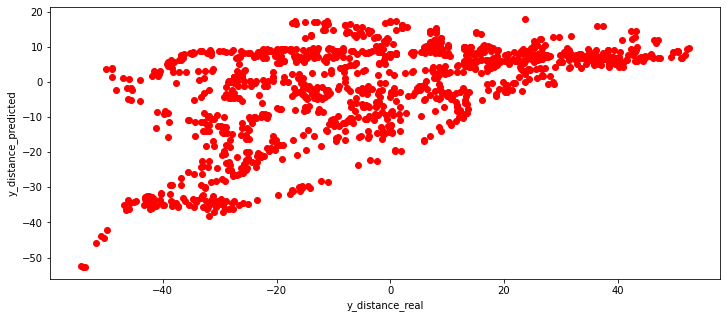

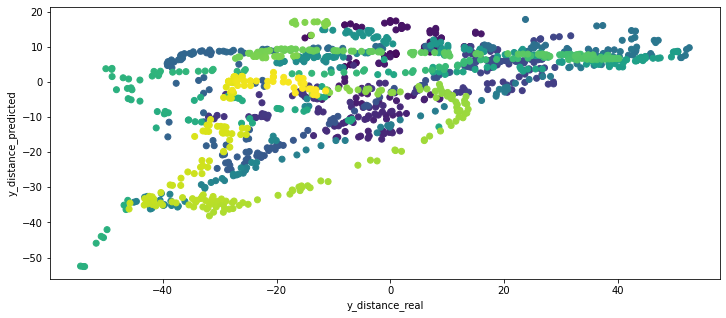

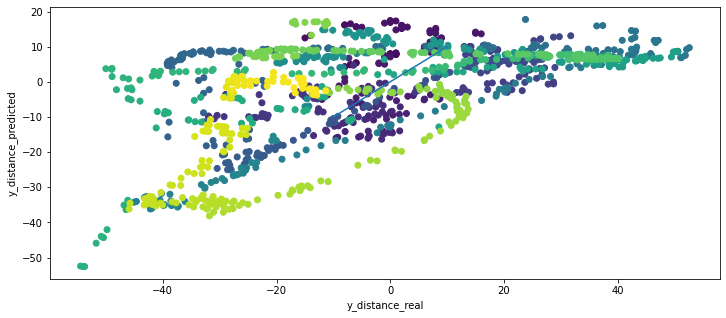

 --- plot predcition --- 


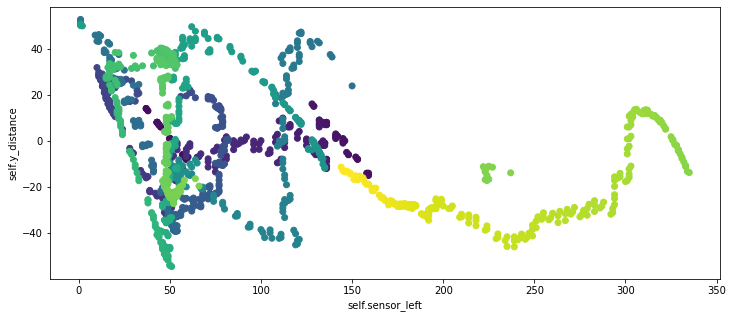

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  21.174254575675832
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  21.174254575675832
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1259
			 len(self.sensor_left)   =  1259
			 len(self.sensor_center) =  1259
			 len(self.sensor_right)  =  1259
			 self.x                  =  1259
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1260
			 len(self.sensor_left)   =  1260
			 len(self.sensor_center) =  1260
			 len(self.sensor_right)  =  1260
			 self.x                  =  1259
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1259
# 3. véletlenszerűen változtato

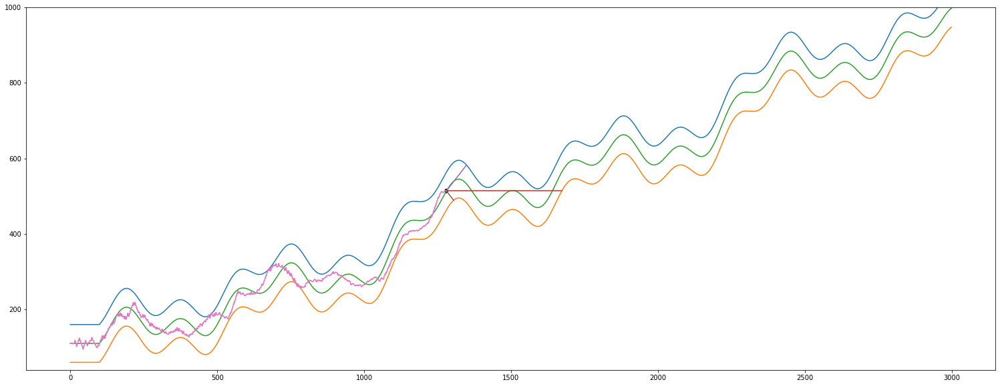

Streaming output truncated to the last 5000 lines.
self.x                       =  1290
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -3.883019449303447
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  -3.883019449303447
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1291
			 len(self.sensor_left)   =  1291
			 len(self.sensor_center) =  1291
			 len(self.sensor_right)  =  1291
			 self.x                  =  1290
			 -------------- Teszt End --------------
self.y új értéke   =  522.0
action             =  2
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self

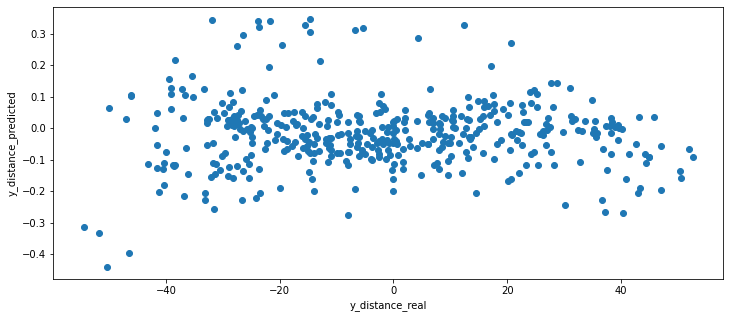

(1313, 1)
(1313, 1)


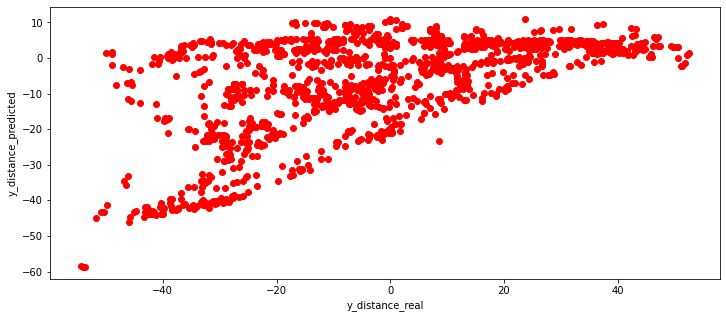

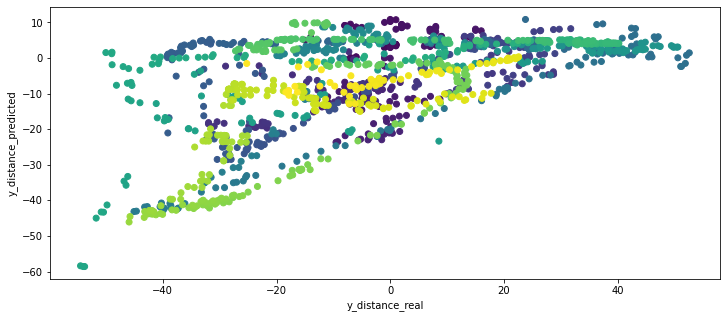

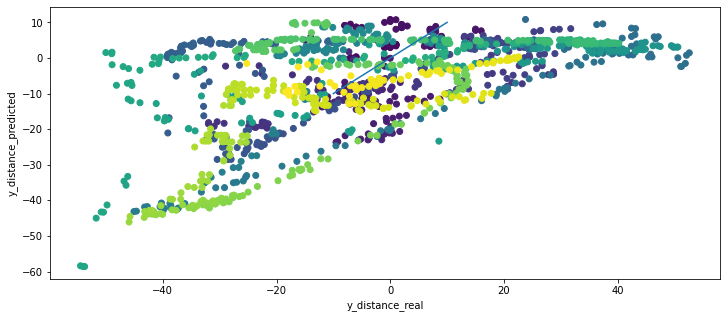

 --- plot predcition --- 


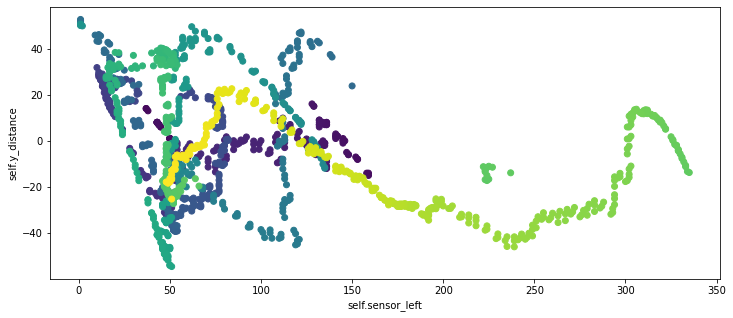

Streaming output truncated to the last 5000 lines.
		 ---------------------
		  action =  7
		  predicted_position =  [[-26.51463795]]
		  absolute distance from 0 (tmp) =  [[26.51463795]]
		 ---------------------
		 adott j-re 7 kiszámoltuk az előrejelzést de még nem hoztunk döntést -----------------------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------
	 minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  490.0
Sensor center =  325
Sensor from left wall =  47
Sensor from right wall =  74
most távolsagra van a felső faltól =  93.51645925530158
most távolsagra van az alsó faltól =  6.483540744

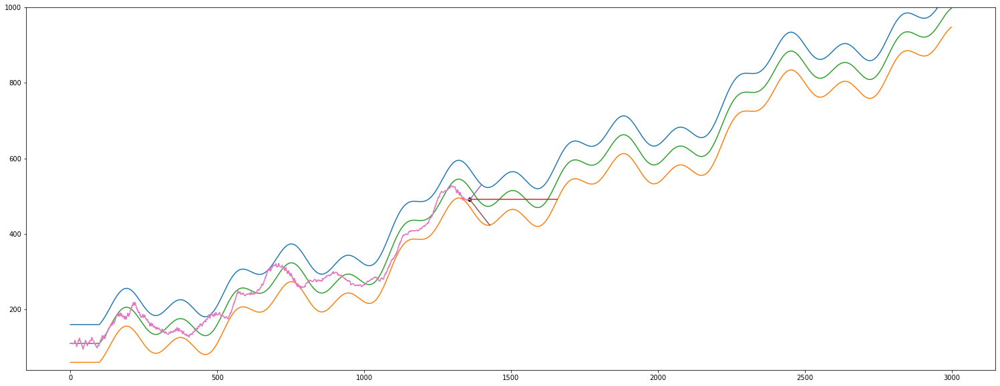

Streaming output truncated to the last 5000 lines.
		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  7
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[24  7]]
		 _X_center =  [[280   7]]
		 _X_right  =  [[67  7]]
		 predicted_left   =  [[12.52761591]]
		 predicted_center =  [[260.59797098]]
		 predicted_right  =  [[78.27459724]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99686717 -1.62817089]]
		 regression_center.coef_ =  [[ 0.97647271 -1.83062692]]
		 regression_right.coef_  =  [[0.94559356 2.13140413]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 12.52761591 260.59797098  78.27459724]]
		 ----------------------

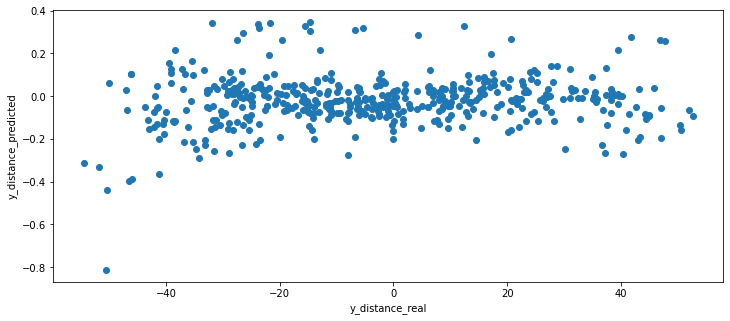

(1409, 1)
(1409, 1)


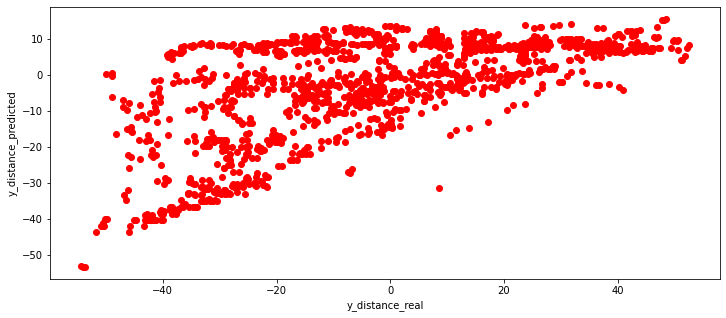

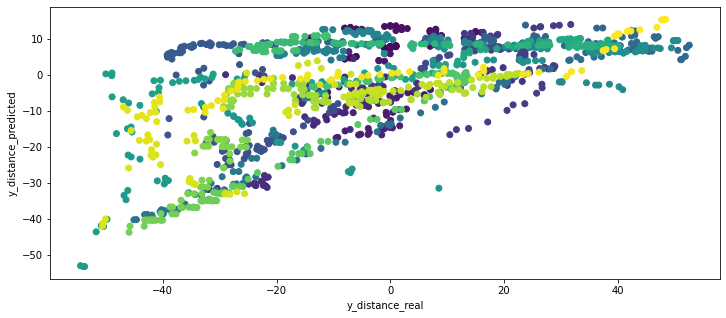

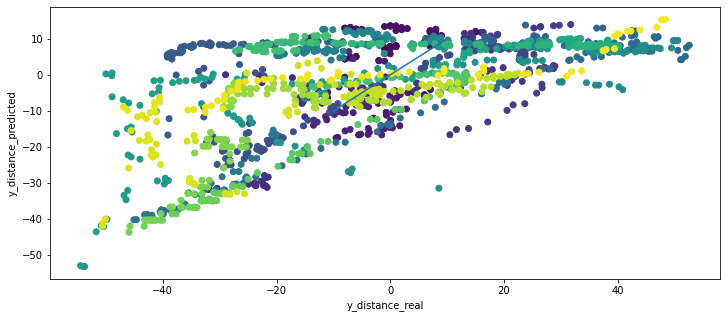

 --- plot predcition --- 


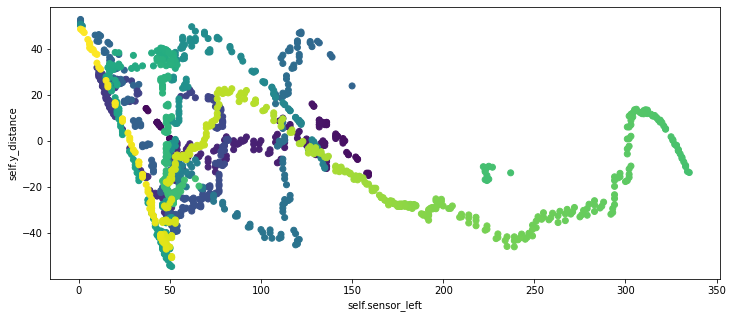

Streaming output truncated to the last 5000 lines.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  27.38393132306703
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  27.38393132306703
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1417
			 len(self.sensor_left)   =  1417
			 len(self.sensor_center) =  1417
			 len(self.sensor_right)  =  1417
			 self.x                  =  1416
			 -------------- Teszt End --------------
self.y új értéke   =  501.0
action             =  -7
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
501.0
# 		 ----------------- Summ

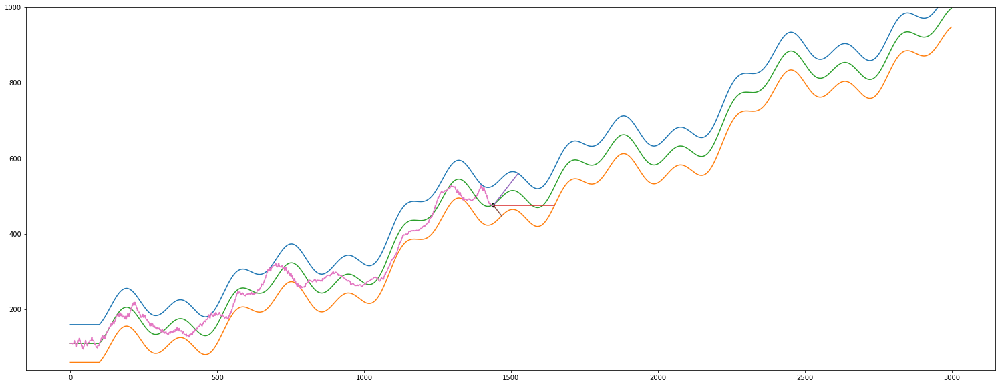

Streaming output truncated to the last 5000 lines.
		 _X_right  =  [[40  7]]
		 predicted_left   =  [[42.66198039]]
		 predicted_center =  [[162.87701763]]
		 predicted_right  =  [[52.21916963]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99688846 -1.59571379]]
		 regression_center.coef_ =  [[ 0.97757134 -2.14870939]]
		 regression_right.coef_  =  [[0.94901587 2.03693357]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 42.66198039 162.87701763  52.21916963]]
		 -------------------------X_scaled------------------
		  [[-0.75052706 -0.18858638 -0.16034148]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model          

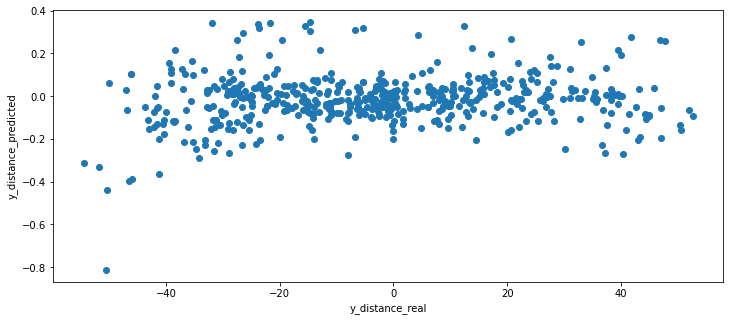

(1505, 1)
(1505, 1)


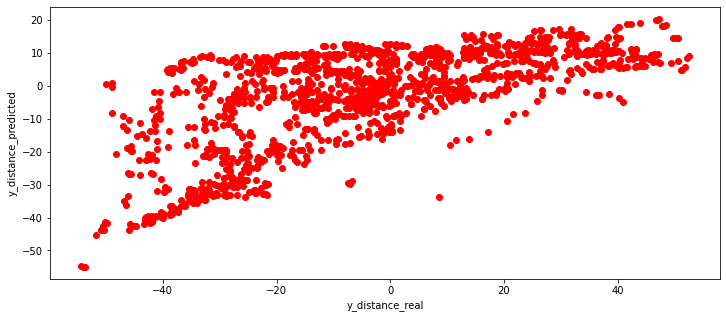

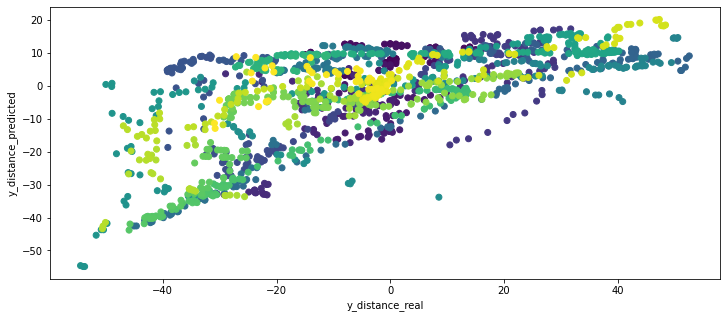

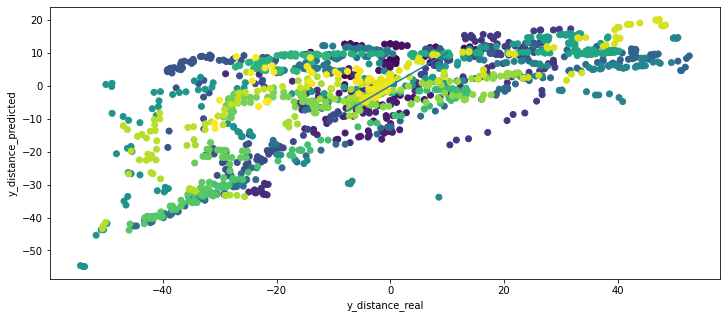

 --- plot predcition --- 


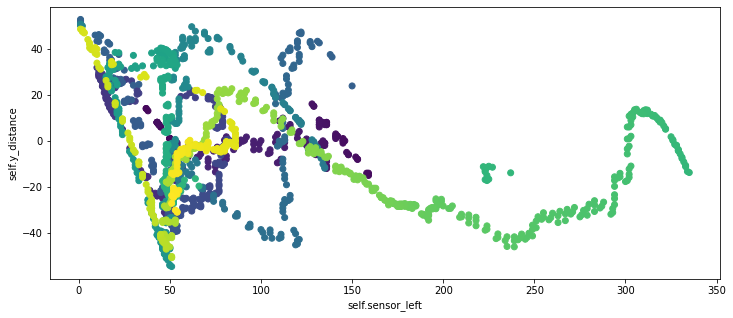

len(self.sensor_left) =  1505
len(self.y_distance) =  1505
(1505, 1)
(1505, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
488.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  152
Sensor from left wall =  50
Sensor from right wall =  56
most távolsagra van a felső faltól =  77.12345135401961
most tá

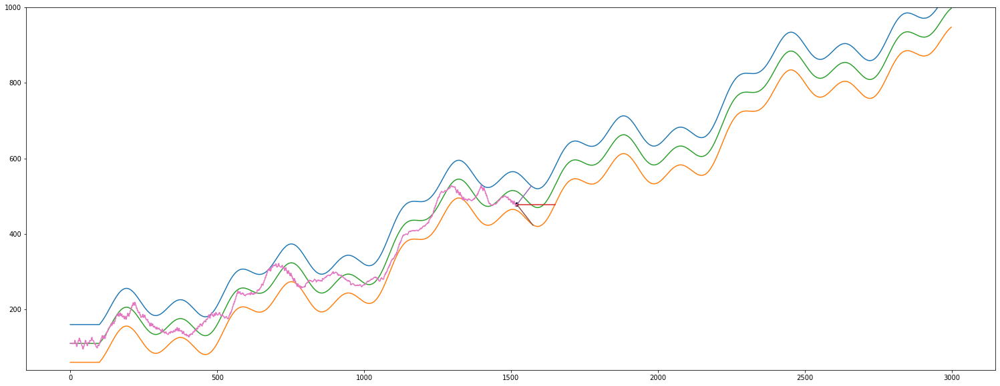

Streaming output truncated to the last 5000 lines.
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  -17.841276871776017
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1580
			 len(self.sensor_left)   =  1580
			 len(self.sensor_center) =  1580
			 len(self.sensor_right)  =  1580
			 self.x                  =  1580
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1581
			 len(self.sensor_left)   =  1581
			 len(self.sensor_center) =  1581
			 len(self.sensor_right)  =  1581
			 self.x                  =  1580
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1580
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  55
Sensor from left wall =  182
Sensor from right wall =  29
most t

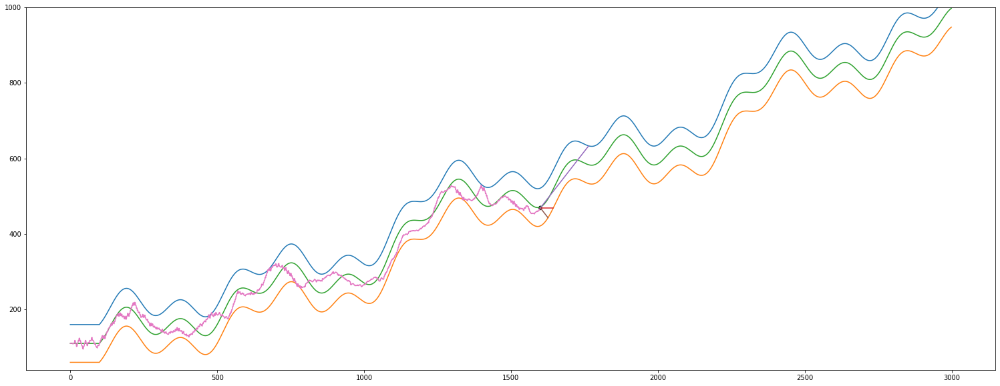

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1600
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[165  45  27]]
actual predicted =  [-0.0794766]
actual self.y_distance[-1] =  -2.4970587966594167
len(self.y_distance_real)      =  527
len(self.y_distance_predicted) =  527


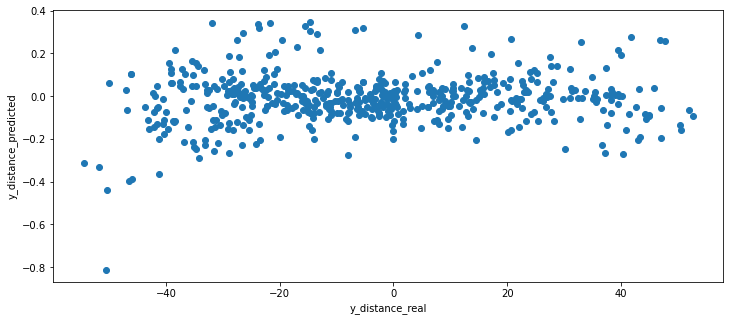

(1601, 1)
(1601, 1)


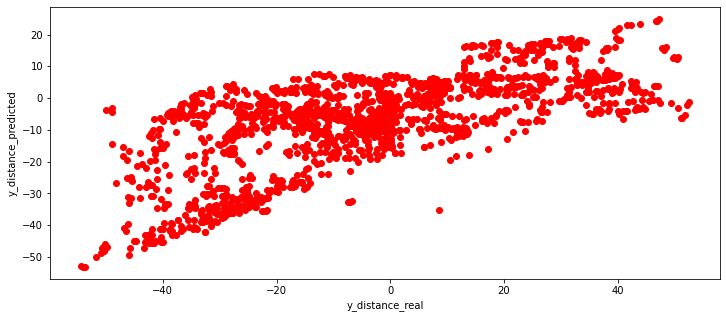

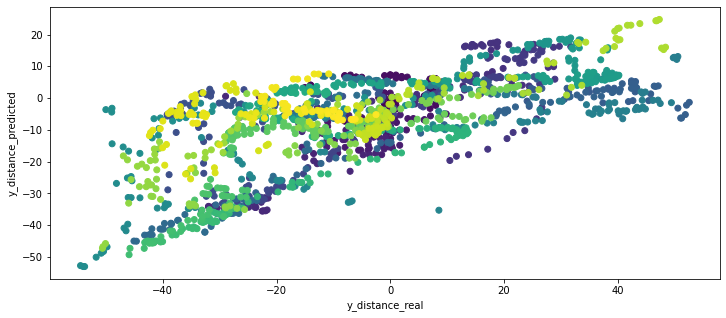

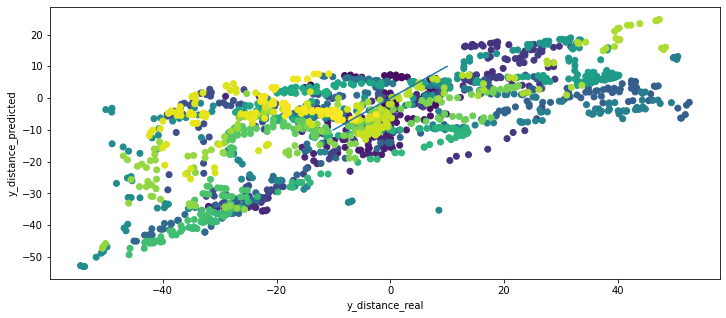

 --- plot predcition --- 


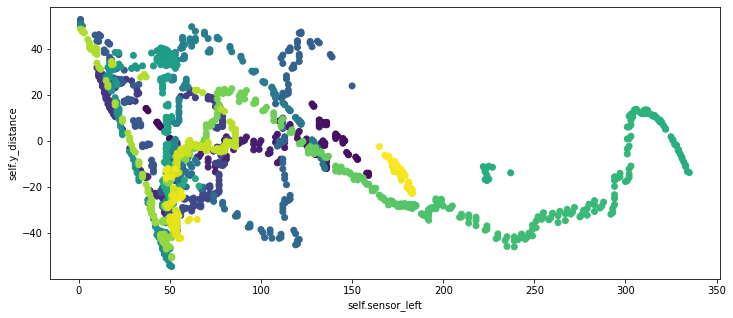

Streaming output truncated to the last 5000 lines.
		 predicted_center =  [[39.01339206]]
		 predicted_right  =  [[11.02460177]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99772793 -1.55319571]]
		 regression_center.coef_ =  [[ 0.97778168 -1.9229383 ]]
		 regression_right.coef_  =  [[0.95016688 2.02613405]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[104.43238029  39.01339206  11.02460177]]
		 -------------------------X_scaled------------------
		  [[-0.38064443 -0.80945668 -0.83566227]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-6.61488075]]
		 predicted_position neural net model scaled

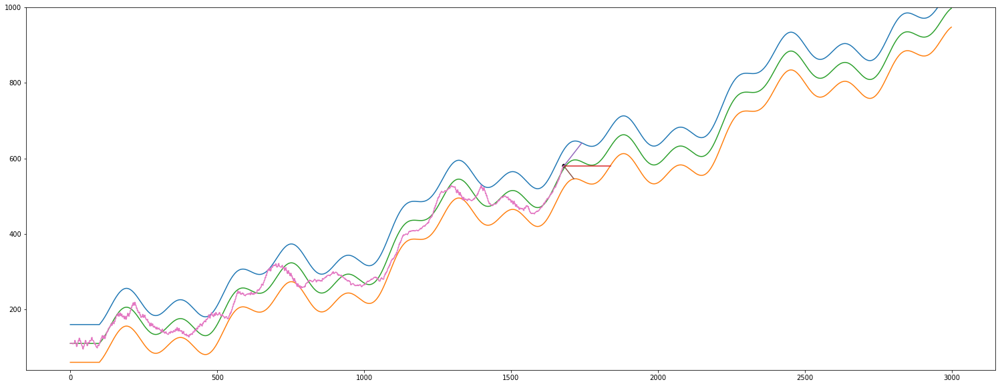

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1680
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1681, 3)
y.shape =  (1681, 1)
i       =  1680
---------------------
X.max =  400
X.min =  1
y.max =  52.588642433442544
y.min =  -54.465209698709714
---------------------
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 557, loss = 0.04944775
Validation score: 0.558055
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -----------------

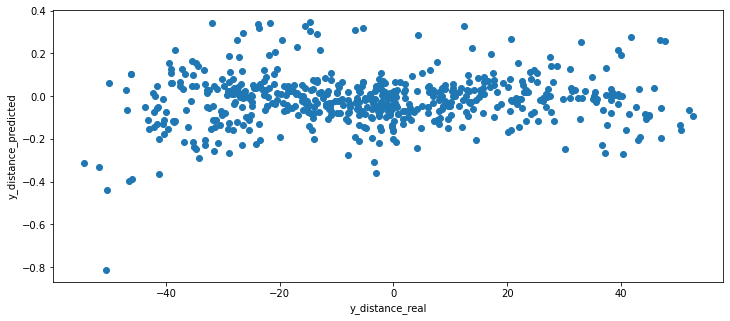

(1697, 1)
(1697, 1)


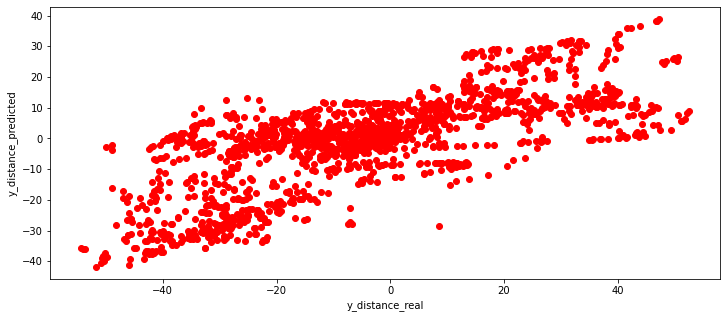

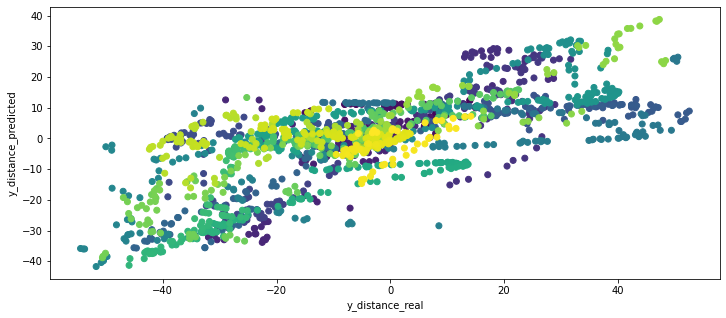

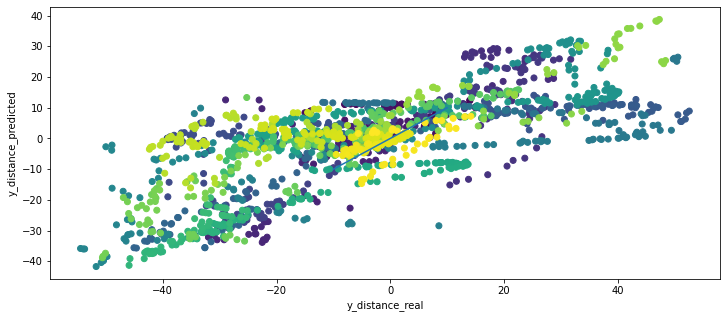

 --- plot predcition --- 


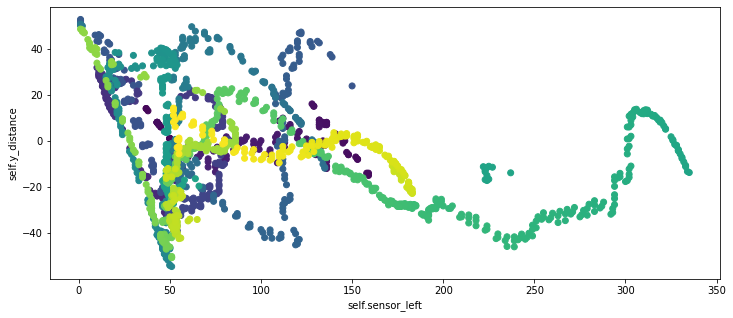

Streaming output truncated to the last 5000 lines.
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
591.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  110
Sensor from left wall =  42
Sensor from right wall =  55
most távolsagra van a felső faltól =  51.005021217534704
most távolsagra van az alsó faltól

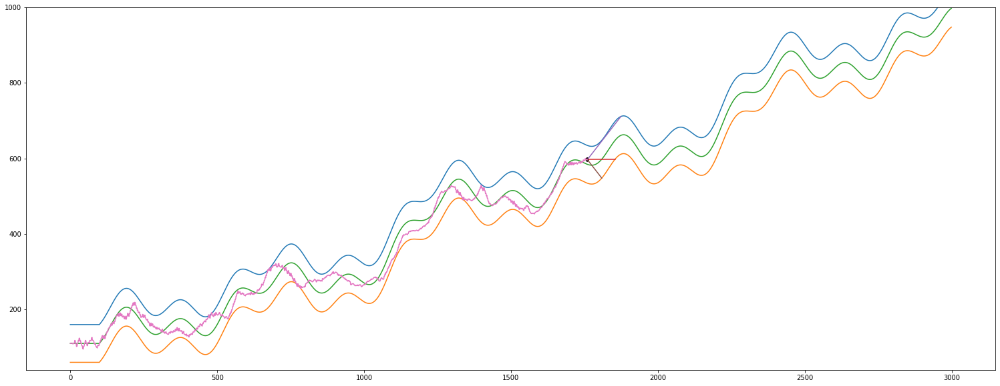

Streaming output truncated to the last 5000 lines.
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-2.64025212]]
		 predicted_position neural net model scaled =  [0.00389742]
		 predicted_position neural net model inverz =  [[-0.72966688]]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  3
		  predicted_position =  [[-0.72966688]]
		  absolute distance from 0 (tmp) =  [[0.72966688]]
		 ---------------------
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -----------------------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és 

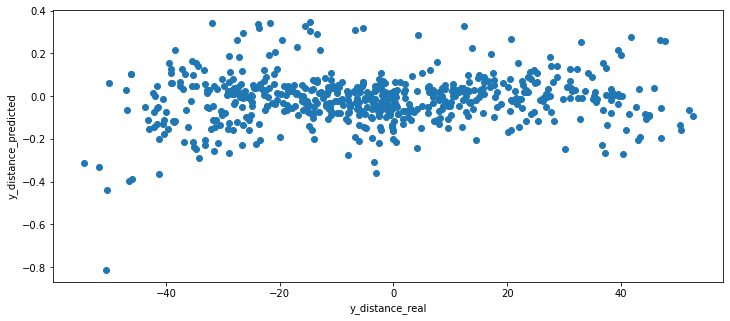

(1793, 1)
(1793, 1)


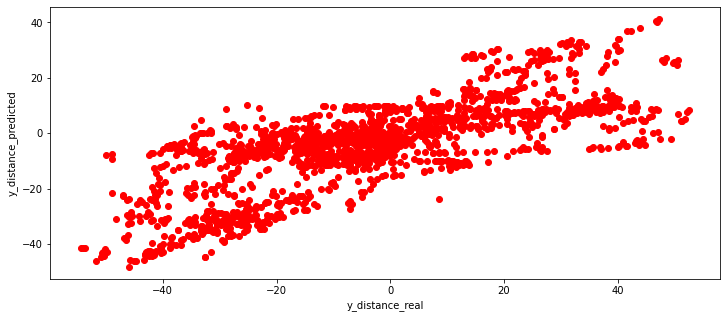

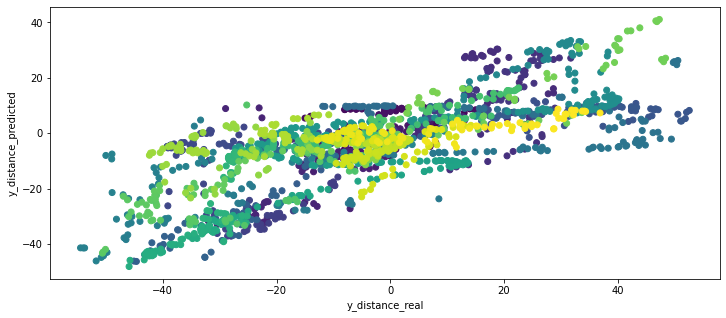

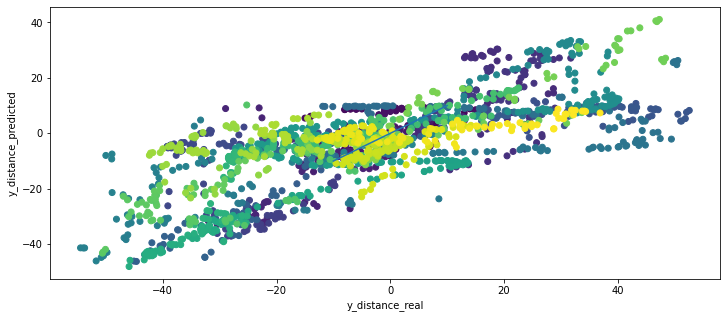

 --- plot predcition --- 


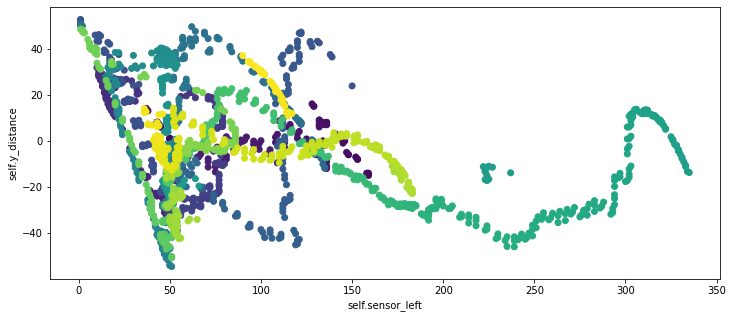

Streaming output truncated to the last 5000 lines.
		 j =  7
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[71  7]]
		 _X_center =  [[146   7]]
		 _X_right  =  [[41  7]]
		 predicted_left   =  [[60.26398886]]
		 predicted_center =  [[131.35715396]]
		 predicted_right  =  [[52.68537919]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99745561 -1.50790846]]
		 regression_center.coef_ =  [[ 0.97911557 -1.65624568]]
		 regression_right.coef_  =  [[0.95230246 1.94871122]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 60.26398886 131.35715396  52.68537919]]
		 -------------------------X_scaled------------------
		  [[-0.64512582 -0.34658068 -0.1526987 ]]
		 ---------------Bru

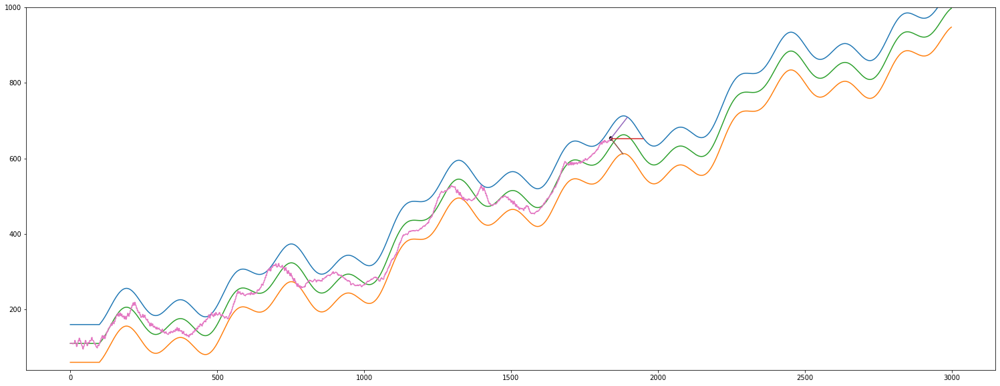

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  17.075660449579004
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  17.075660449579004
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1867
			 len(self.sensor_left)   =  1867
			 len(self.sensor_center) =  1867
			 len(self.sensor_right)  =  1867
			 self.x                  =  1867
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1868
			 len(self.sensor_left)   =  1868
			 len(self.sensor_center) =  1868
			 len(self.sensor_right)  =  1868
			 self.x                  =  1867
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1867
# 2. az 1. pontban megtanult mo

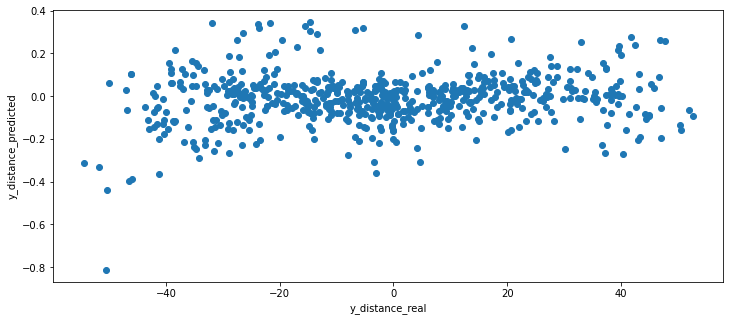

(1889, 1)
(1889, 1)


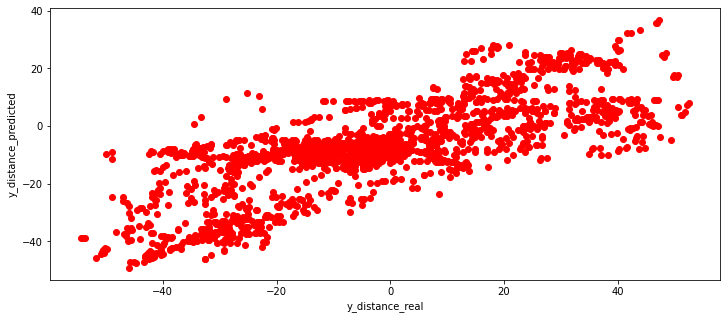

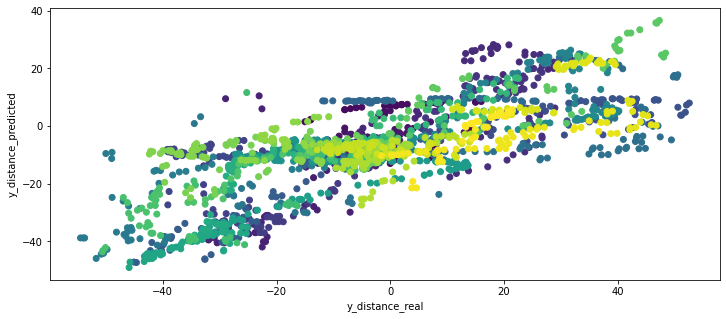

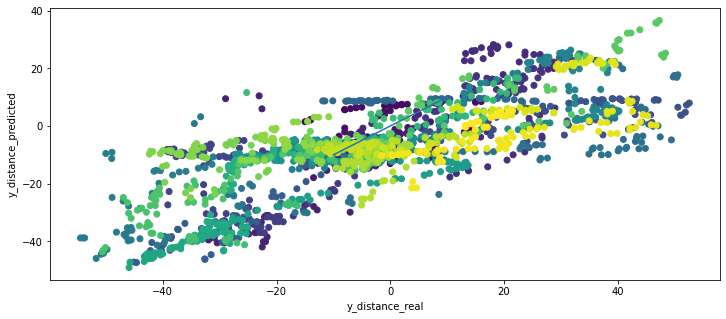

 --- plot predcition --- 


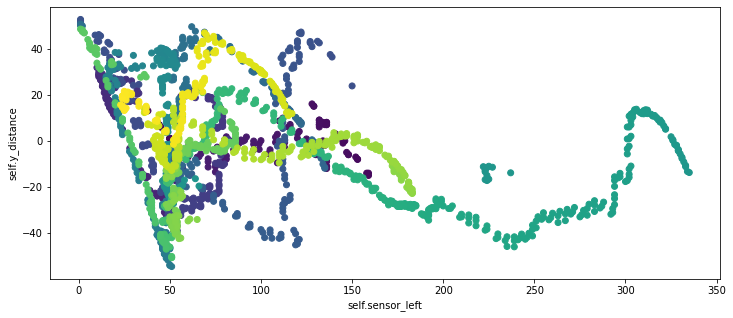

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  1899
			 len(self.sensor_right)  =  1899
			 self.x                  =  1898
			 -------------- Teszt End --------------
self.y =  666.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
666.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
S

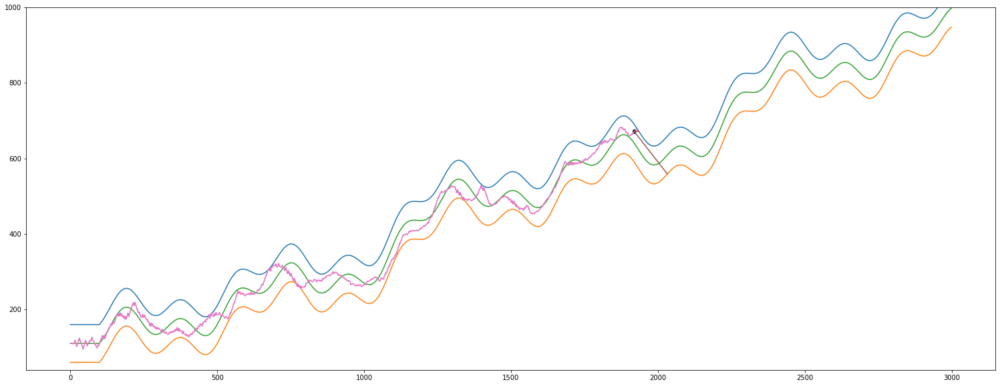

Streaming output truncated to the last 5000 lines.
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ -7.76691331  -8.68716666 132.24185842]]
		 -------------------------X_scaled------------------
		  [[-1.05249649 -1.04855723  0.88837206]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[32.24821258]]
		 predicted_position neural net model scaled =  [0.34529078]
		 predicted_position neural net model inverz =  [[57.60587068]]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 6 kiszámoltuk az előrejelzést de még nem hoztunk döntést -----------------------------------------------------------------
		 ----------------------------------------------------------

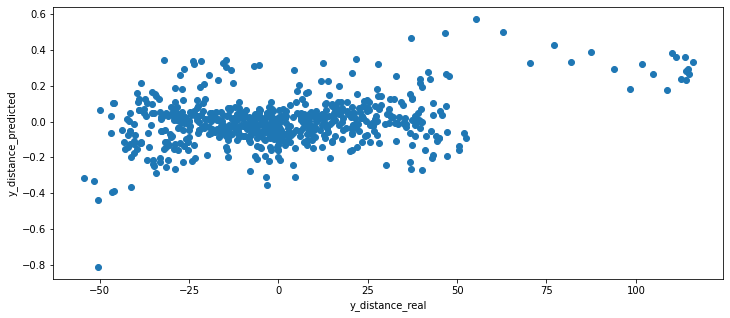

(1985, 1)
(1985, 1)


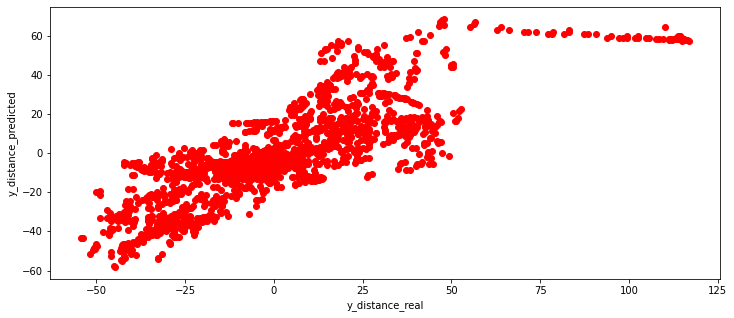

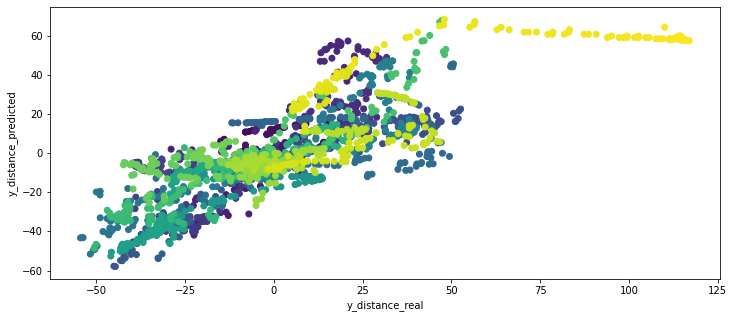

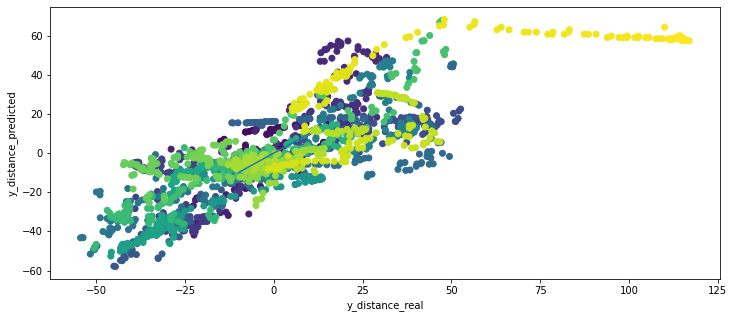

 --- plot predcition --- 


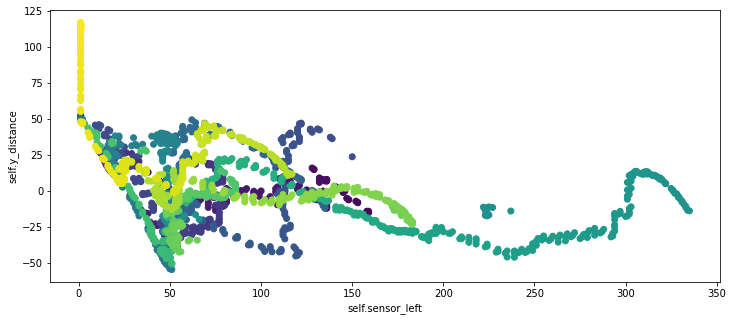

len(self.sensor_left) =  1985
len(self.y_distance) =  1985
(1985, 1)
(1985, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
693.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  1
Sensor from left wall =  1
Sensor from right wall =  120
most távolsagra van a felső faltól =  60.14429354837989
most távo

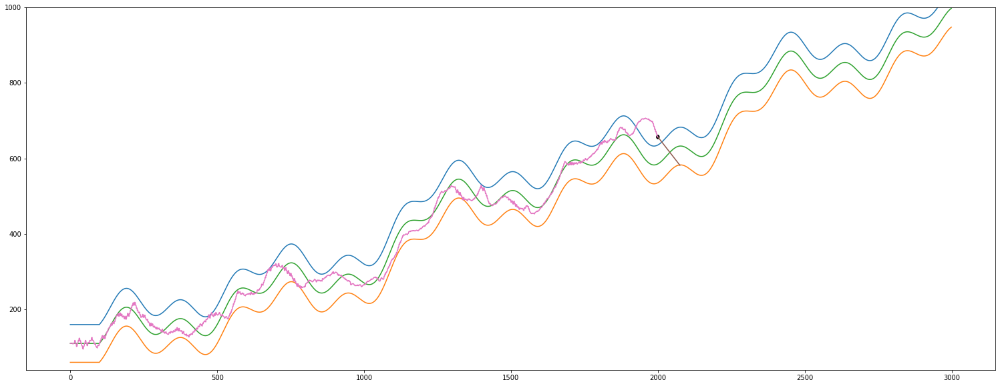

Streaming output truncated to the last 5000 lines.
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -----------------------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  4
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[46  4]]
		 _X_center =  [[156   4]]
		 _X_right  =  [[69  4]]
		 predicted_left   =  [[40.25029944]]
		 predicted_center =  [[146.43684861]]
		 predicted_right  =  [[74.37918647]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99702281 -1.40318742]]
		 regression_center.coef_ =  [[ 0.97979999 -1.60298743]]
		 regression_right.coef_  =  [[0.96902966 1.87903502]]
		 regress

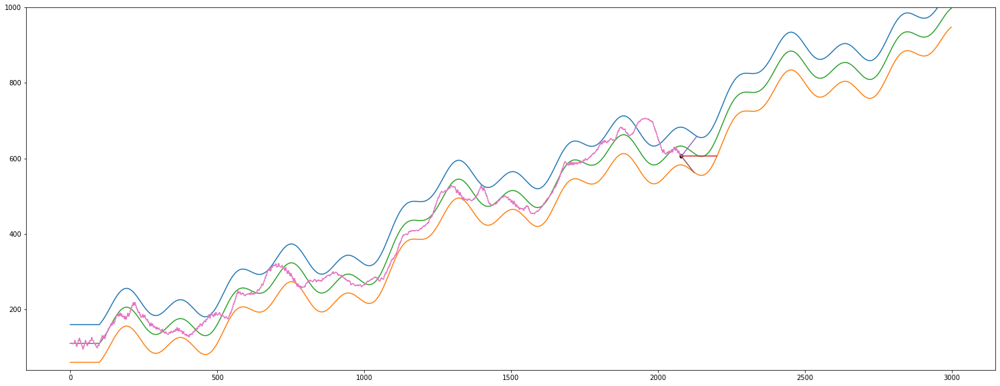

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2080
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 53 122  44]]
actual predicted =  [-0.4055022]
actual self.y_distance[-1] =  -26.865885873920206
len(self.y_distance_real)      =  687
len(self.y_distance_predicted) =  687


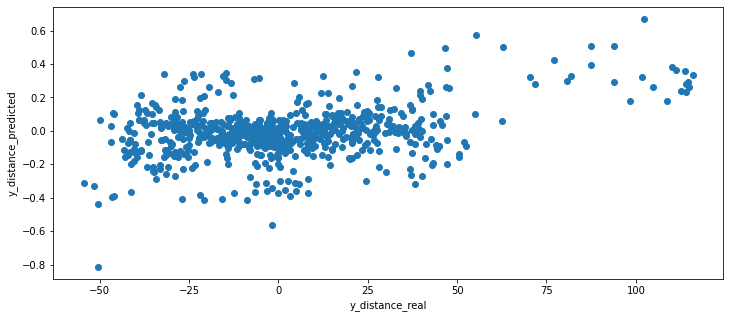

(2081, 1)
(2081, 1)


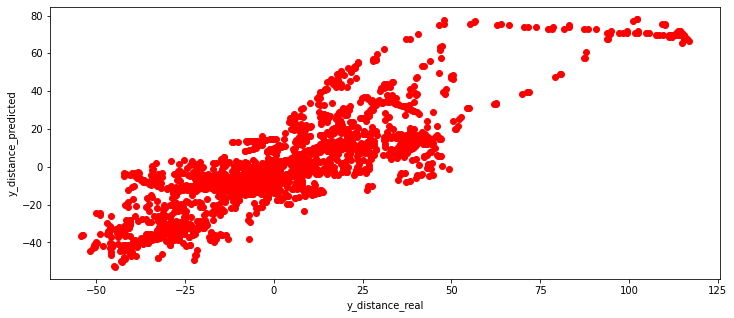

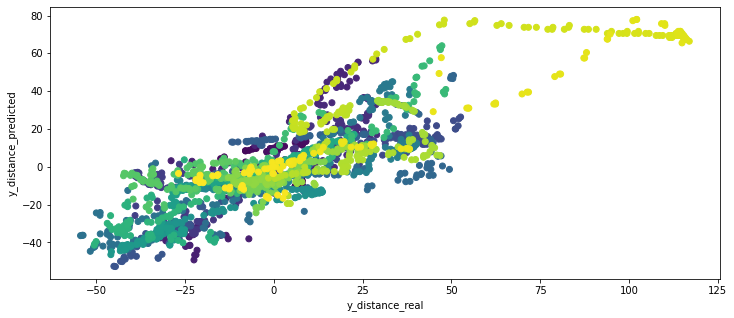

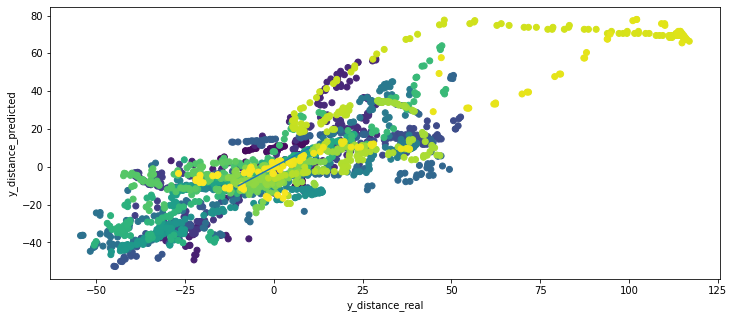

 --- plot predcition --- 


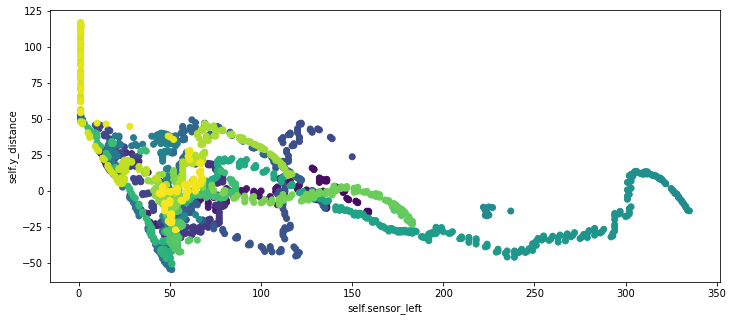

Streaming output truncated to the last 5000 lines.
Iteration 710, loss = 0.01838076
Validation score: 0.706384
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_left.coef_ =  [[ 0.99309406 -1.43454135]]
		 regression_left.intercept_ =  0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.97989191 -1.52208196]]
		 regression_center.intercept_ 0.0
		 ------------------------------- v

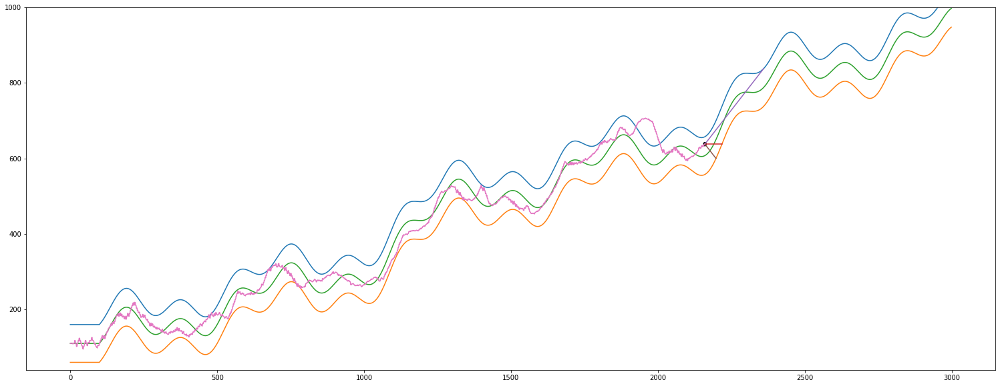

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2160
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2161, 3)
y.shape =  (2161, 1)
i       =  2160
---------------------
X.max =  400
X.min =  1
y.max =  117.003112150937
y.min =  -54.465209698709714
---------------------
X_scaled.max =  1.0
X_scaled.min =  -0.9999999999999999
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 717, loss = 0.01859904
Validation score: 0.696513
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------

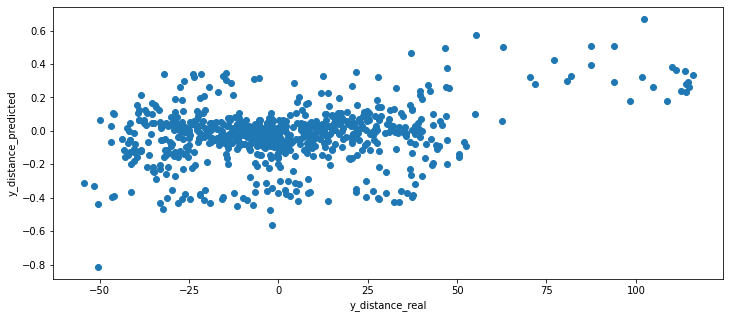

(2177, 1)
(2177, 1)


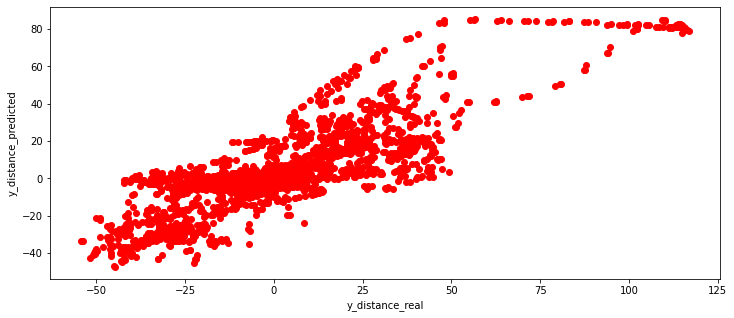

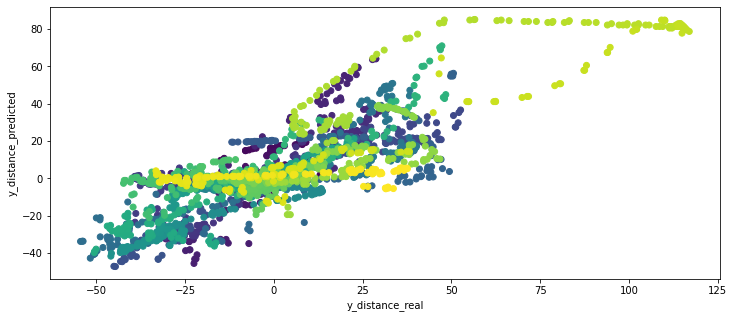

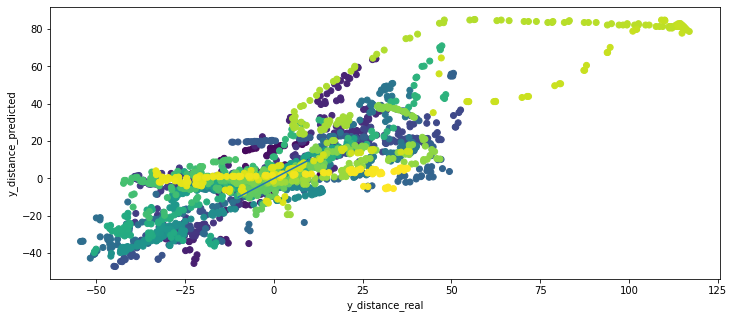

 --- plot predcition --- 


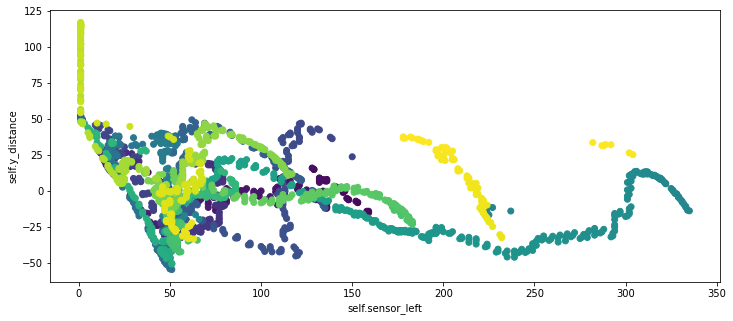

Streaming output truncated to the last 5000 lines.
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2220
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2221, 3)
y.shape =  (2221, 1)
i       =  2220
---------------------
X.max =  400
X.min =  1
y.max =  117.003112150937
y.min =  -54.465209698709714
---------------------
X_scaled.max =  1.0
X_scaled.min =  -0.9999999999999999
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 737, loss = 0.01976983
Validation score: 0.687244
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------

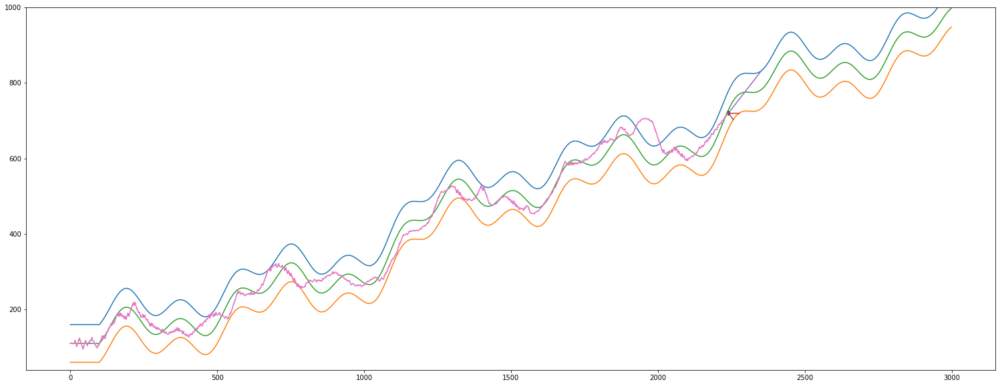

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  2252
			 len(self.sensor_right)  =  2252
			 self.x                  =  2252
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2253
			 len(self.sensor_left)   =  2253
			 len(self.sensor_center) =  2253
			 len(self.sensor_right)  =  2253
			 self.x                  =  2252
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 2 ------------------------------
# i =  2252
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  104
Sensor from left wall =  97
Sensor from right wall =  19
most távolsagra van a felső faltól =  62.79445036450841
most távolsagra van az alsó faltól =  37.20554963549159
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2

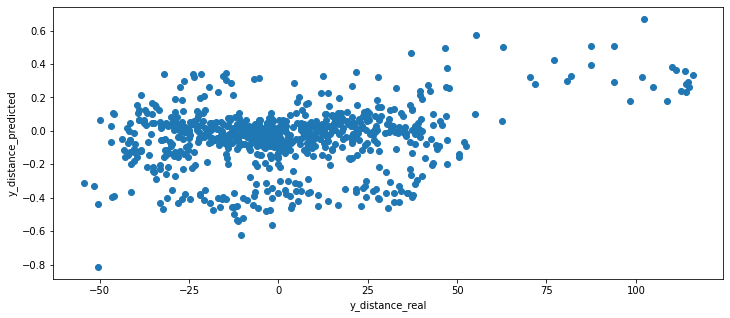

(2273, 1)
(2273, 1)


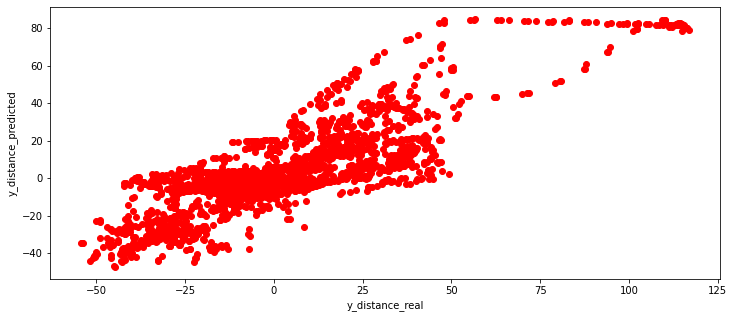

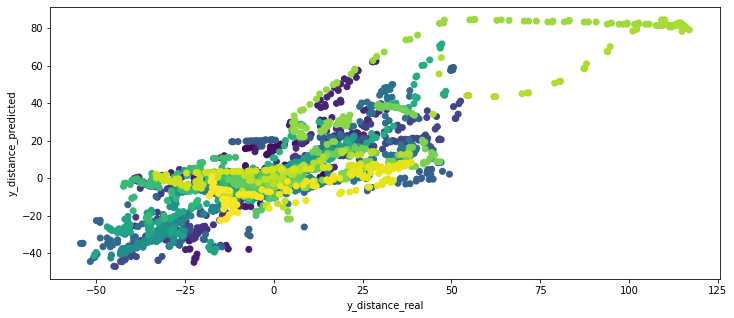

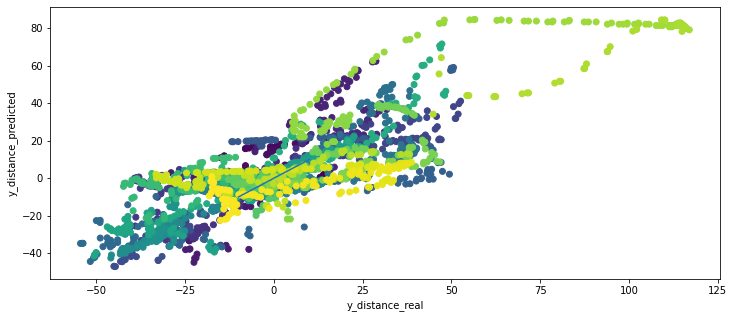

 --- plot predcition --- 


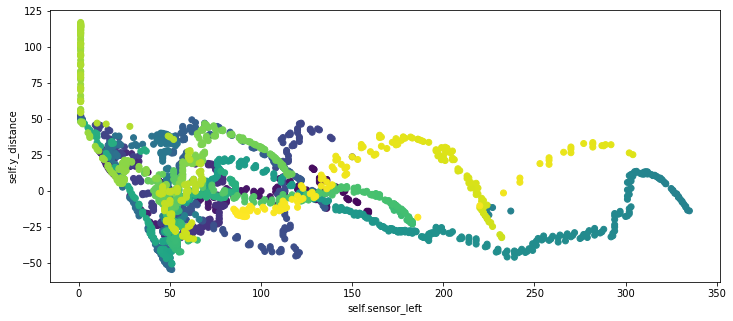

Streaming output truncated to the last 5000 lines.
most távolsagra van az alsó faltól =  29.276905967510743
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2299
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -20.723094032489257
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  -20.723094032489257
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2299
			 len(self.sensor_left)   =  2299
			 len(self.sensor_center) =  2299
			 len(self.sensor_right)  =  2299
			 self.x                  =  2299
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2300
			 len(self.sensor_left)   =  2300
			 len(self.sensor_center) =  2300
			 len(self.sensor_right)  =  2300
			 self.x  

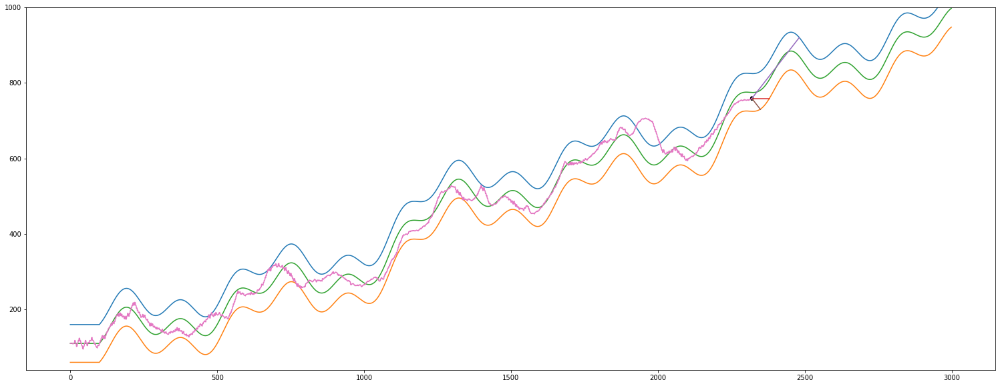

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_left)   =  2349
			 len(self.sensor_center) =  2349
			 len(self.sensor_right)  =  2349
			 self.x                  =  2348
			 -------------- Teszt End --------------
self.y =  766.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
766.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -------------------------------------------------------------------------------------------------------

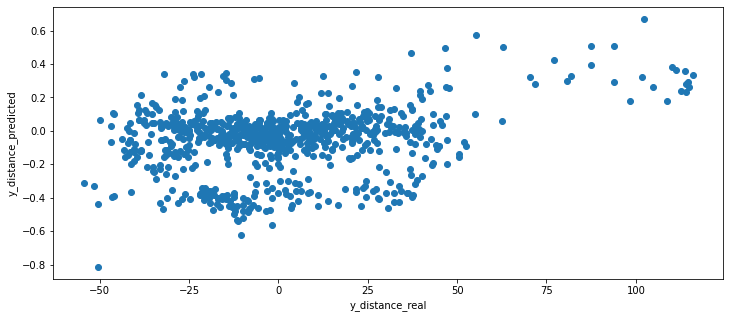

(2369, 1)
(2369, 1)


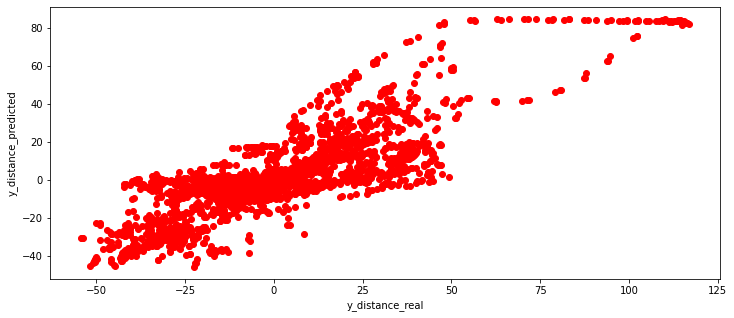

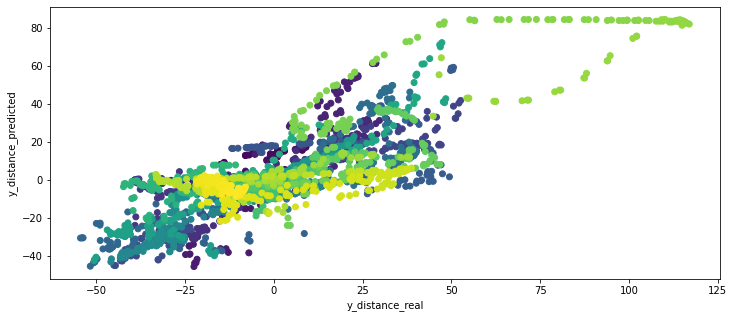

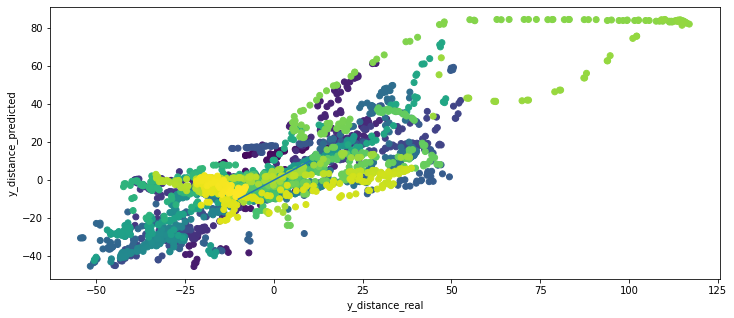

 --- plot predcition --- 


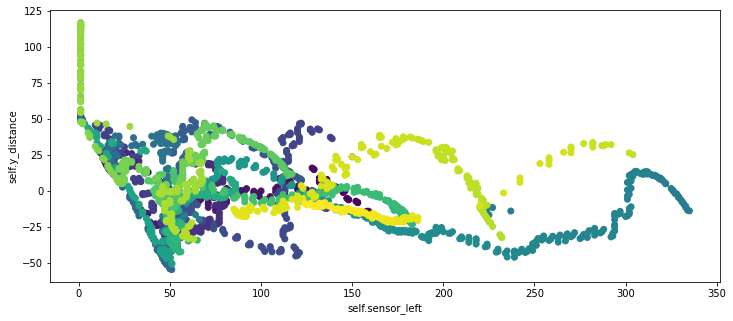

Streaming output truncated to the last 5000 lines.
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[114  -6]]
		 _X_center =  [[28 -6]]
		 _X_right  =  [[17 -6]]
		 predicted_left   =  [[123.61639181]]
		 predicted_center =  [[35.66558434]]
		 predicted_right  =  [[5.72563776]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.98374876 -1.91150545]]
		 regression_center.coef_ =  [[ 0.98057302 -1.36825665]]
		 regression_right.coef_  =  [[0.96902126 1.79128728]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[123.61639181  35.66558434   5.72563776]]
		 -------------------------X_scaled------------------
		  [[-0.26577011 -0.82623767 -0.93200521]]
		 ---------------Brutálisan hül

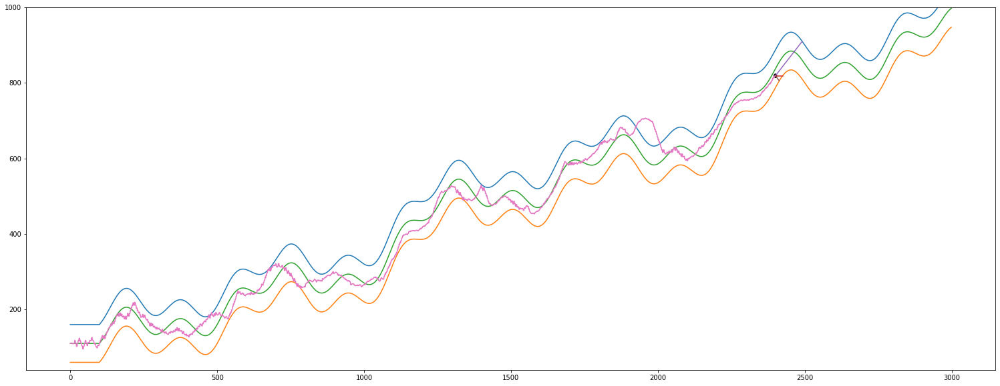

Streaming output truncated to the last 5000 lines.
		 _X_right  =  [[126   7]]
		 predicted_left   =  [[21.41045881]]
		 predicted_center =  [[57.8804555]]
		 predicted_right  =  [[134.69008438]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.98407715 -1.86174879]]
		 regression_center.coef_ =  [[ 0.97928123 -1.24438113]]
		 regression_right.coef_  =  [[0.96963799 1.78795682]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 21.41045881  57.8804555  134.69008438]]
		 -------------------------X_scaled------------------
		  [[-0.87778168 -0.71488493  0.92359834]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model         

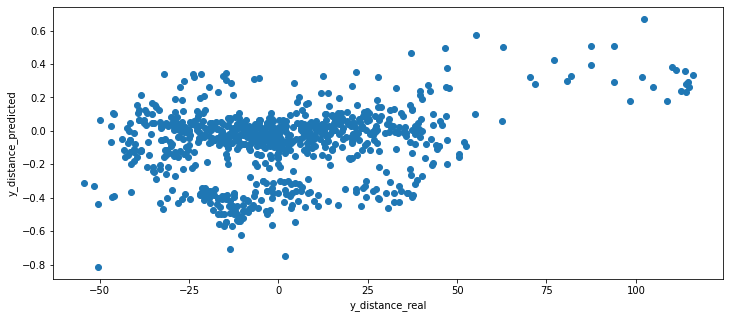

(2465, 1)
(2465, 1)


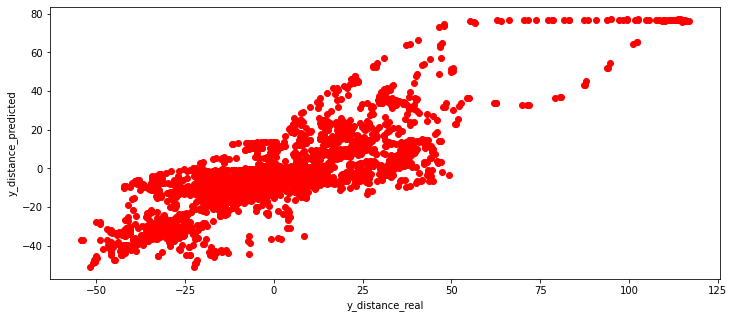

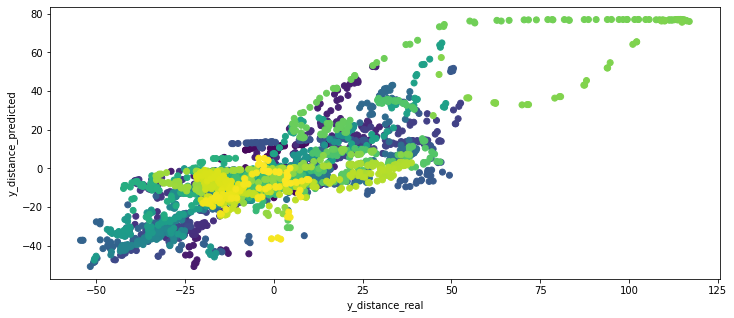

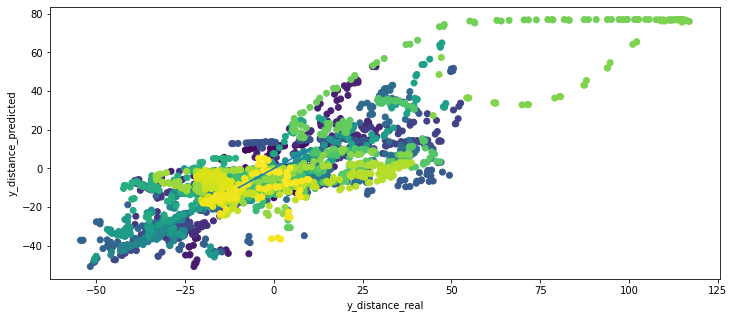

 --- plot predcition --- 


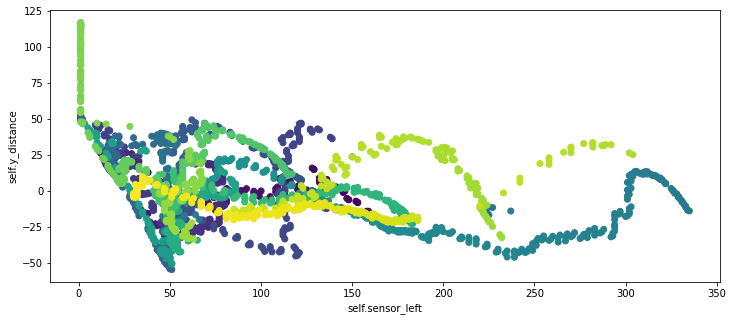

len(self.sensor_left) =  2465
len(self.y_distance) =  2465
(2465, 1)
(2465, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
878.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  56
Sensor from left wall =  30
Sensor from right wall =  110
most távolsagra van a felső faltól =  53.85414050193856
most tá

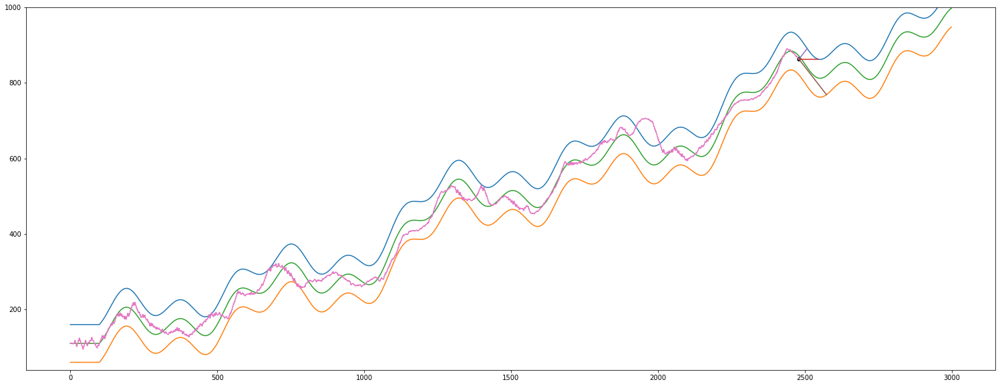

Streaming output truncated to the last 5000 lines.
		 ---------------------
		  action =  4
		  predicted_position =  [[2.31919243]]
		  absolute distance from 0 (tmp) =  [[2.31919243]]
		 ---------------------
		 adott j-re 4 kiszámoltuk az előrejelzést de még nem hoztunk döntést -----------------------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  5
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[53  5]]
		 _X_center =  [[250   5]]
		 _X_right  =  [[51  5]]
		 predicted_left   =  [[42.95718851]]
		 predicted_center =  [[236.85883516]]
		 predicted_right  =  [[58.38303125]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coe

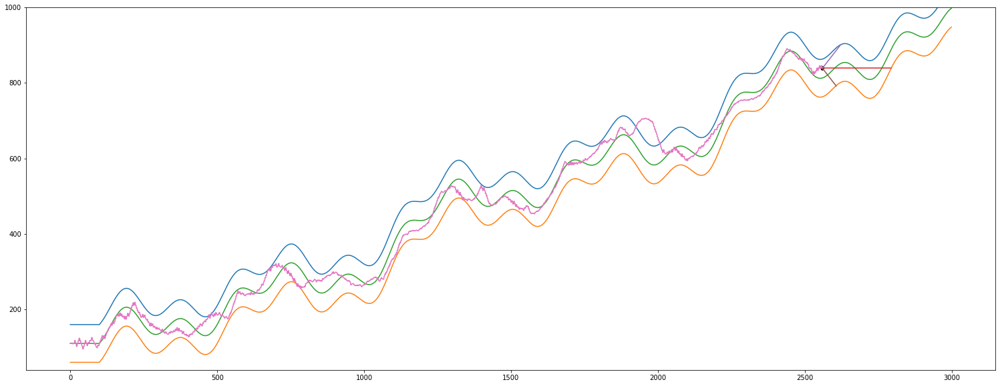

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2560
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 63 235  48]]
actual predicted =  [-0.16090496]
actual self.y_distance[-1] =  25.75049256363434
len(self.y_distance_real)      =  847
len(self.y_distance_predicted) =  847


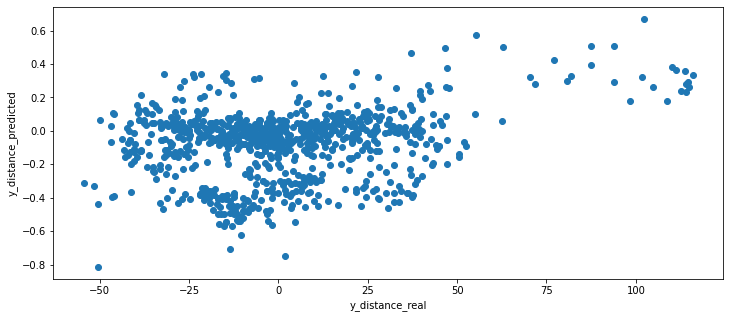

(2561, 1)
(2561, 1)


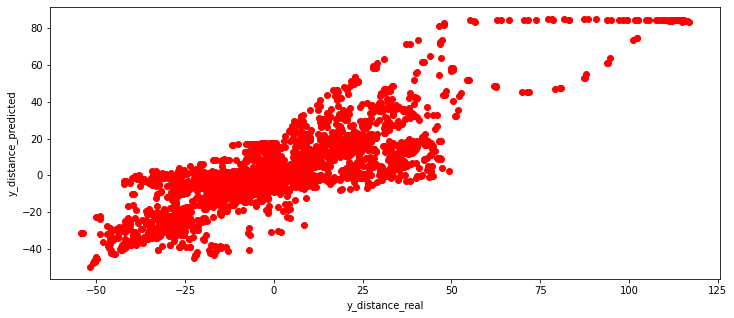

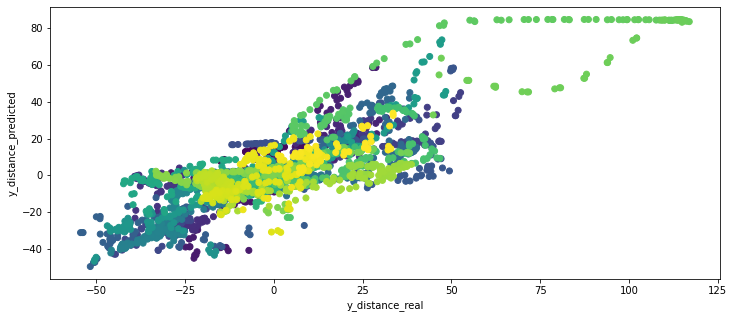

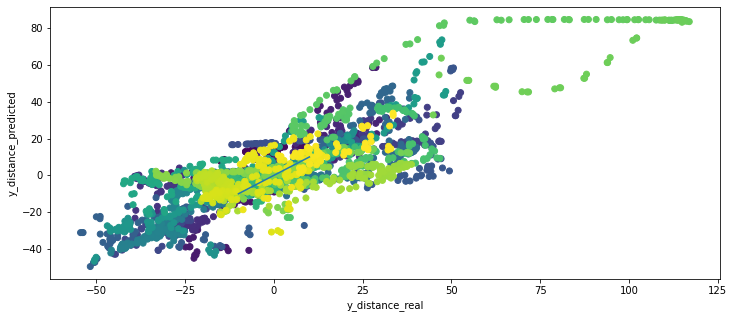

 --- plot predcition --- 


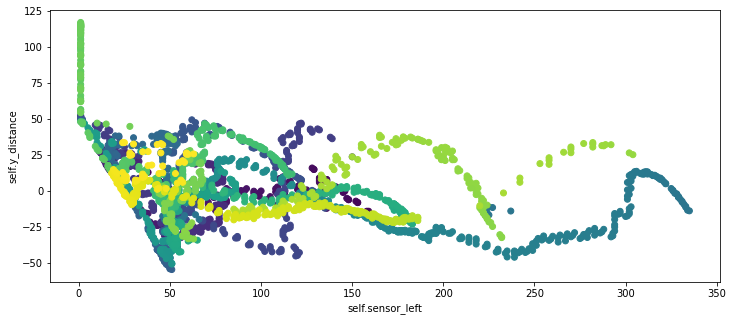

Streaming output truncated to the last 5000 lines.
len(self.y_distance_predicted) =  866
(2618, 1)
(2618, 1)
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
874.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  72
Sensor from left wall =  29
Sensor from right wall =  114
most távolsagra van a felső faltó

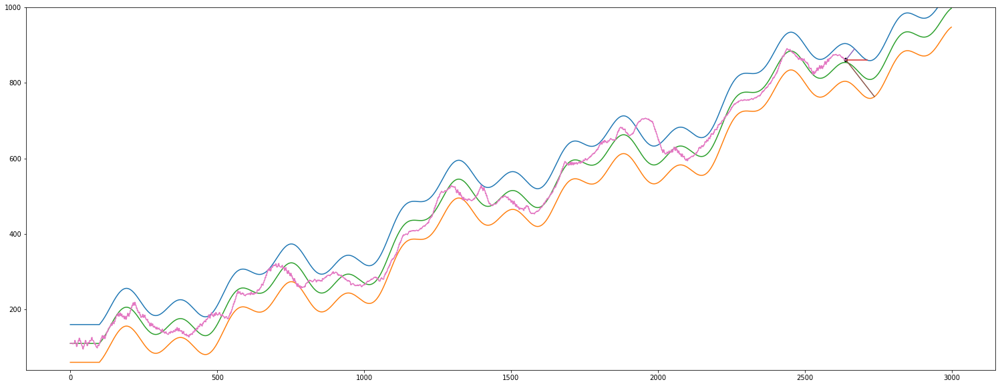

 --- plot --- 
 --- plot has been saved --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2640
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2641, 3)
y.shape =  (2641, 1)
i       =  2640
---------------------
X.max =  400
X.min =  1
y.max =  117.003112150937
y.min =  -54.465209698709714
---------------------
X_scaled.max =  1.0
X_scaled.min =  -0.9999999999999999
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 877, loss = 0.01849037
Validation score: 0.738291
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------

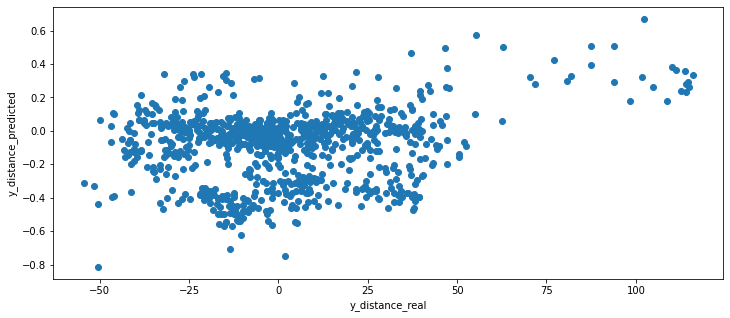

(2657, 1)
(2657, 1)


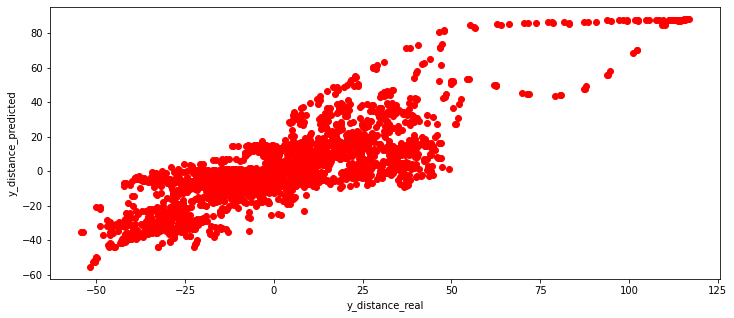

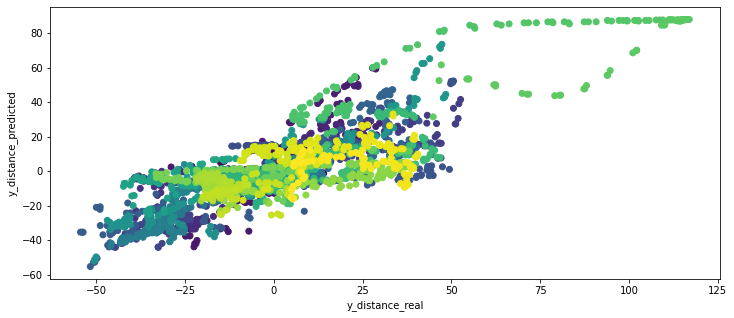

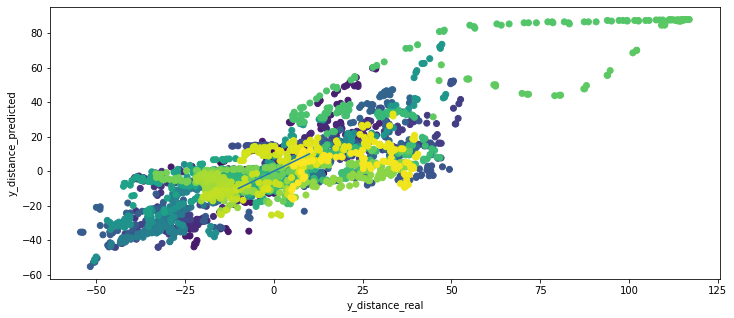

 --- plot predcition --- 


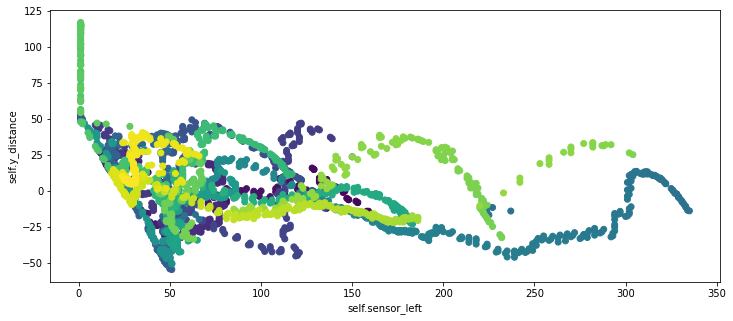

Streaming output truncated to the last 5000 lines.
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2698
			 len(self.sensor_left)   =  2698
			 len(self.sensor_center) =  2698
			 len(self.sensor_right)  =  2698
			 self.x                  =  2698
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2699
			 len(self.sensor_left)   =  2699
			 len(self.sensor_center) =  2699
			 len(self.sensor_right)  =  2699
			 self.x                  =  2698
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2698
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[179  73  39]]
actual predicted =  [-0.26811308]
actual self.y_distance[-1] =  -16.974216105483833
len(self.y_distance_real)      =  

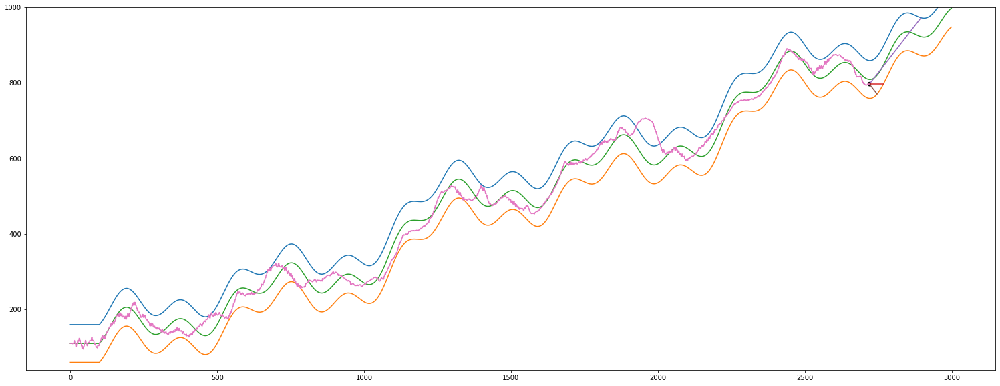

Streaming output truncated to the last 5000 lines.
self.vertical_distance_from_middle =  -7.167386777685351
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a középértéktől való eltérés mértéke =  -7.167386777685351
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2733
			 len(self.sensor_left)   =  2733
			 len(self.sensor_center) =  2733
			 len(self.sensor_right)  =  2733
			 self.x                  =  2732
			 -------------- Teszt End --------------
self.y =  804.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
804.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# 

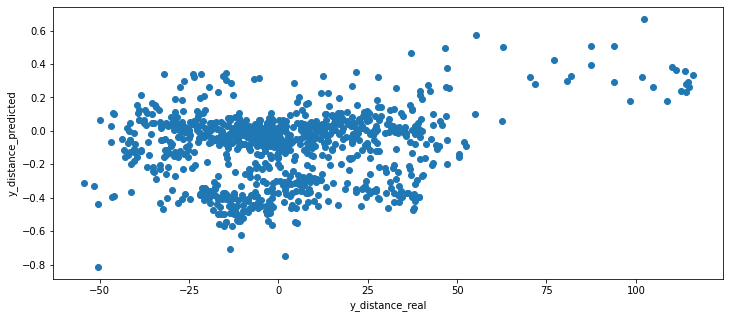

(2753, 1)
(2753, 1)


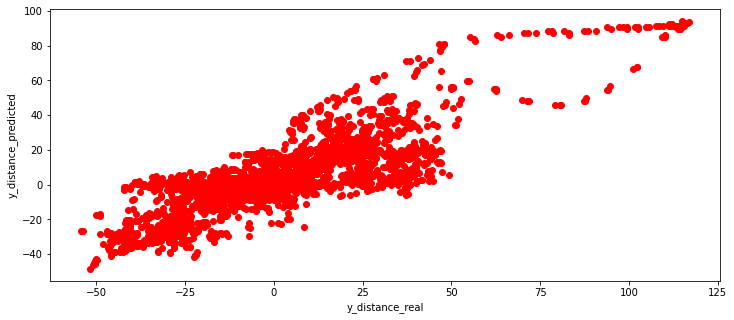

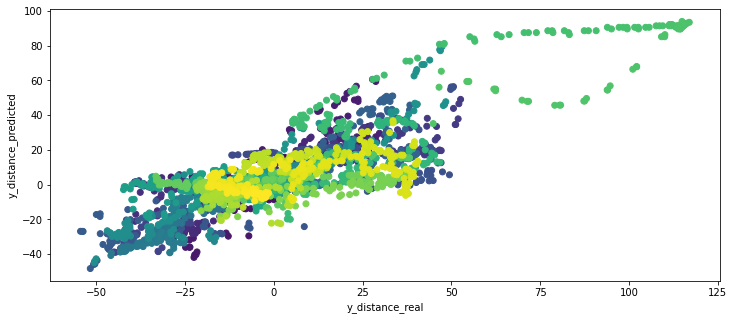

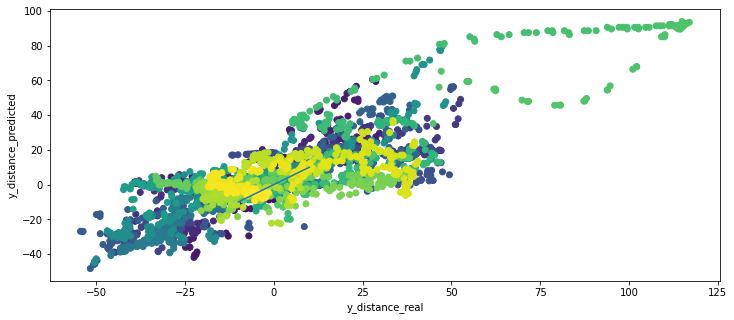

 --- plot predcition --- 


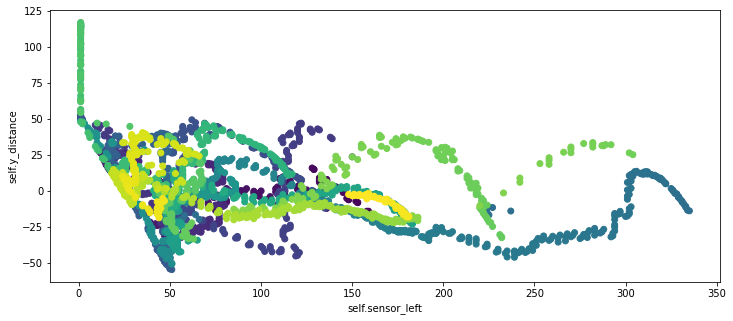

Streaming output truncated to the last 5000 lines.
			 self.x                  =  2781
			 -------------- Append End --------------
 --- plot has been saved --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2781
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2782, 3)
y.shape =  (2782, 1)
i       =  2781
---------------------
X.max =  400
X.min =  1
y.max =  117.003112150937
y.min =  -54.465209698709714
---------------------
X_scaled.max =  1.0
X_scaled.min =  -0.9999999999999999
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
Iteration 924, loss = 0.01667494
Validation score: 0.690567
------------------------------ IF len(self.before) > 9 ------------------------------


  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning -----------------------------

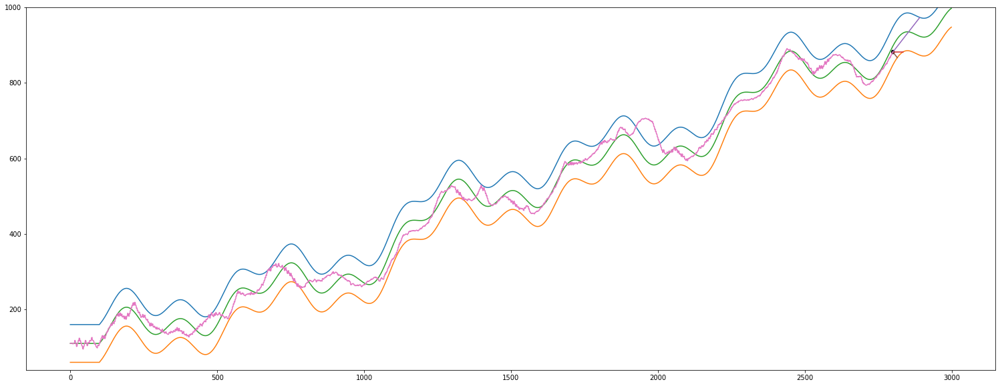

Streaming output truncated to the last 5000 lines.
		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  7
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[56  7]]
		 _X_center =  [[146   7]]
		 _X_right  =  [[41  7]]
		 predicted_left   =  [[42.53261823]]
		 predicted_center =  [[132.53066126]]
		 predicted_right  =  [[51.57051502]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.98521424 -1.80562557]]
		 regression_center.coef_ =  [[ 0.97911951 -1.48868382]]
		 regression_right.coef_  =  [[0.97768672 1.64076566]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 42.53261823 132.53066126  51.57051502]]
		 ----------------------

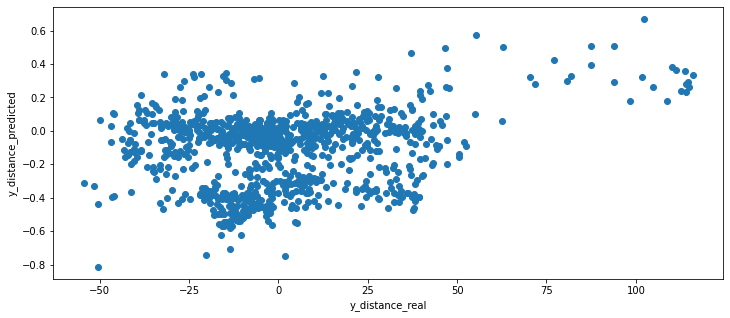

(2849, 1)
(2849, 1)


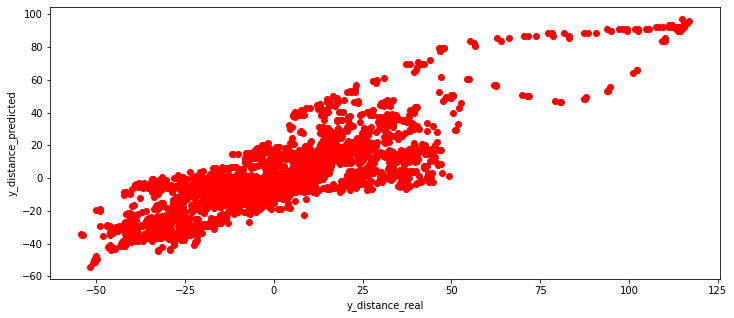

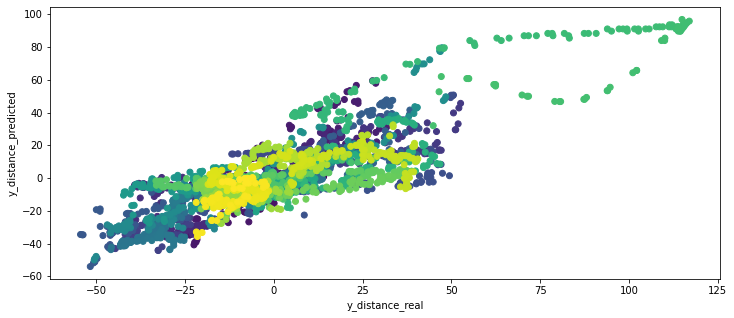

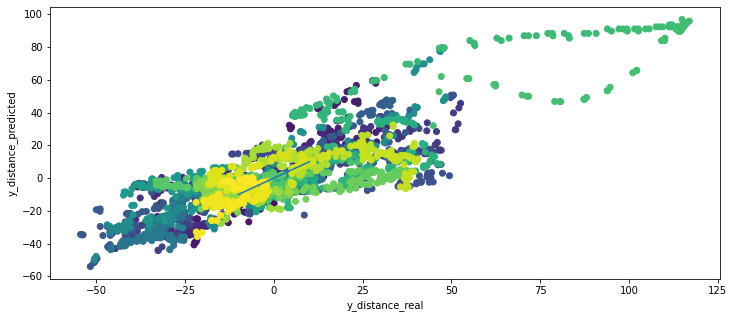

 --- plot predcition --- 


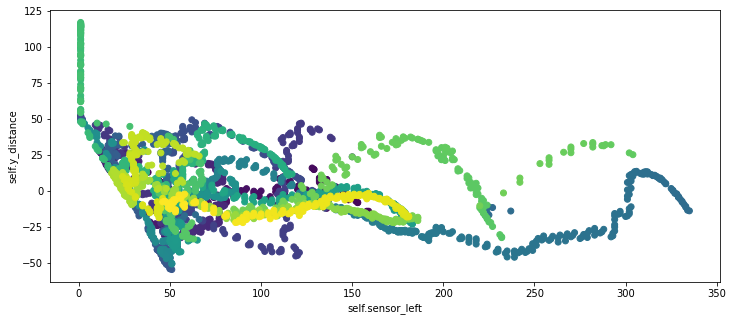

Streaming output truncated to the last 5000 lines.

		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  5
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[46  5]]
		 _X_center =  [[127   5]]
		 _X_right  =  [[57  5]]
		 predicted_left   =  [[36.33584455]]
		 predicted_center =  [[117.01786946]]
		 predicted_right  =  [[63.92762548]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.98519645 -1.79663845]]
		 regression_center.coef_ =  [[ 0.97925106 -1.46940301]]
		 regression_right.coef_  =  [[0.97781437 1.63844123]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 36.33584455 117.01786946  63.92762548]]
		 ---------------------

IndexError: ignored

In [ ]:
auto.run()

# Save to anigif

In [ ]:
from PIL import Image
import glob

rate = 10

In [ ]:
# Create the frames
frames = []
imgs = glob.glob("hist*.png")
imgs.sort()
s = len(imgs)-1
imgs = imgs[0:s]
t = s/rate
print('len(imgs) = ', len(imgs))
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('ani_history.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=int(t), loop=0)

In [ ]:
# Create the frames
frames = []
imgs = glob.glob("sensor_left*.png")
imgs.sort()
s = len(imgs)-1
imgs = imgs[0:s]
t = s/rate
print('len(imgs) = ', len(imgs))
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('ani_sensor_left.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=int(t), loop=0)

In [ ]:
# Create the frames
frames = []
imgs = glob.glob("y_distance_vs_y_distance_predicted_0*.png")
imgs.sort()
s = len(imgs)-1
imgs = imgs[0:s]
t = s/rate
print('len(imgs) = ', len(imgs))
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('ani_y_distance.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=int(t), loop=0)

In [ ]:
# Create the frames
frames = []
imgs = glob.glob("y_distance_vs_y_distance_predicted_all_0*.png")
imgs.sort()
s = len(imgs)-1
imgs = imgs[0:s]
t = s/rate
print('len(imgs) = ', len(imgs))
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('ani_y_distance_all.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=int(t), loop=0)

In [ ]:
# Create the frames
frames = []
imgs = glob.glob("y_distance_vs_y_distance_predicted_all_color_0*.png")
imgs.sort()
s = len(imgs)-1
imgs = imgs[0:s]
t = s/rate
print('len(imgs) = ', len(imgs))
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('ani_y_distance_all_color.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=int(t), loop=0)


In [ ]:
# Create the frames
frames = []
imgs = glob.glob("y_distance_vs_y_distance_predicted_all_color_line_0*.png")
imgs.sort()
s = len(imgs)-1
imgs = imgs[0:s]
t = s/rate
print('len(imgs) = ', len(imgs))
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)

# Save into a GIF file that loops forever
frames[0].save('ani_y_distance_all_color_line.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=int(t), loop=0)

In [ ]:
 4 + 4

<a name="irodalom"></a>

# Felhasznált irodalom és internetes cimek

Itt gyűjtöttem össze a menet közben összegyűjt okosságokat

[vissza a tartalomhoz](#tartalom)<br>

Scikit-learn - MLPRegressor API
<br>
https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html


Fogalmak és probléma meghatározás
<br>
https://www.rubrik.com/blog/architecture/20/12/customized-autoscaling--minimize-your-cloud-cost


https://github.com/kubernetes/autoscaler/blob/master/cluster-autoscaler/FAQ.md#what-are-the-parameters-to-ca

https://arxiv.org/pdf/1608.04030.pdf

Metrikák amivel a szollgáltatás minőségét mérik különböző esetekben
<br>
https://blog.avinetworks.com/autoscaling-metrics

------------

NumPy API Reference Guide
<br>
https://numpy.org/doc/stable/reference/random/generated/numpy.random.normal.html


Seaborn API Reference Guide
<br>
https://seaborn.pydata.org/examples/pair_grid_with_kde.html




------------

Scikit learn API Warm_start and Partial_fit
<br>
https://newbedev.com/what-is-the-difference-between-partial-fit-and-warm-start


Online learning
<br>
https://www.dummies.com/programming/big-data/data-science/tips-for-dealing-with-big-data-in-python/